In [1]:
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from matplotlib import colors
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
plt.rcParams['figure.dpi'] = 150

In [2]:
p2AUC_dict_simic = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_hepa_monoc_states_all_target'
p2AUC_dict_no_simic = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_9state_1122_no_simic'

In [3]:
p2assignment = '/data/jianhao/hepatocyte_update_dataset_101619/monoc_assignment.txt'
assign_list = []
with open(p2assignment, 'r') as f:
    for line in f:
        assign_list.append(int(line))
print(len(assign_list))
print(set(assign_list))

18272
{1, 2, 3, 4, 5, 6, 7, 8, 9}


------
# Compute histogram of AUC for all TFs

In [4]:
def separate_state(AUC_dict):
    for state in AUC_dict.keys():
        tmp_AUC = AUC_dict[state]
        tmp_AUC = tmp_AUC.iloc[[idx for idx, label in enumerate(assign_list) if label == state]]
        AUC_dict[state] = tmp_AUC
    return AUC_dict

In [5]:
def compute_hist(AUC_dict, num_TF = 200):
    x_min = np.ones(num_TF)
    x_max = -1 * np.ones(num_TF)
    # find min and max of AUC values in all states.
    for label in AUC_dict:
        min_AUC = AUC_dict[label].min(axis = 0)
        max_AUC = AUC_dict[label].max(axis = 0)
        x_min = np.minimum(min_AUC, x_min)
        x_max = np.maximum(max_AUC, x_max)

    i = 5
    TF_hist_dict = {}
    for idx, TF in enumerate(AUC_dict[1].columns):    
    #     i -= 1
        cap_TF = TF.capitalize()
        TF_hist_dict[cap_TF] = {}
        nbins = 50
        bar_width =  (-x_min[idx] + x_max[idx]) / nbins
        bin_list = np.arange(x_min[idx], x_max[idx] + bar_width, bar_width)


        label_order = sorted(list(AUC_dict.keys()))

        for label in label_order:
            AUC_df = AUC_dict[label]      
            y = AUC_df[TF].values.tolist()

            hist, _ = np.histogram(y, bins = bin_list,
                                  weights=np.ones(len(y)) / len(y))

            xs = (bin_list[:-1] + bin_list[1:])/2
            legend_name = 'state {}'.format(label)

            TF_hist_dict[cap_TF][label] = {
                'hist': hist,
                'xs': xs
            }
        if i < 0:
            break
    return TF_hist_dict

def compute_hist_mat(TF_hist_dict):
    TF_hist_mat_dict = {}
    num_of_TF = len(TF_hist_dict)
    for TF in TF_hist_dict:
        num_of_bins = len(TF_hist_dict[TF][1]['hist'])
        num_of_labels = len(TF_hist_dict[TF])
        tmp_hist_mat = np.zeros((num_of_labels, num_of_bins))
        for row_idx, label in enumerate(TF_hist_dict[TF]):
            tmp_row = TF_hist_dict[TF][label]['hist']
            tmp_hist_mat[row_idx, :] = tmp_row
        TF_hist_mat_dict[TF] = tmp_hist_mat
    return TF_hist_mat_dict
        
def get_hist_mat_dict(p2AUC_dict, num_TF = 200):
    with open(p2AUC_dict, 'rb') as f:
        AUC_dict = pickle.load(f)
    AUC_dict = separate_state(AUC_dict)
    TF_hist_dict = compute_hist(AUC_dict, num_TF)
    TF_hist_mat_dict = compute_hist_mat(TF_hist_dict)
    return TF_hist_mat_dict, TF_hist_dict

In [6]:
TF_hist_mat_dict_simic, TF_hist_dict_simic = get_hist_mat_dict(p2AUC_dict_simic)
TF_hist_mat_dict_no_simic, TF_hist_dict_no_simic = get_hist_mat_dict(p2AUC_dict_no_simic)
len(TF_hist_mat_dict_simic)

200

In [7]:
# TF_hist_dict_simic
# TF_hist_mat_dict_simic

------
# Compute the total variant of histograms

In [8]:
def total_variant(dist1, dist2):
    abs_diff = np.abs(np.array(dist1) - np.array(dist2))
    TV = 1/2 * np.sum(abs_diff)
    return TV

def aver_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    sum_of_TVs = 0
    for row_idx in range(num_labels):
        remaining_rows = np.delete(np.arange(num_labels), row_idx)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            sum_of_TVs += total_variant(row_1, row_2)
    average_TV = sum_of_TVs / count_of_TVs
    return average_TV
    
def list_of_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    list_of_TVs = []
    for row_idx in range(num_labels):
        remaining_rows = range(row_idx + 1, num_labels)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            tmp_TV = total_variant(row_1, row_2)
            list_of_TVs.append(tmp_TV)
    return list_of_TVs

def minmax_variant_of_hist(hist_mat):
    max_hist = np.max(hist_mat, axis = 0)
    min_hist = np.min(hist_mat, axis = 0)
    minmax_diff = max_hist - min_hist
    variant = np.sum(np.abs(minmax_diff)) / hist_mat.shape[0]
    
    return variant

In [9]:
def get_divergence_df(TF_hist_mat_dict):
    hist_divergence_df = pd.DataFrame(columns = TF_hist_mat_dict.keys(), 
                                      index = ['average TV', 'median TV', 'max TV', 'minmax variant'])
    for TF in TF_hist_mat_dict.keys():
        tmp_hist_mat = TF_hist_mat_dict[TF]
        tf_aver_TV = aver_TV_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['average TV'] = tf_aver_TV

        TV_list = list_of_TV_of_hist(tmp_hist_mat)

        tf_median_TV = np.median(TV_list)
        hist_divergence_df[TF]['median TV'] = tf_median_TV

        tf_max_TV = np.max(TV_list)
        hist_divergence_df[TF]['max TV'] = tf_max_TV

        tf_minmax_variant = minmax_variant_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['minmax variant'] = tf_minmax_variant
    return hist_divergence_df

def get_TF_list_intersection(hist_divergence_df, k):
    sorted_by_ave_hist_divergence_df = hist_divergence_df.sort_values(by = 'average TV', axis = 1, ascending = False)
    sorted_by_med_hist_divergence_df = hist_divergence_df.sort_values(by = 'median TV', axis = 1, ascending = False)
    sorted_by_max_hist_divergence_df = hist_divergence_df.sort_values(by = 'max TV', axis = 1, ascending = False)
    sorted_by_minmax_var_divergence_df = hist_divergence_df.sort_values(by = 'minmax variant', axis = 1, ascending = False)
        
    top_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[:k]
    last_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[-k:]

    top_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[:k]
    last_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[-k:]

    top_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[:k]
    last_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[-k:]

    top_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[:k]
    last_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[-k:]

    top_d = (top_k_minmax_TF, top_k_max_TF, top_k_median_TF, top_k_average_TF)
    top_variant_TF = set.intersection(*map(set,top_d))

    last_d = (last_k_minmax_TF, last_k_max_TF, last_k_median_TF, last_k_average_TF)
    last_variant_TF = set.intersection(*map(set, last_d))
    
    return top_variant_TF, last_variant_TF

------
# Get TF list

In [10]:
k = 50

diver_df_simic = get_divergence_df(TF_hist_mat_dict_simic)
top_TF_simic, last_TF_simic = get_TF_list_intersection(diver_df_simic, k)

diver_df_no_simic = get_divergence_df(TF_hist_mat_dict_no_simic)
top_TF_no_simic, last_TF_no_simic = get_TF_list_intersection(diver_df_no_simic, k)

# find the common and difference among sets.
common_top = top_TF_simic.intersection(top_TF_no_simic)
common_last = last_TF_simic.intersection(last_TF_no_simic)

top_only_simic = top_TF_simic.difference(common_top)
top_only_no_simic = top_TF_no_simic.difference(common_top)

last_only_simic = last_TF_simic.difference(common_last)
last_only_no_simic = last_TF_no_simic.difference(common_last)

top_simic_last_no_simic = top_TF_simic.intersection(last_TF_no_simic)
last_simic_top_no_simic = last_TF_simic.intersection(top_TF_no_simic)

print('common top in simic and no-simic: ', len(common_top))
print(common_top)
print('- ' * 7)

print('common last in simic and no-simic: ', len(common_last))
print(common_last)
print('- ' * 7)

print()
print('>>' * 7, 'simic', '>>' * 7)
print('top only in simic: ', len(top_only_simic))
print(top_only_simic)
print('- ' * 7)

print('last only in simic: ', len(last_only_simic))
print(last_only_simic)
print('- ' * 7)

print()
print('>>' * 7, 'no-simic', '>>' * 7)
print('top only in no-simic: ', len(top_only_no_simic))
print(top_only_no_simic)
print('- ' * 7)

print('last only in no-simic: ', len(last_only_no_simic))
print(last_only_no_simic)
print('- ' * 7)

print()
print('>>' * 7, 'contradicting cases', '>>' * 7)
print('top in simic, but last in no-simic: ', len(top_simic_last_no_simic))
print(top_simic_last_no_simic)
print('- ' * 7)

print('last in simic, but top in no-simic: ', len(last_simic_top_no_simic))
print(last_simic_top_no_simic)
print('- ' * 7)

common top in simic and no-simic:  9
{'Ybx3', 'Nr0b2', 'Foxa3', 'Smarca5', 'Tcf25', 'Id1', 'Rxra', 'Sfpq', 'Srebf1'}
- - - - - - - 
common last in simic and no-simic:  2
{'Bcl6', 'Hsf2'}
- - - - - - - 

>>>>>>>>>>>>>> simic >>>>>>>>>>>>>>
top only in simic:  17
{'Ncor1', 'Epas1', 'Hes6', 'Mlx', 'Hnf4a', 'Dnmt1', 'Crem', 'Nfia', 'Nono', 'Foxq1', 'Phf5a', 'Id3', 'Prox1', 'Stat5b', 'Rela', 'Nr2f6', 'Hopx'}
- - - - - - - 
last only in simic:  12
{'Mier3', 'Ncoa2', 'Mxd4', 'Foxp1', 'Zfp637', 'Zbtb7b', 'Purb', 'Bhlhe40', 'Rcor1', 'Dnajc1', 'Cebpd', 'Nfkbia'}
- - - - - - - 

>>>>>>>>>>>>>> no-simic >>>>>>>>>>>>>>
top only in no-simic:  14
{'Rora', 'Onecut2', 'Peg3', 'Nr1h4', 'Nr1h3', 'Tfam', 'Irf9', 'Tfdp2', 'Junb', 'Gatad1', 'Hmg20b', 'Zfp91', 'Sox5', 'Smarce1'}
- - - - - - - 
last only in no-simic:  16
{'Cdc5l', 'Tbx3', 'Creb3l3', 'Rara', 'Atrx', 'Hhex', 'Ahr', 'Smad4', 'Thrb', 'Smarcc2', 'Cebpb', 'Phf5a', 'Csrnp1', 'Id3', 'Sp3', 'Jund'}
- - - - - - - 

>>>>>>>>>>>>>> contradicting cases >>

In [59]:
def plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, gene_list):
    plt.rcParams['figure.dpi'] = 150
    for _, TF in enumerate(gene_list):    
        fig = plt.figure(figsize=plt.figaspect(0.4))
        print(TF)
        for idx, TF_hist_dict in enumerate([TF_hist_dict_simic, TF_hist_dict_no_simic]):
            label_order = sorted(list(TF_hist_dict[TF].keys()))
            ax = fig.add_subplot(1, 2, idx + 1, projection='3d')
            
            x_left, x_right = 1, 0
            for label in label_order:
                xs = TF_hist_dict[TF][label]['xs']
                hist = TF_hist_dict[TF][label]['hist']
                nbins = len(xs)
                bar_width =  (xs[-1] - xs[0]) / nbins

                try:
                    ax.bar(xs, hist, zs = label, 
                           zdir = 'y',
                           width = bar_width,
                           alpha = 0.8,
                          )
                    ax.tick_params(axis='both', which='major', labelsize=12)
                    x_left = min(min(xs), x_left)
                    x_right = max(max(xs), x_right)
                except:
                    print('error in ax.bar')
                    continue

            
            ax.set_xlabel('wAUC', fontsize = 14)
            x_span = (np.linspace(x_left - bar_width, x_right + bar_width, 5) * 100 ).astype(int) / 100
            ax.set_xticks(x_span)
            ax.set_ylabel('cell states', fontsize = 14)
            ax.set_yticks(label_order)
            ax.set_zlabel('Proportion of Cells', fontsize = 14)
            if idx == 0:
                cond = 'simic'
            else:
                cond = 'no-simic'
#             ax.set_title('{}: Histogram of TF {}'.format(cond, TF.upper()))
        plt.tight_layout()
        plt.savefig('3_states_histogram/{}'.format(TF))
        plt.show()
        plt.close()
        


# TFs that are only rank top variant in simic

Ncor1


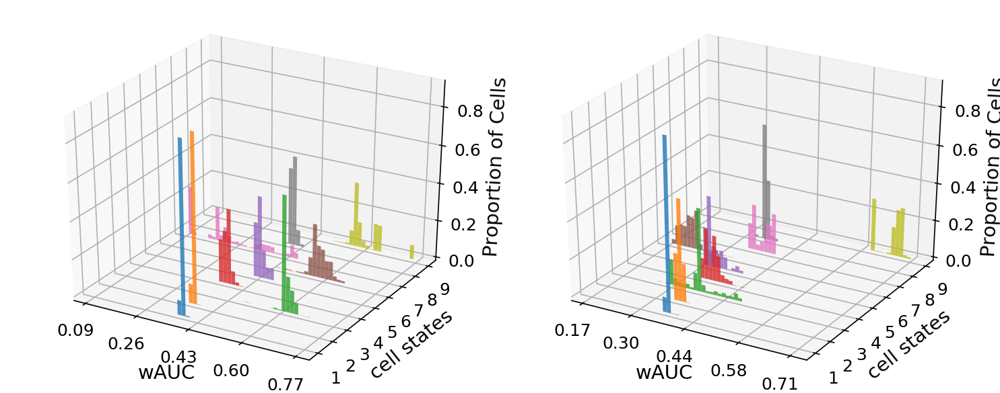

Epas1


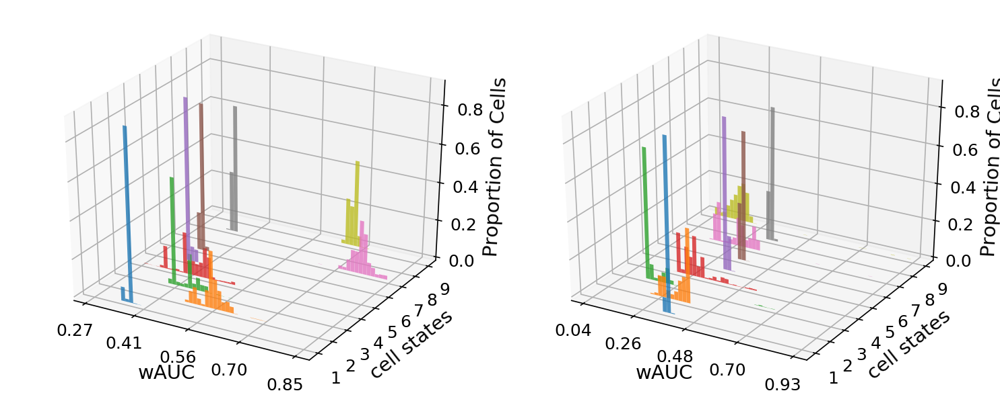

Hes6


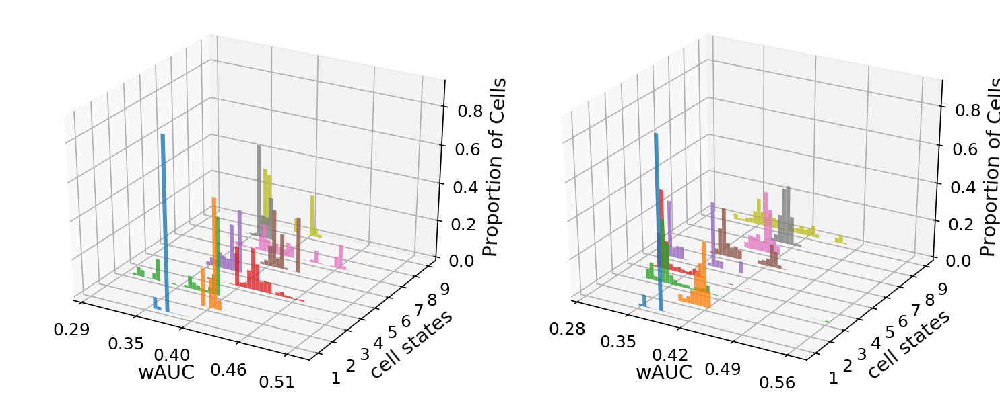

Mlx


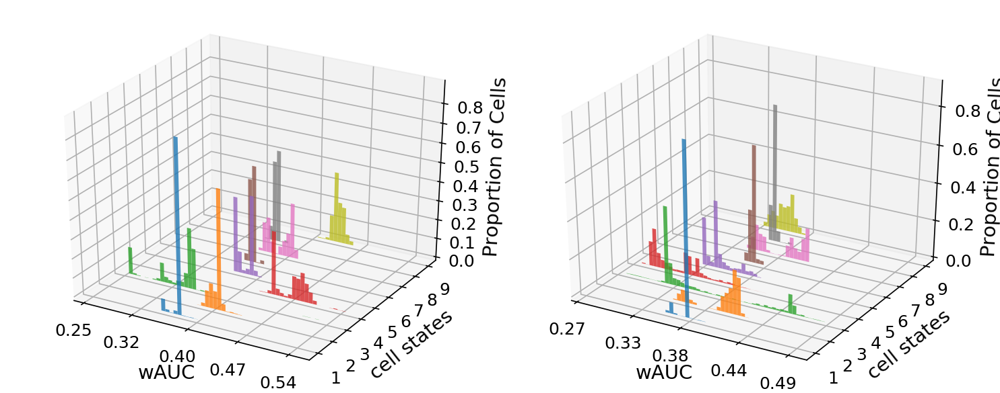

Hnf4a


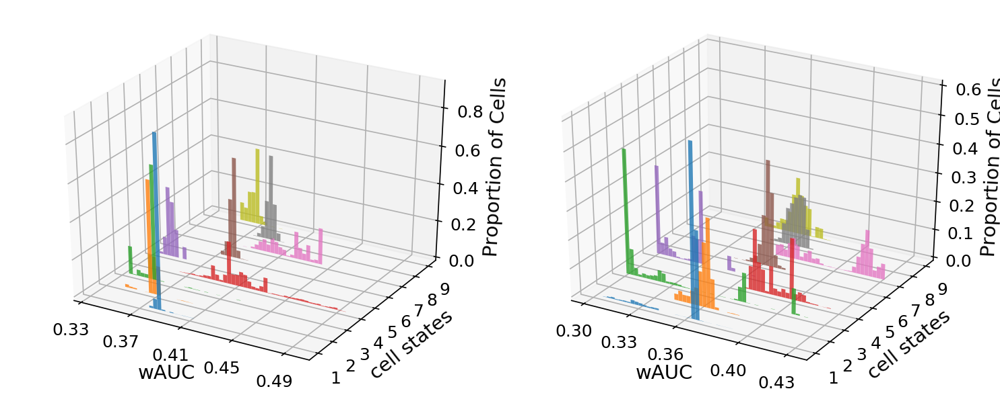

Dnmt1


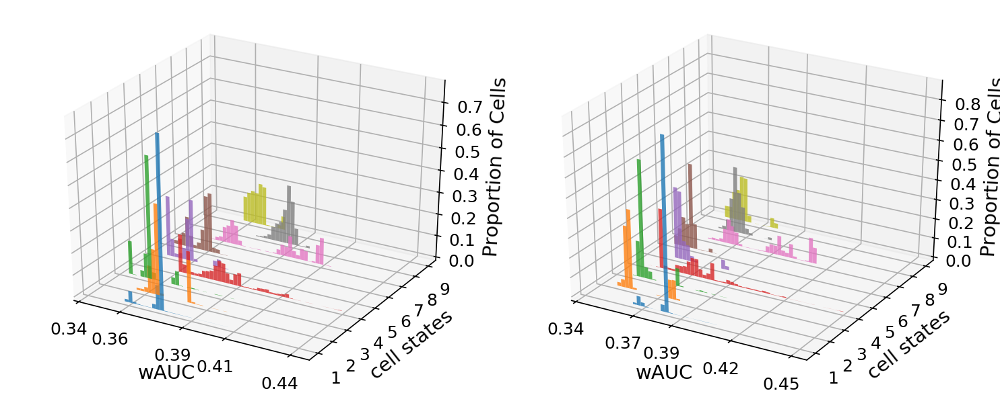

Crem


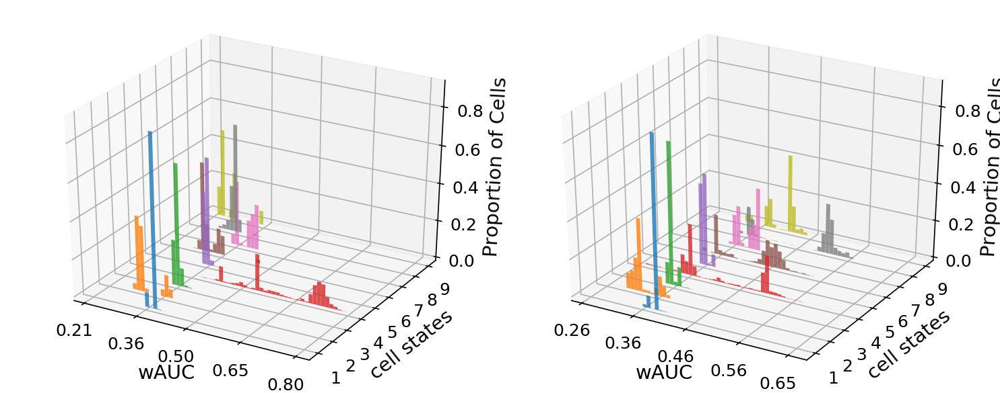

Nfia


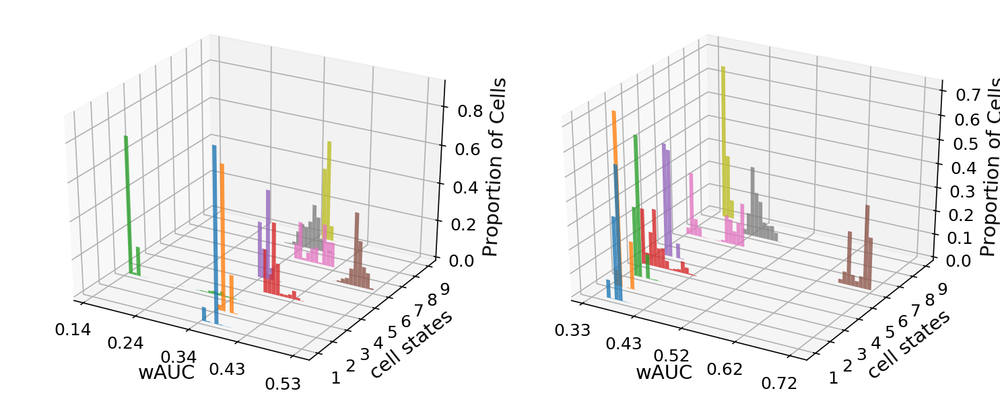

Nono


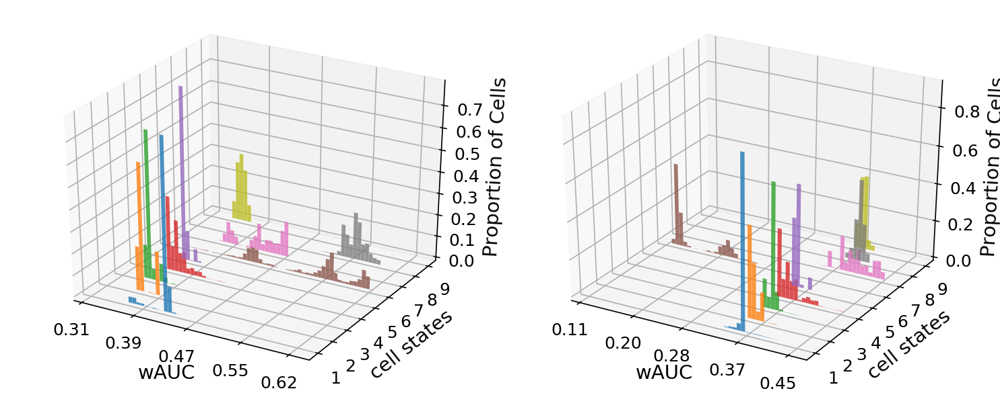

Foxq1


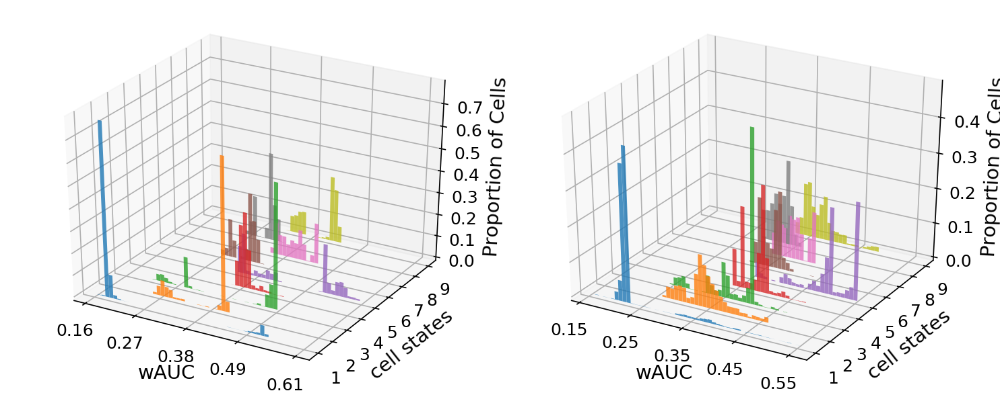

Phf5a


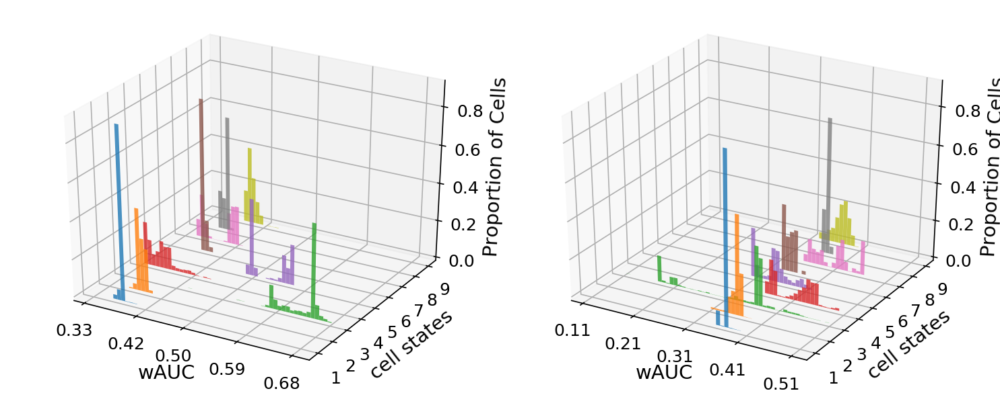

Id3


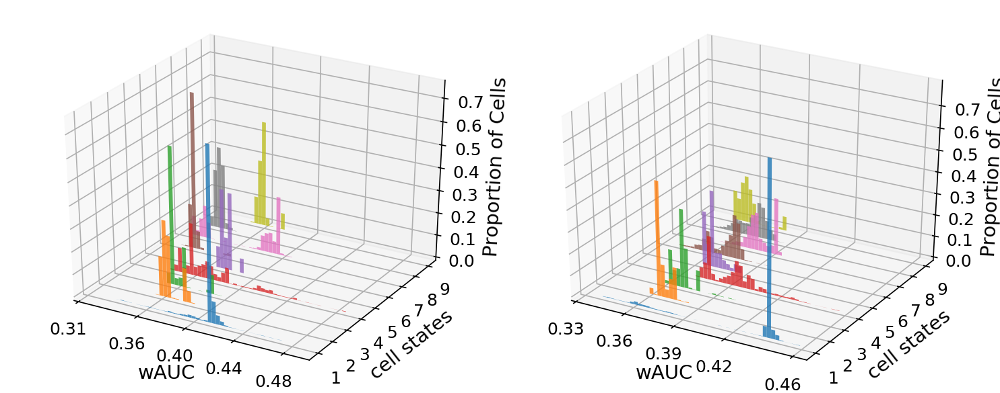

Prox1


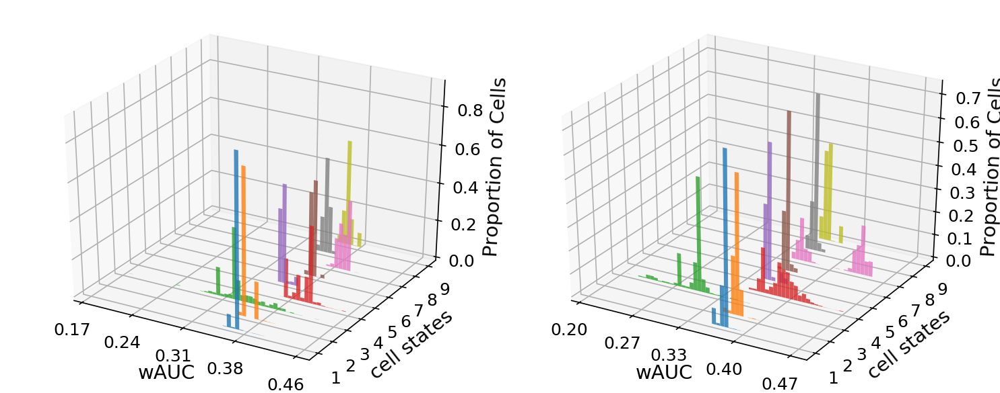

Stat5b


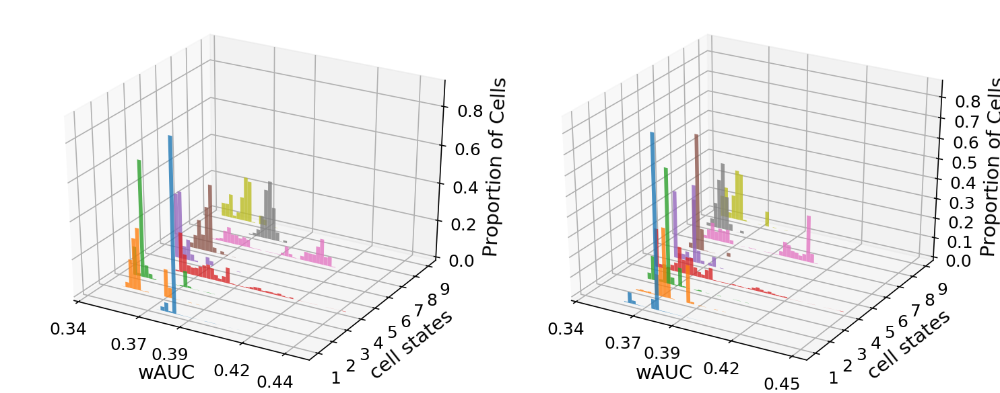

Rela


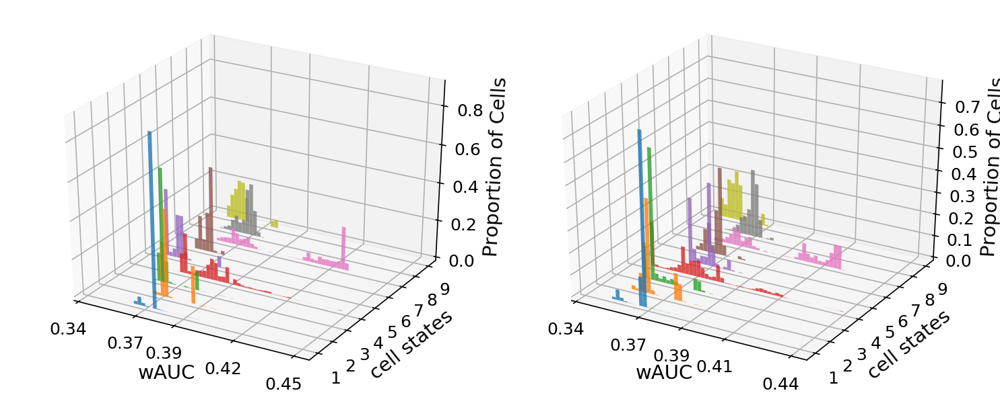

Nr2f6


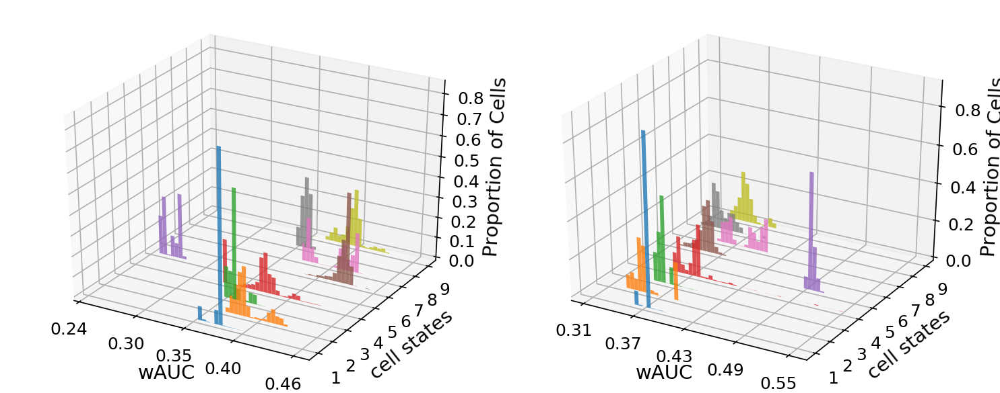

Hopx


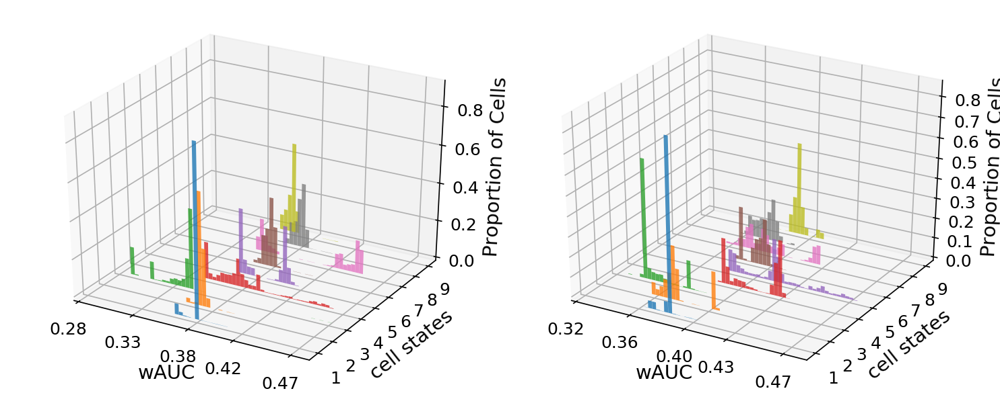

In [60]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_only_simic)

# TFs that are only rank top varint in no-simic

Rora


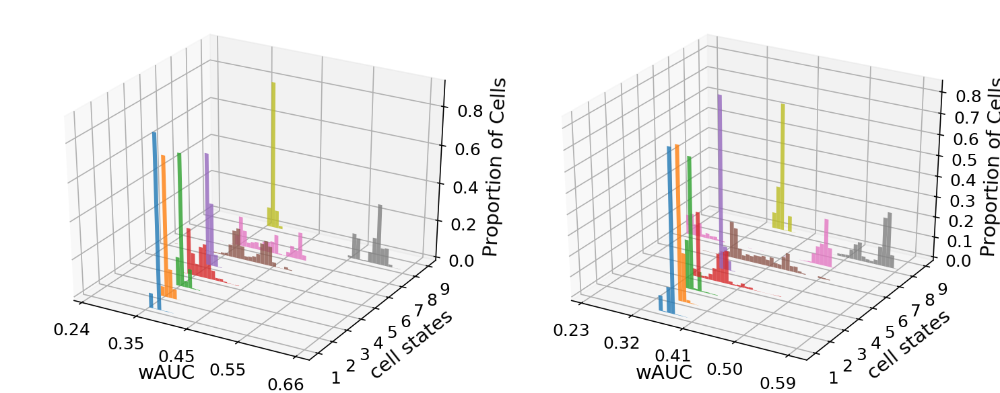

Onecut2


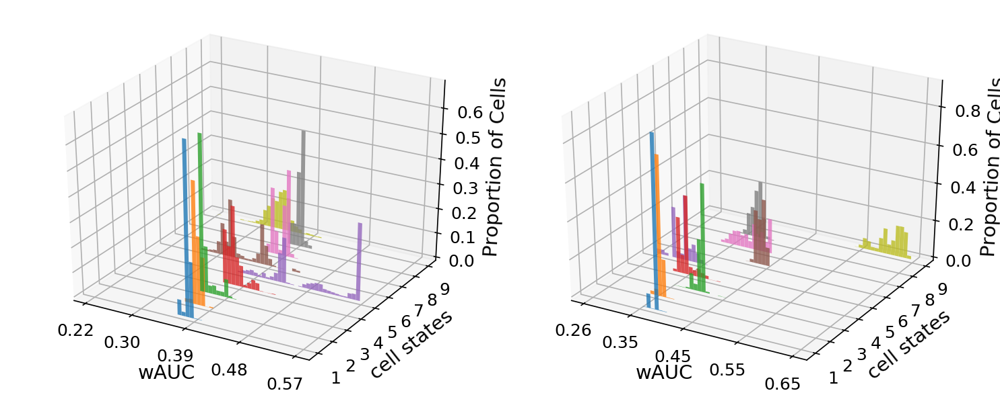

Peg3


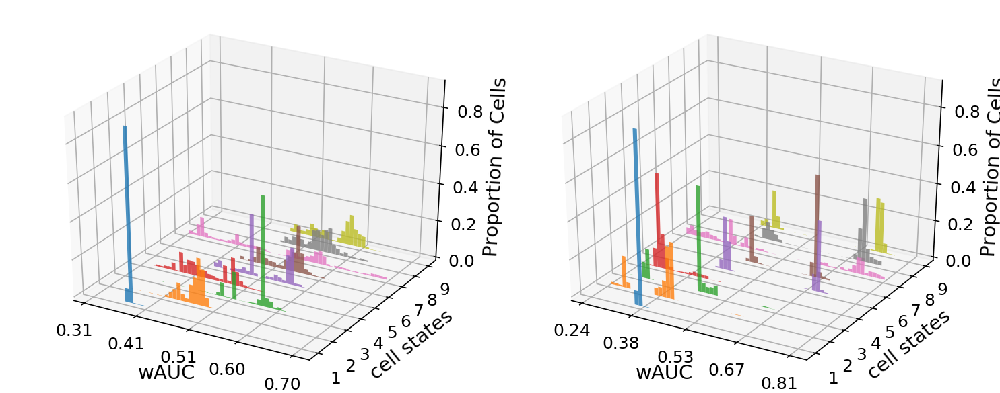

Nr1h4


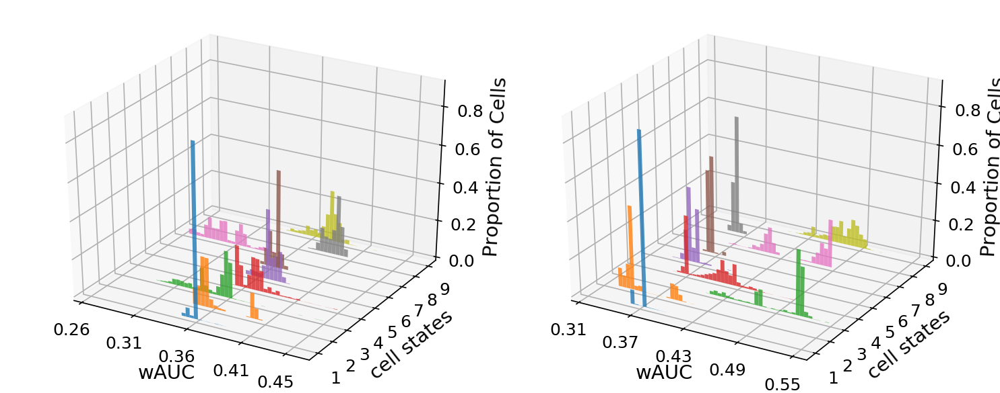

Nr1h3


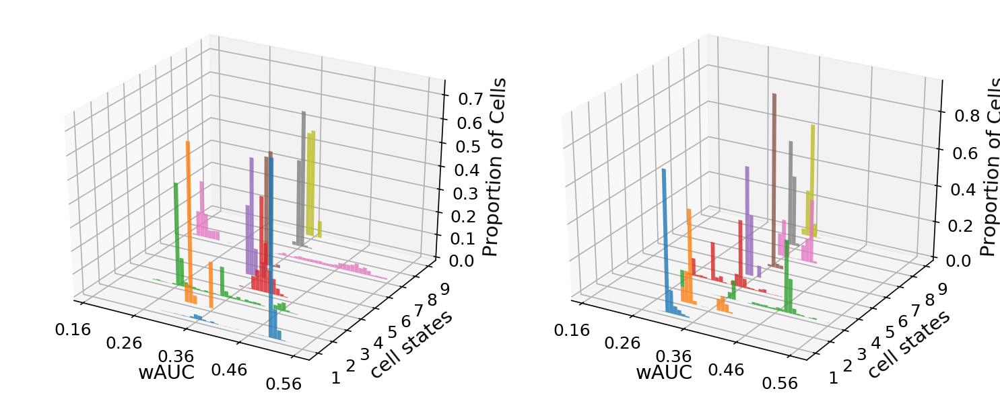

Tfam


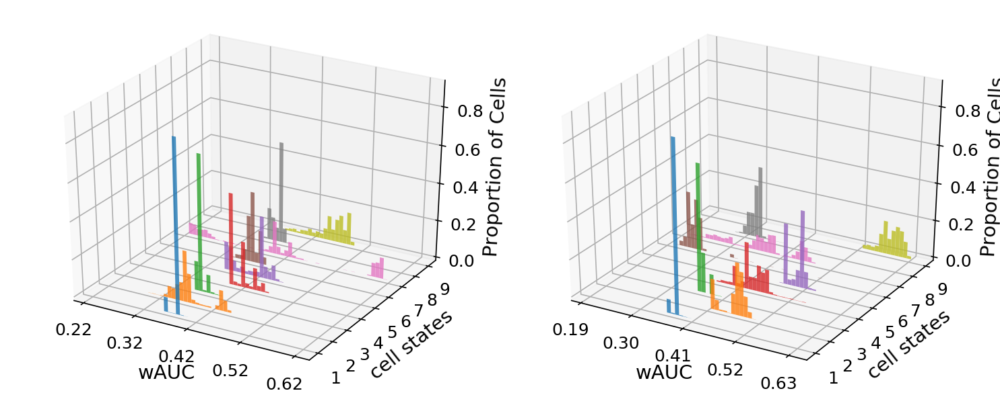

Irf9


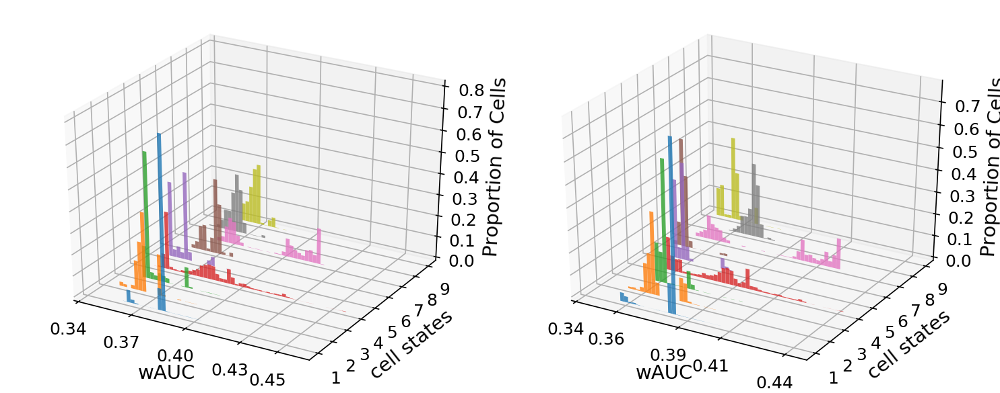

Tfdp2


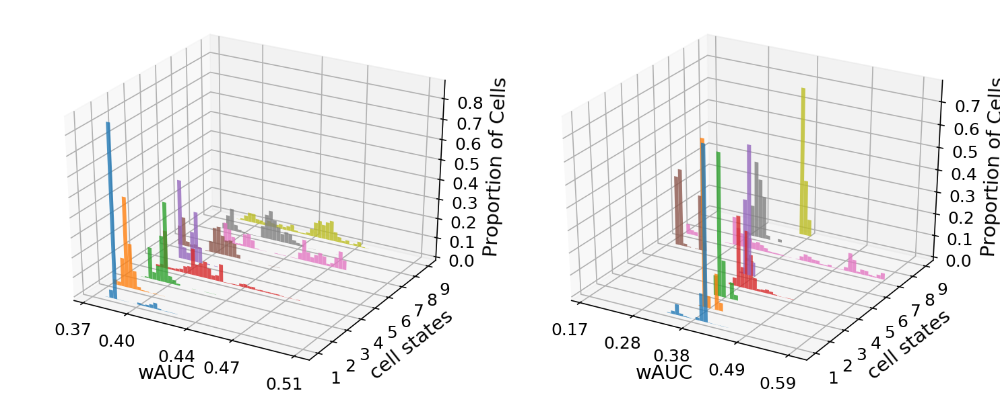

Junb


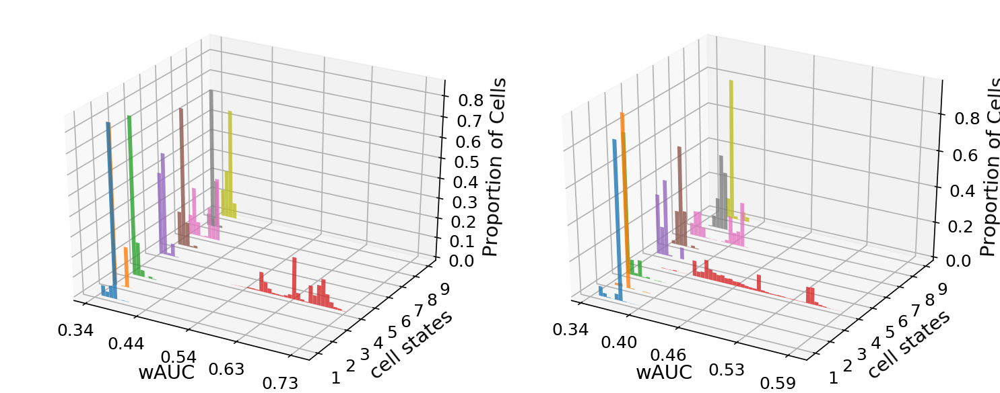

Gatad1


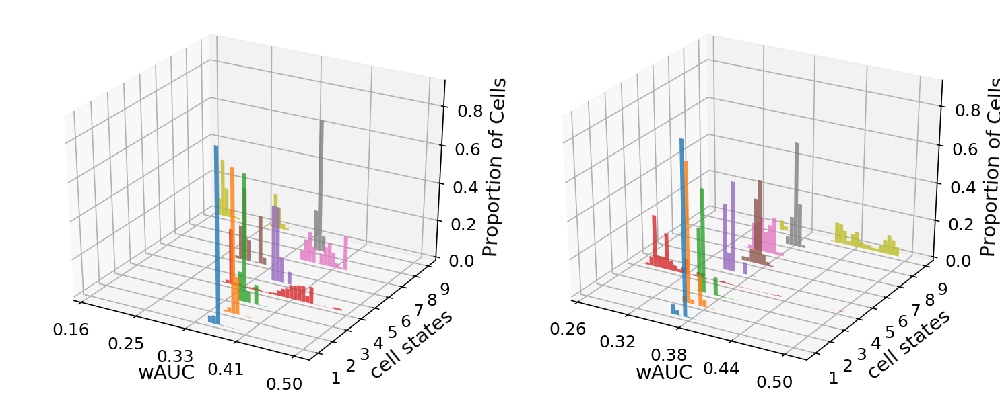

Hmg20b


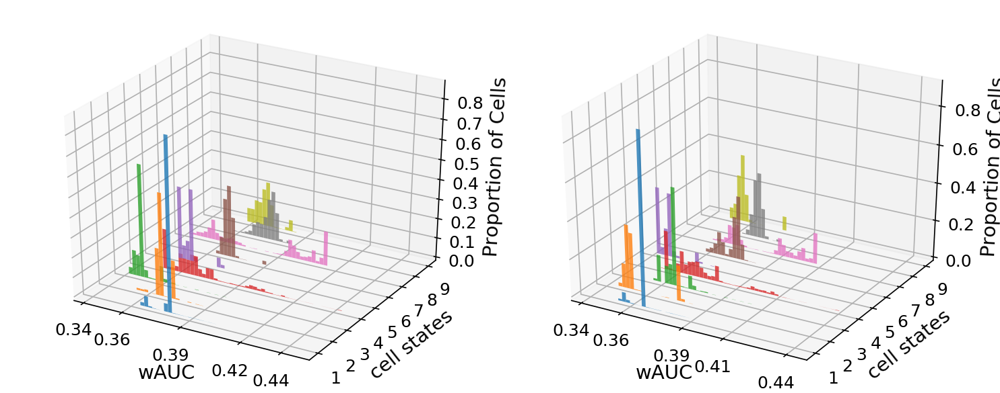

Zfp91


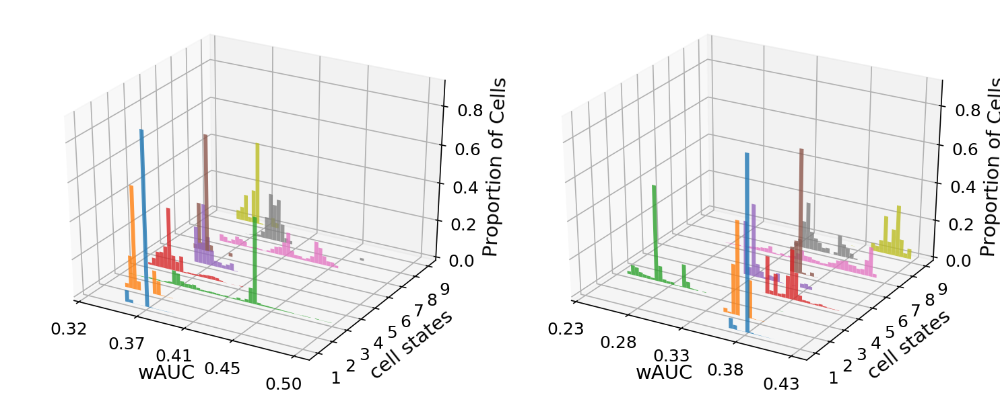

Sox5


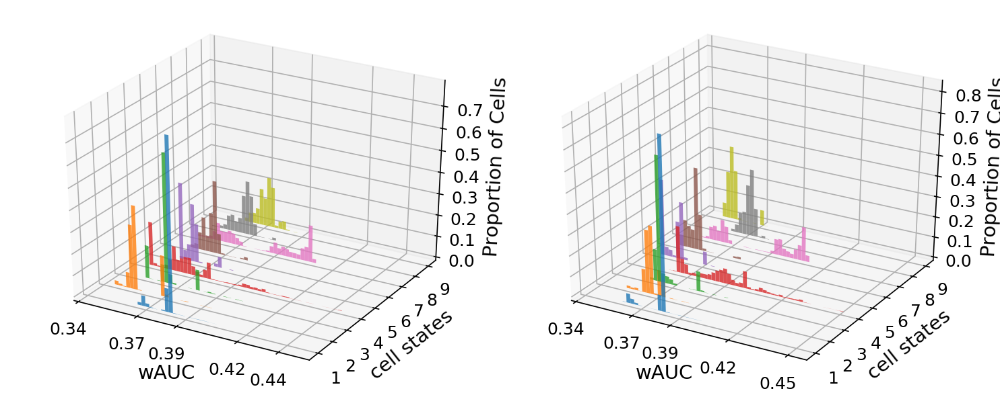

Smarce1


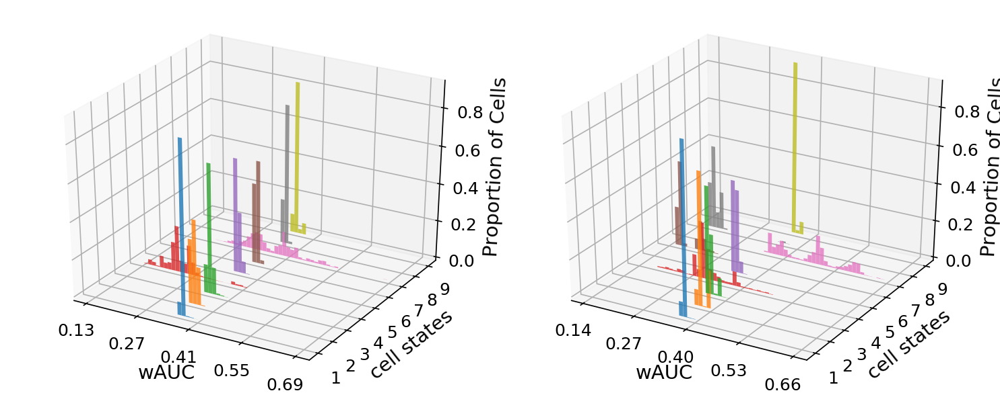

In [61]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_only_no_simic)

--------
# TFs that are only rank last variant in simic

Mier3


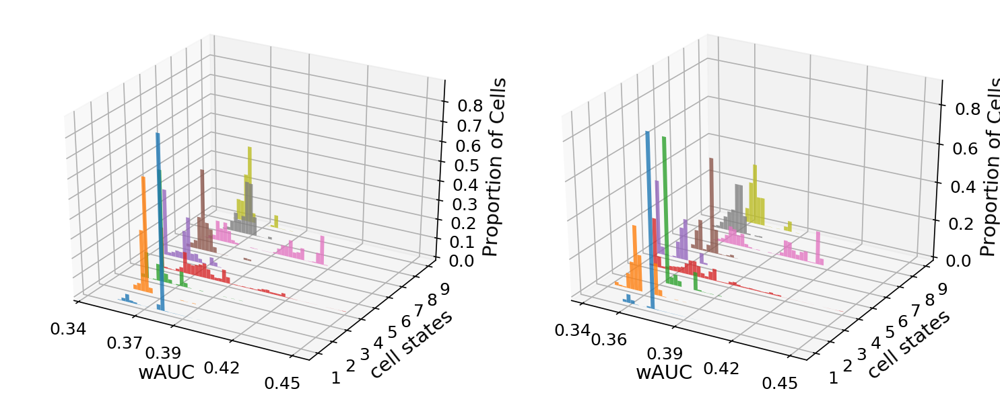

Ncoa2


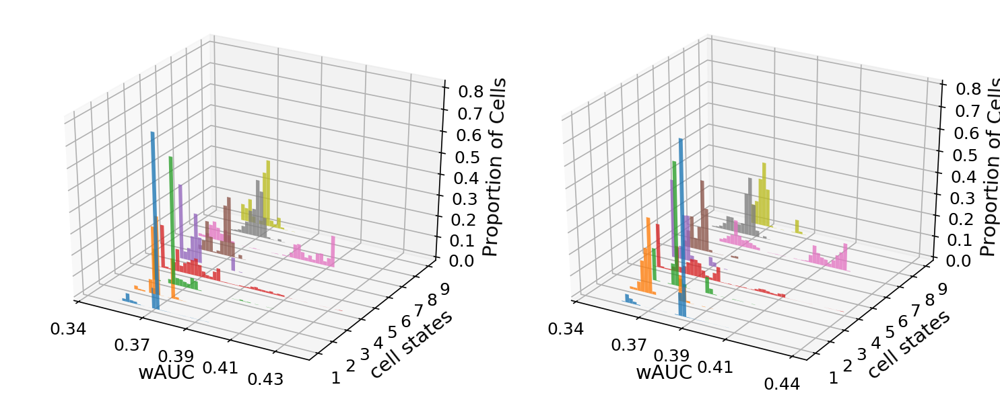

Mxd4


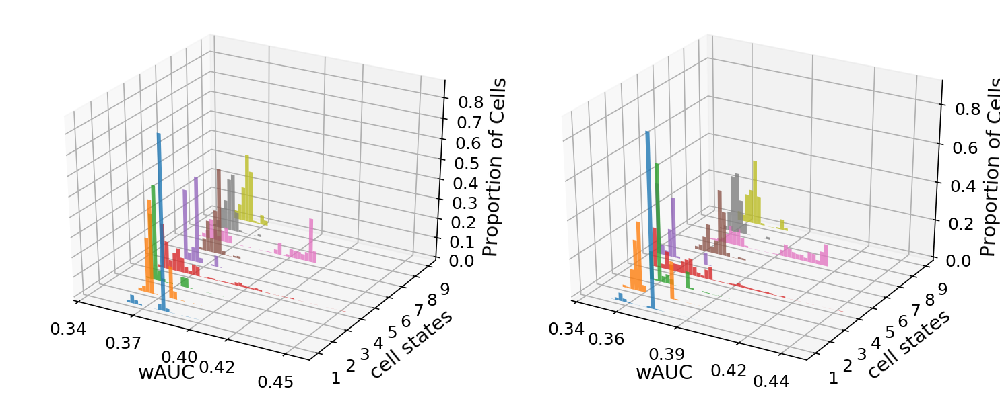

Foxp1


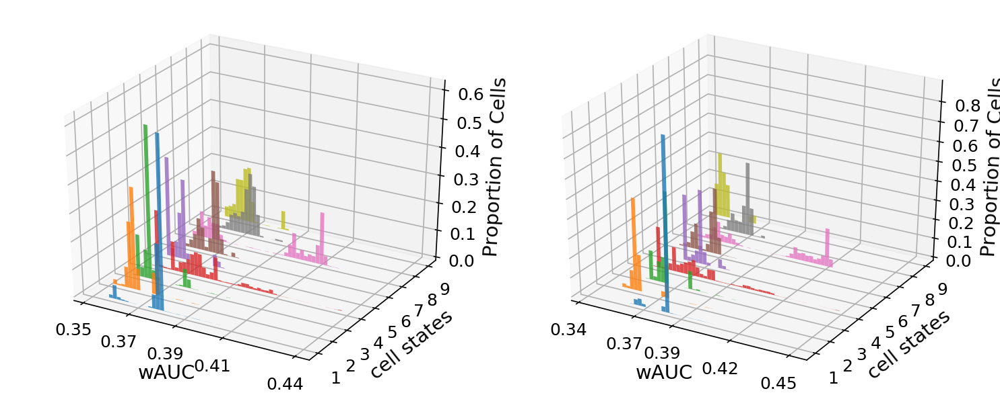

Zfp637


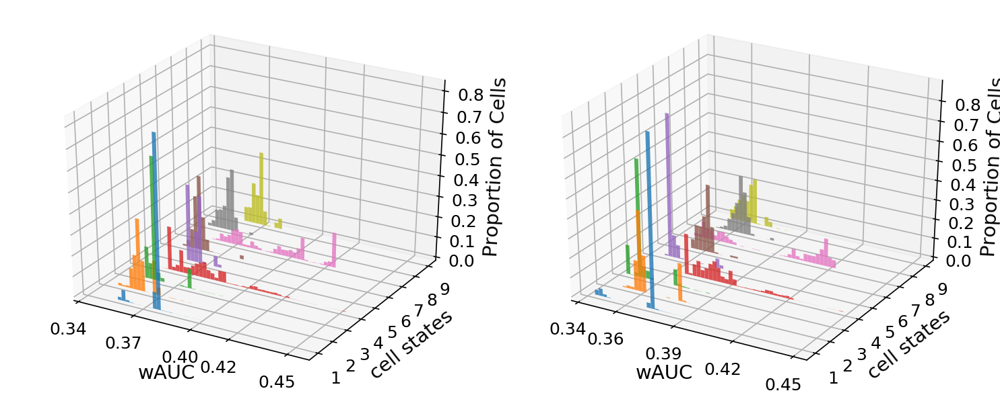

Zbtb7b


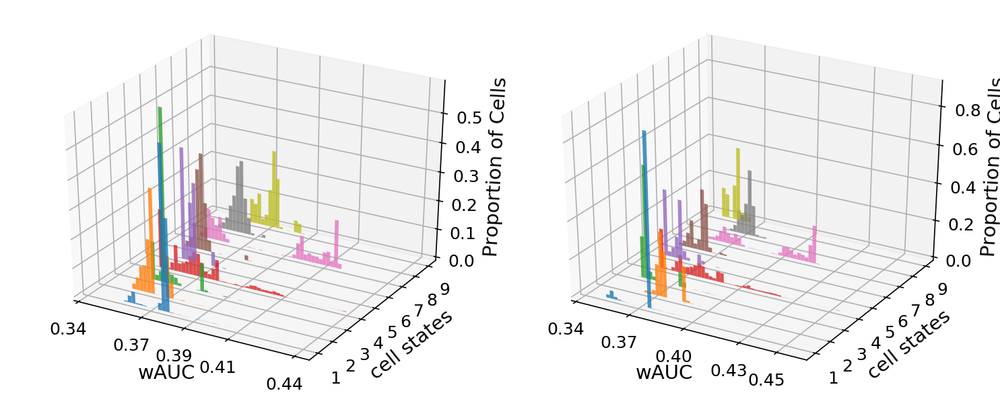

Purb


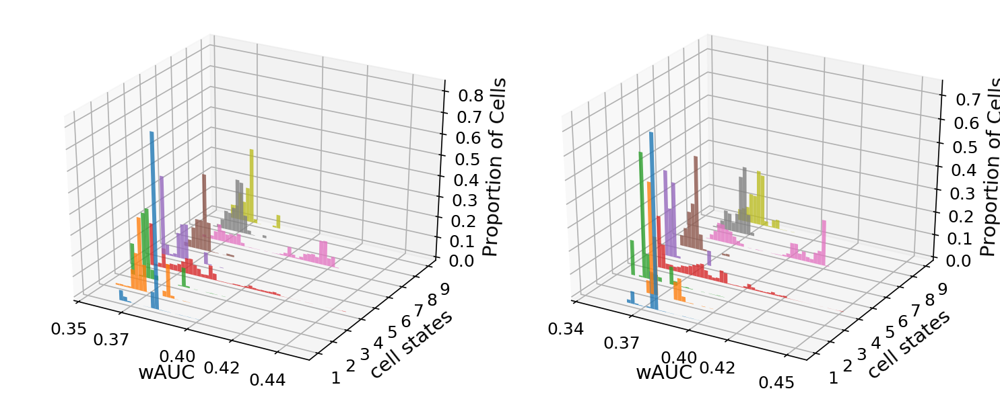

Bhlhe40


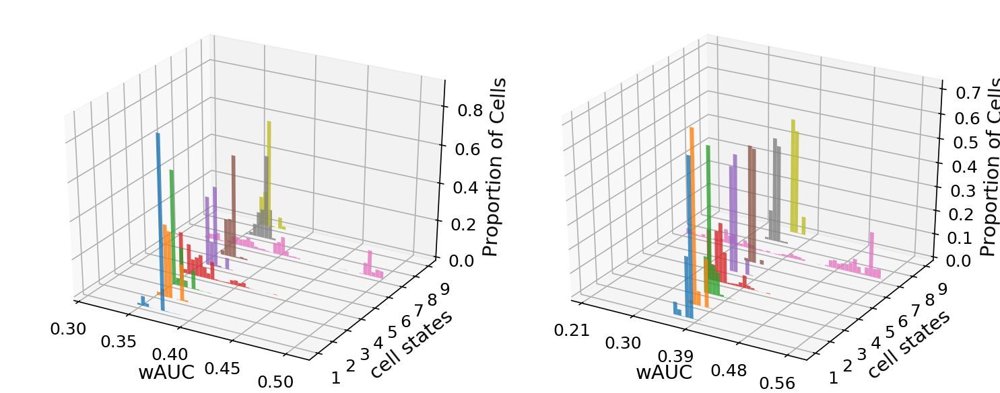

Rcor1


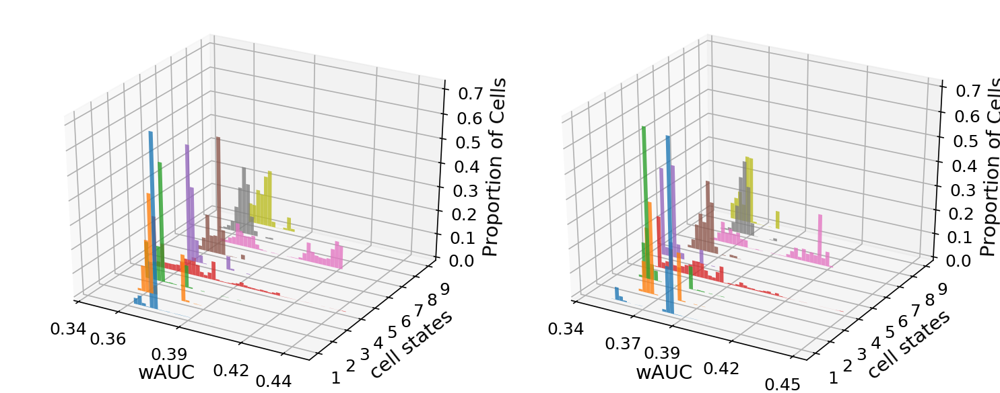

Dnajc1


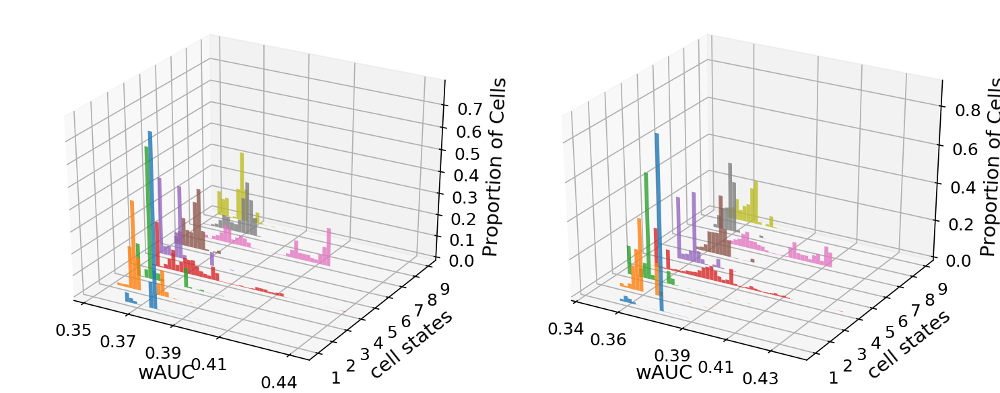

Cebpd


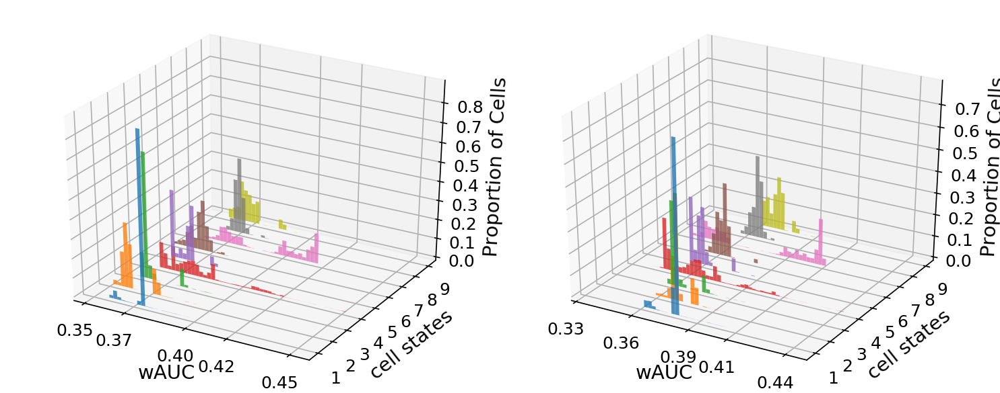

Nfkbia


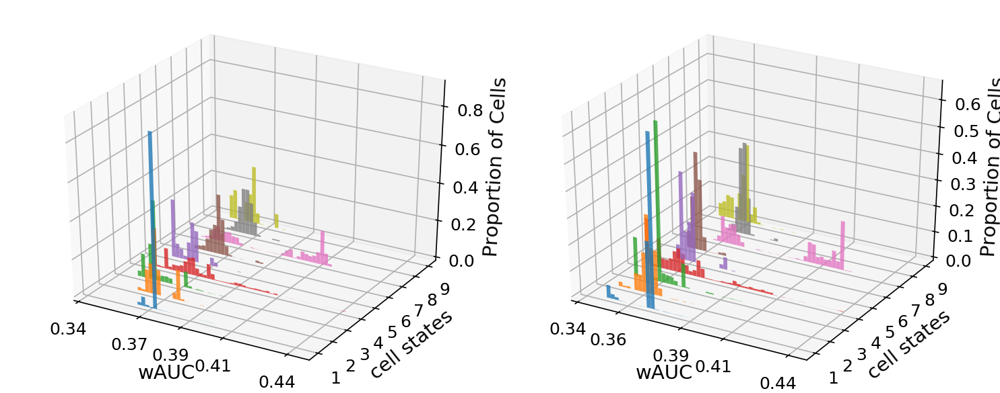

In [62]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_only_simic)

--------
# TFs that are only rank last variant in no-simic

Cdc5l


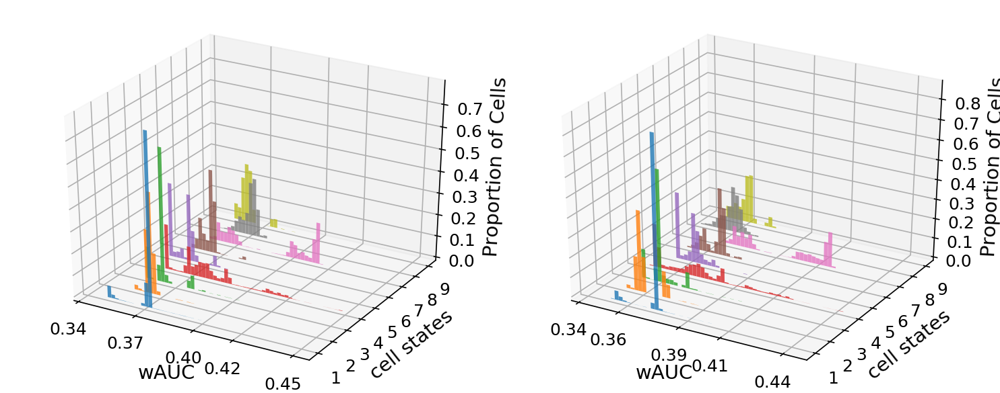

Tbx3


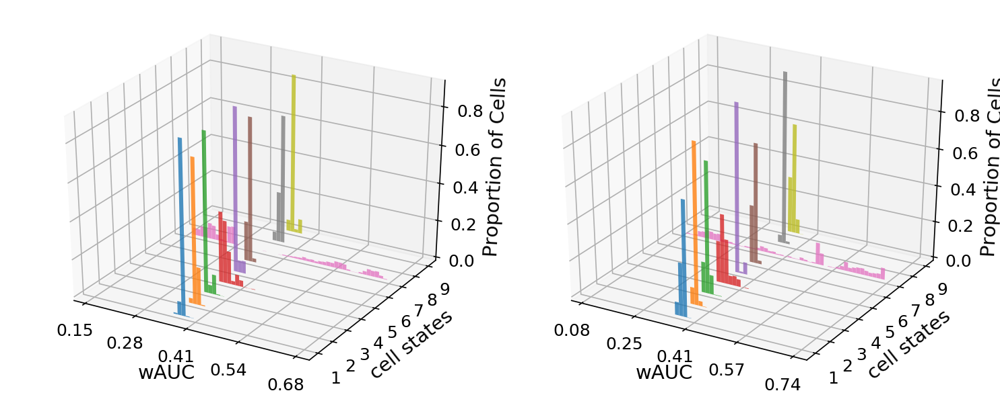

Creb3l3


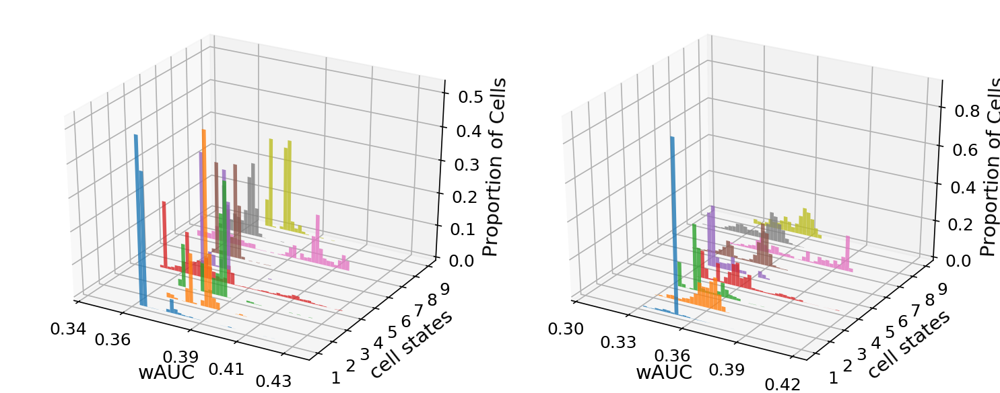

Rara


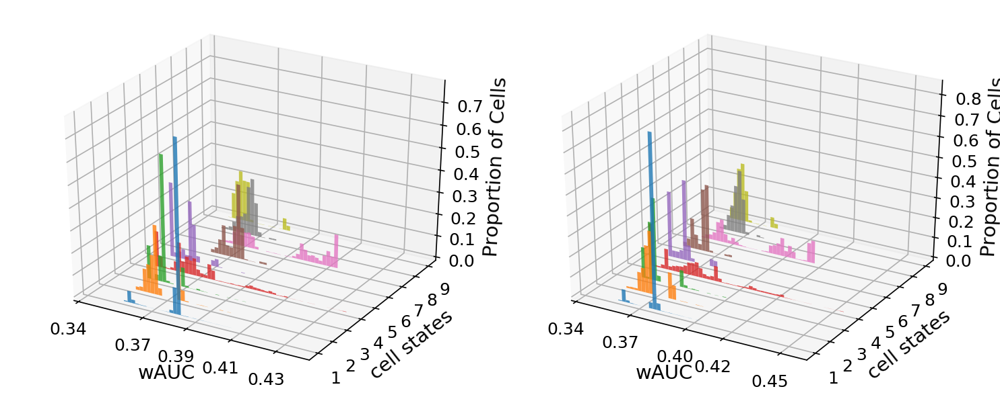

Atrx


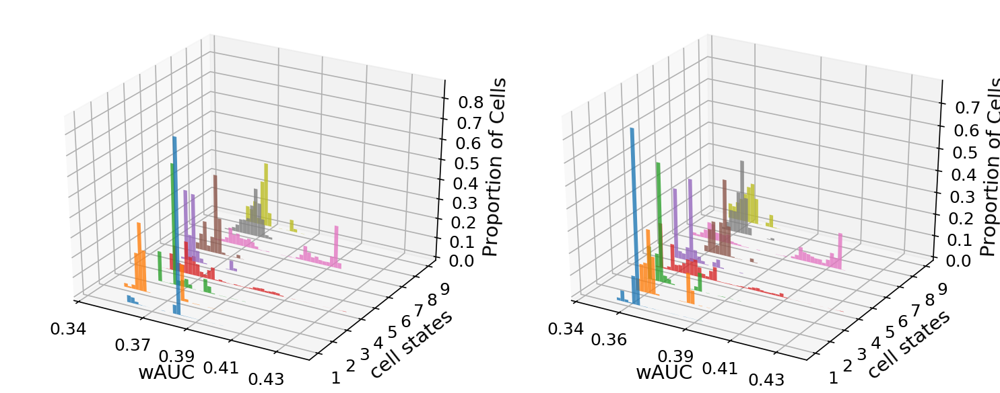

Hhex


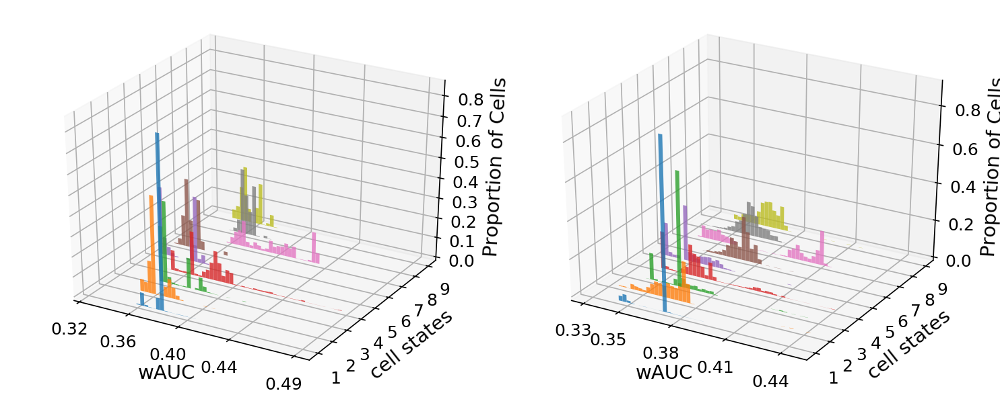

Ahr


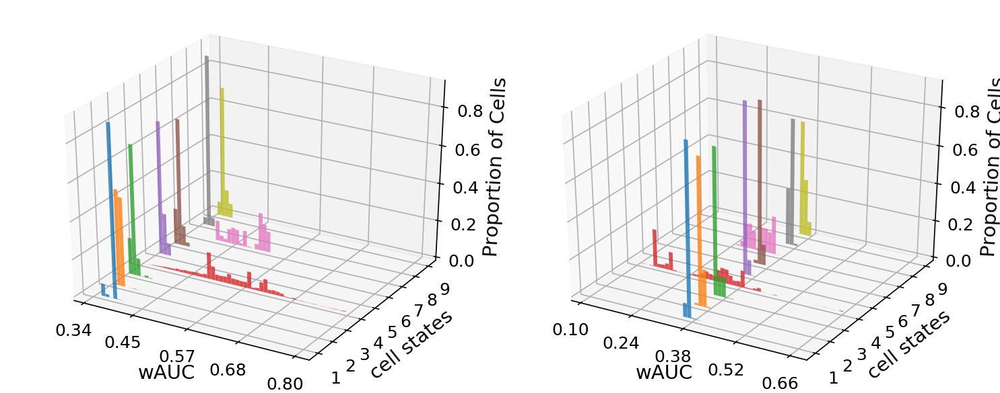

Smad4


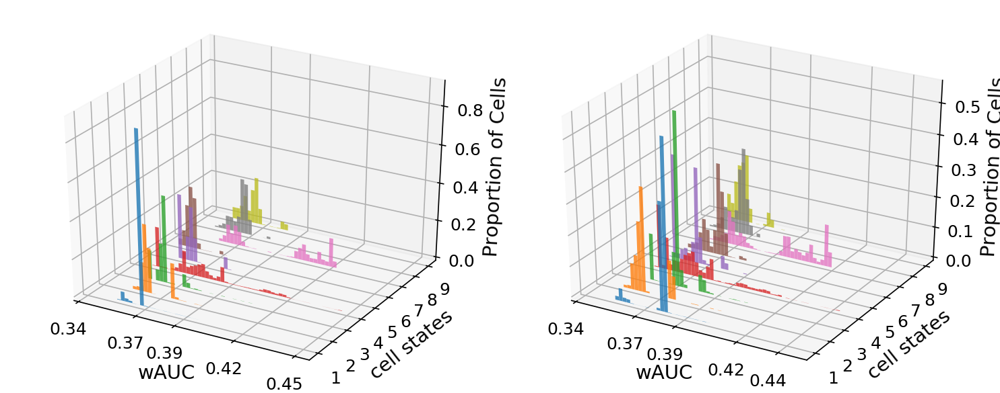

Thrb


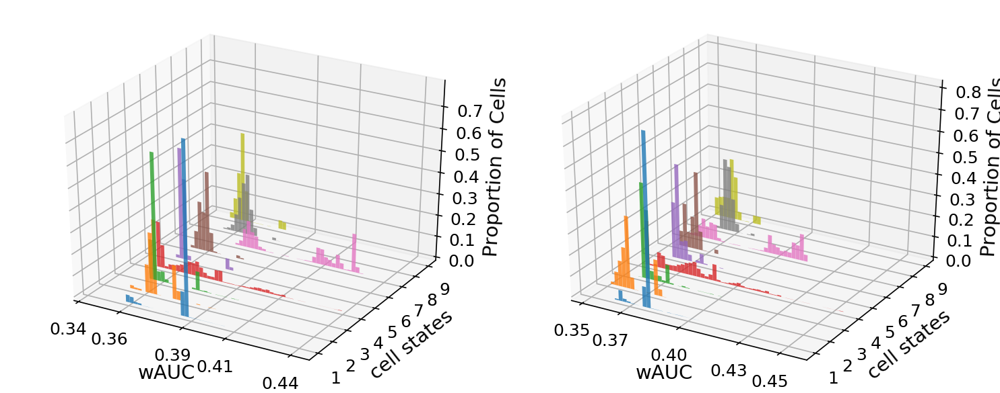

Smarcc2


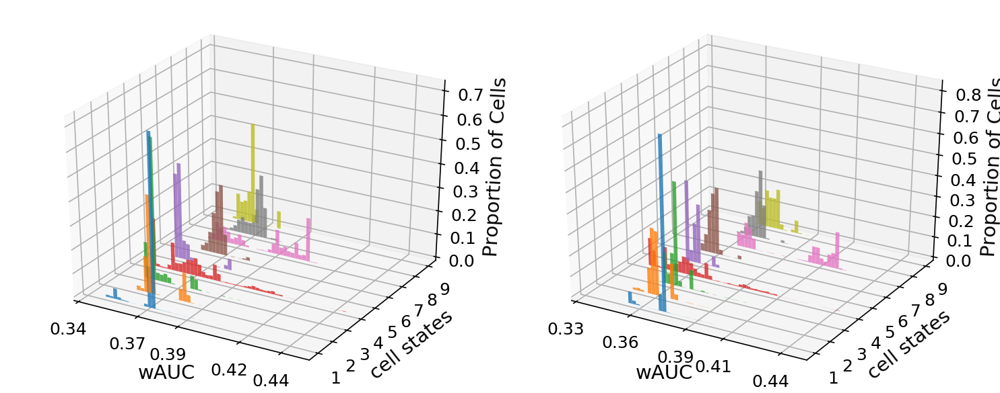

Cebpb


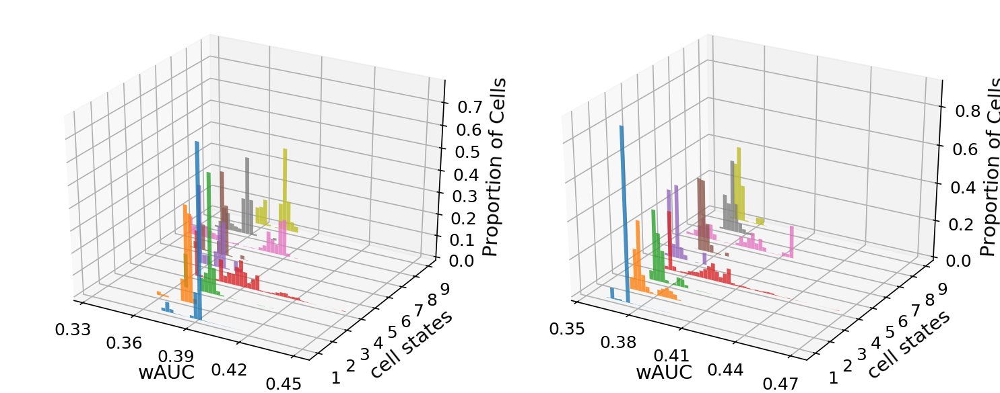

Phf5a


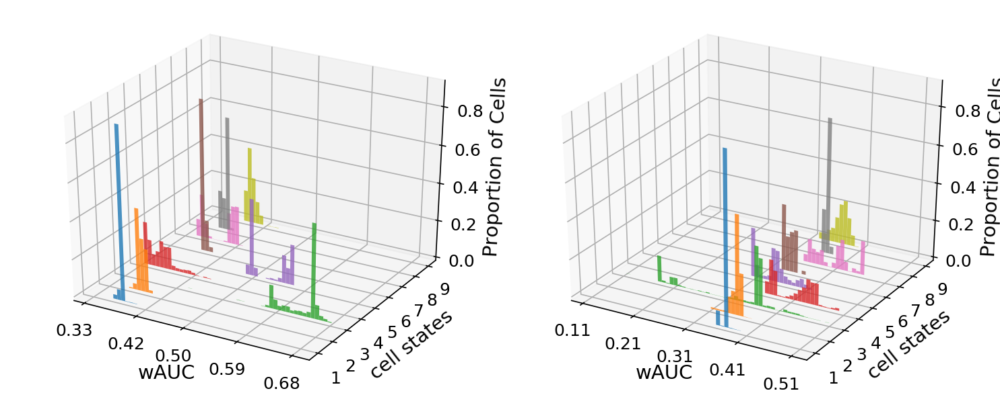

Csrnp1


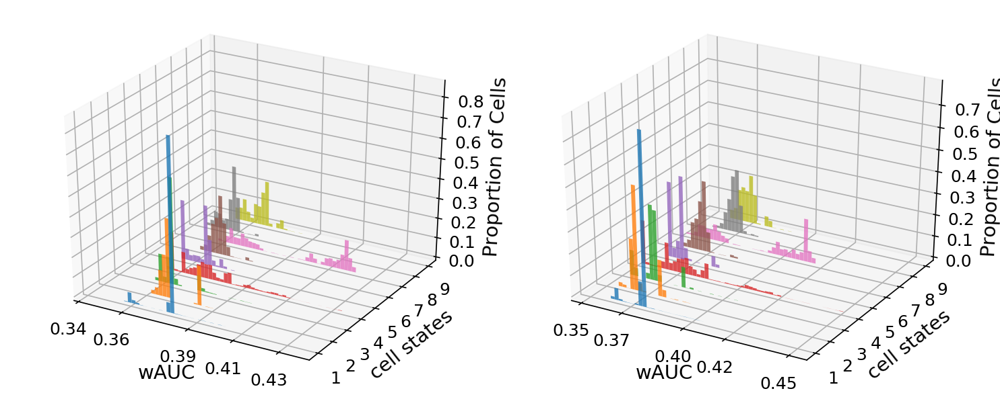

Id3


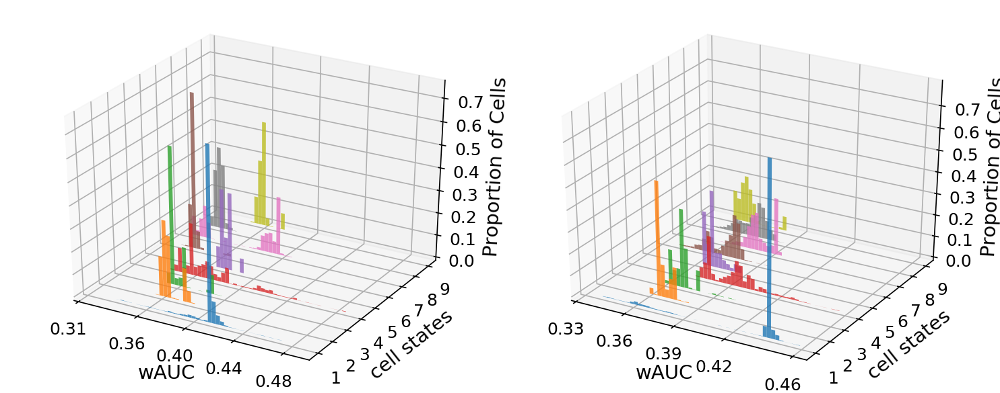

Sp3


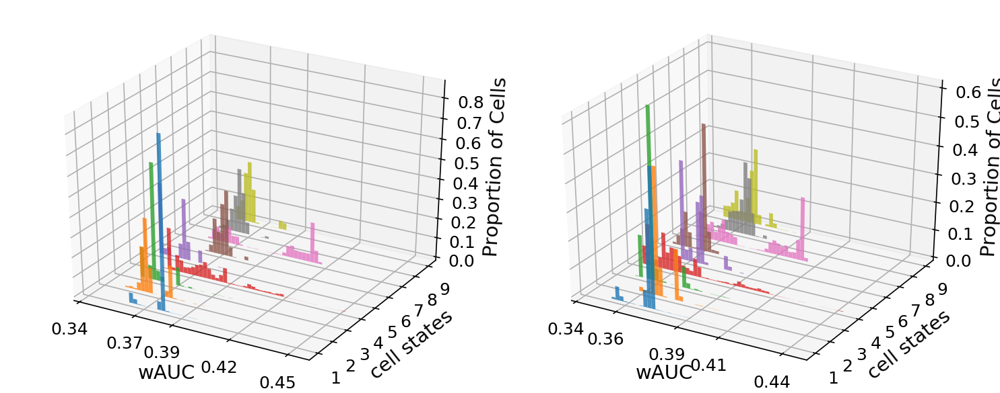

Jund


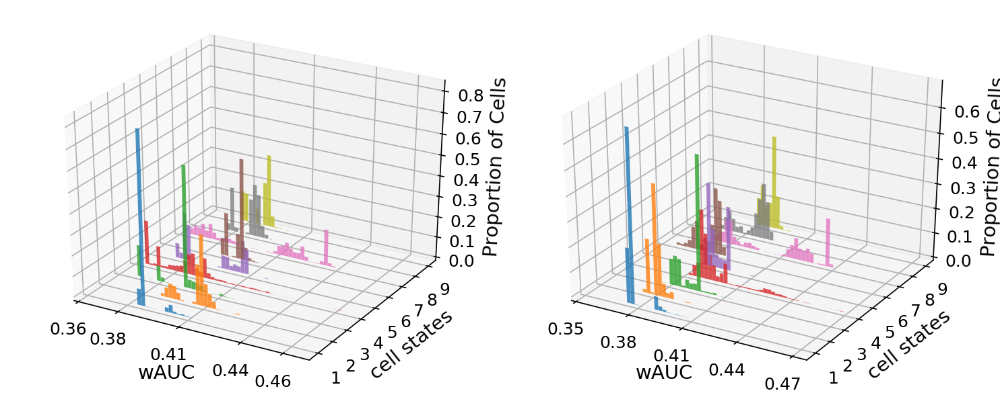

In [63]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_only_no_simic)

---------
# TFs that are rank top in simic, but last in no-simic

Id3


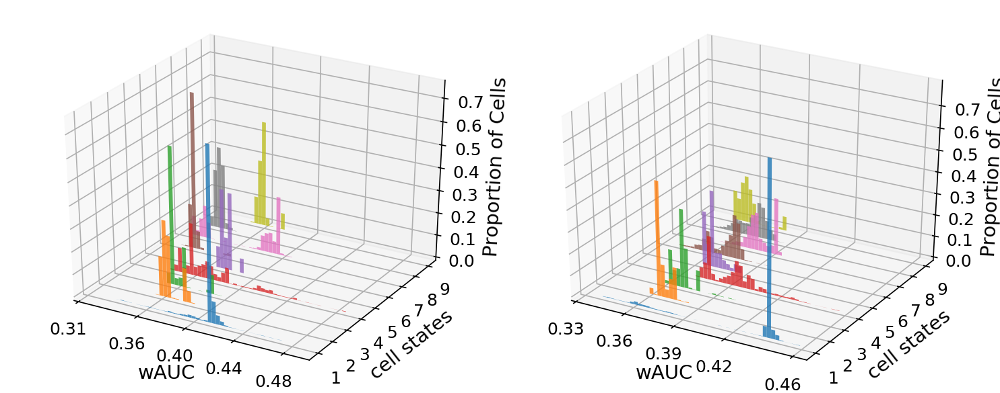

Phf5a


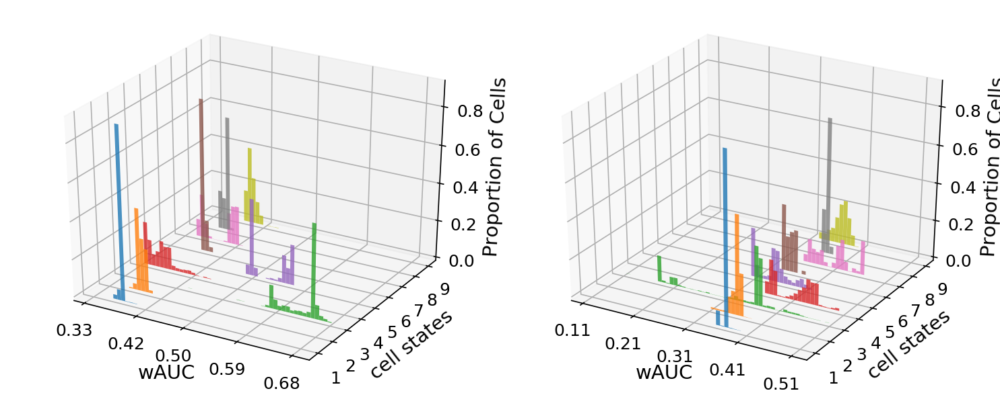

In [64]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_simic_last_no_simic)

---
# TFs that are rank last in simic, but top in no-simic

In [65]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_simic_top_no_simic)

-----
# UMAP plot of imputed expression colorred in binarized AUC

In [22]:
import umap
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
import seaborn as sns

plt.rcParams['figure.dpi'] = 150

/home/jianhao2/miniconda3/envs/conda3_py/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


In [23]:
p2df = '/data/jianhao/hepatocyte_update_dataset_101619/magic_cell_mat_w_label_pd'
# p2assign = '/data/jianhao/hepatocyte_update_dataset_101619/hepa_A249P_assign'

# assignment = []
# with open(p2assign, 'r') as f:
#     for line in f:
#         assignment.append(int(line))

df = pd.read_pickle(p2df)
df = df.drop(columns = ['label'])
df

,Rp1,Sox17,Mrpl15,Lypla1,Gm37988,Tcea1,Atp6v1h,Rb1cc1,4732440D04Rik,Pcmtd1,...,Prcd,Gm9465,Gm31508,AC154311.1,Fbxo40,AC168090.1,Wfikkn1,Crisp3,Peli3,Batf2
PN14_AAACCCAAGAAATGGG,0.004854,0.000539,0.591115,0.366935,0.000315,0.239336,0.120199,0.113393,0.002072,0.323168,...,-0.000244,0.000111,-0.000066,0.000232,-1.373859e-05,0.0,0.0,0.0,0.0,0.000152
PN14_AAACCCAAGCTGAGTG,0.004455,0.001884,0.358050,0.271369,0.000951,0.142879,0.088292,0.108493,0.003443,0.247182,...,0.000079,0.000028,0.000041,-0.000073,9.781208e-07,0.0,0.0,0.0,0.0,-0.000062
PN14_AAACCCACAACGTTAC,0.004492,0.001639,0.388067,0.285322,0.000816,0.155048,0.092182,0.108365,0.003189,0.256612,...,0.000009,0.000021,0.000021,-0.000035,-2.123797e-06,0.0,0.0,0.0,0.0,-0.000038
PN14_AAACCCAGTGCAATAA,0.004453,0.001879,0.358323,0.271515,0.000947,0.143037,0.088365,0.108483,0.003443,0.247273,...,0.000078,0.000027,0.000041,-0.000072,9.464348e-07,0.0,0.0,0.0,0.0,-0.000062
PN14_AAACCCAGTGCTCCGA,0.004463,0.001848,0.362035,0.273399,0.000929,0.144476,0.088859,0.108497,0.003409,0.248508,...,0.000068,0.000026,0.000038,-0.000068,4.196861e-07,0.0,0.0,0.0,0.0,-0.000059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PHx96_TTTGGTTGTACCCGAC,-0.000623,0.000605,1.137205,0.697996,-0.000048,0.472497,0.185700,0.190232,-0.000664,0.583412,...,0.003913,0.001488,0.000498,0.002821,1.312452e-03,0.0,0.0,0.0,0.0,0.001682
PHx96_TTTGGTTTCCAGTGTA,0.000141,-0.000569,0.940362,0.768103,-0.000276,0.415704,0.176906,0.225551,0.003126,0.655176,...,0.003943,0.000501,0.000726,0.002950,1.810040e-03,0.0,0.0,0.0,0.0,0.001591
PHx96_TTTGGTTTCCATGATG,-0.000056,-0.000831,0.883037,0.738153,-0.000483,0.388767,0.159912,0.214883,0.002815,0.619076,...,0.003794,0.000426,0.000728,0.002927,1.830409e-03,0.0,0.0,0.0,0.0,0.001548
PHx96_TTTGTTGCAAGCTACT,0.003265,0.002349,0.657112,1.464797,-0.000965,0.585532,0.355755,0.569388,0.017105,1.287136,...,0.001492,-0.000112,0.000185,0.001373,2.877550e-03,0.0,0.0,0.0,0.0,0.000824


In [24]:
set(assign_list)

{1, 2, 3, 4, 5, 6, 7, 8, 9}

In [25]:
reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(df.values)
print(embedding.shape)

/home/jianhao2/miniconda3/envs/conda3_py/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 4 separate connected components using meta-embedding (experimental)
  n_components


(18272, 2)


In [26]:
len(assign_list)

18272

In [27]:
def umap_plot(embedding, assignment, title, n_states = None, cmap_name = 'Spectral'):
    if n_states == None:
        n_states = len(set(assignment))
    plt.figure(figsize = (4, 3))
    scatter = plt.scatter(embedding[:, 0], embedding[:, 1], c=assignment, 
                          cmap = plt.get_cmap(cmap_name), s = 5)
    plt.colorbar(boundaries=np.arange(n_states + 1) - 0.5).set_ticks(np.arange(n_states))
    plt.title(title)
    
    plt.grid(alpha = 0.5)
    plt.show()

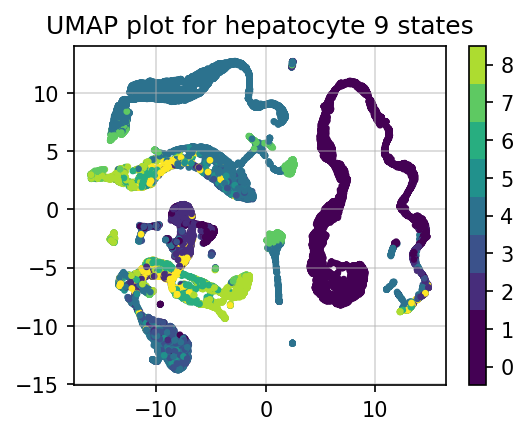

In [66]:
# n_states = len(set(assignment))
umap_plot(embedding, assign_list, 'UMAP plot for hepatocyte 9 states', cmap_name = 'viridis')

# UMAP plots with RAW/Binarized AUC value for each cell

In [32]:
selected_gene = 'Phf5a'
# selected_gene = 'Nono'

In [33]:
def four_plots_together(embedding, df, assign_list, gene_name, cmap_name = 'viridis'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(2, 2, sharex = True, sharey = True, figsize = (6, 5))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    
    # plot of normalized raw AUC value.
    ax = axs[0, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {}'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    plt.show()

Phf5a


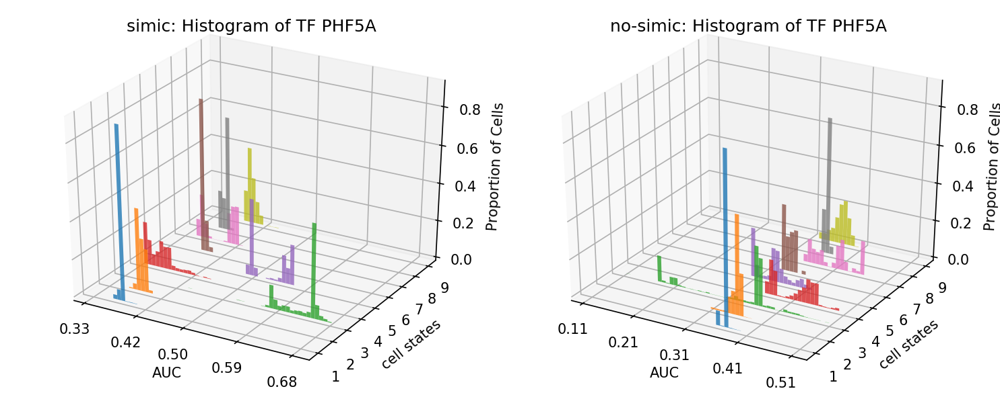

In [34]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, [selected_gene])

## Results for simic

In [35]:
with open(p2AUC_dict_simic, 'rb') as f:
    AUC_dict_simic = pickle.load(f)
    AUC_dict_simic = separate_state(AUC_dict_simic)
AUC_dict_simic.keys()

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9])

In [36]:
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_simic[state][selected_gene.upper()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.upper()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

In [38]:
# four_plots_together(embedding, df, assign_list, selected_gene)
# print('threshold = ', threshold)

## Results for no simic

In [39]:
with open(p2AUC_dict_no_simic, 'rb') as f:
    AUC_dict_no_simic = pickle.load(f)
    AUC_dict_no_simic = separate_state(AUC_dict_no_simic)
AUC_dict_no_simic.keys()

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9])

In [40]:
threshold = 0.4
# umap_plot(embedding, assign_list, 'UMAP plot for hepatocyte 5 time points')
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_no_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_no_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_no_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

In [41]:
# four_plots_together(embedding, df, assign_list, selected_gene)
# print('threshold = ', threshold)

# Side by side comparison of simic & no-simic

In [42]:
def side_by_side_cmp(embedding, df, assign_list, gene_name, cmap_name = 'viridis'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(4, 2, sharex = True, sharey = True, figsize = (6, 10))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    axs[0, 1].axis('off')
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[2, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[2, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm) - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[3, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {} - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value - no simic.
    ax = axs[3, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {} - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    plt.show()

In [43]:
# --- simic
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
    binarized_label = (AUC_dict_simic[state][selected_gene.upper()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.upper()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['simic_bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['simic_raw_label'] = total_raw_label

# --- no simic
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_no_simic.keys():
    binarized_label = (AUC_dict_no_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_no_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['no_simic_bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['no_simic_raw_label'] = total_raw_label

In [45]:
# side_by_side_cmp(embedding, df, assign_list, selected_gene)

# UMAP Plots for all TFs

In [68]:
def intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene_name, cmap_name = 'summer'):
    # --- simic
#     threshold = 0.07
#     state_label_list = []
    raw_AUC_list = []
    for state in AUC_dict_simic.keys():
#         binarized_label = (AUC_dict_simic[state][gene_name.upper()] > threshold).astype(int)
#         state_label_list.append(binarized_label)
        raw_AUC_list.append(AUC_dict_simic[state][gene_name.upper()])

    total_raw_label = pd.concat(raw_AUC_list)
    df['inter_raw_label'] = total_raw_label

    # --- no simic
#     threshold = 0.36
#     state_label_list = []
    raw_AUC_list = []
    for state in AUC_dict_no_simic.keys():
#         binarized_label = (AUC_dict_no_simic[state][gene_name.upper()] > threshold).astype(int)
#         state_label_list.append(binarized_label)
        raw_AUC_list.append(AUC_dict_no_simic[state][gene_name.capitalize()])

    total_raw_label = pd.concat(raw_AUC_list)
    df['all_raw_label'] = total_raw_label


#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(1, 2, sharex = True, sharey = True, figsize = (6, 2))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
#     # plot of true label.
#     ax = axs[0, 0]
#     im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
#                           cmap = plt.get_cmap(cmap_name), 
#                           s = 3, alpha = 0.6)
#     n_states = len(set(assign_list))
#     cb = fig.colorbar(im, ax = ax,
#                      boundaries=np.arange(n_states + 1) - 0.5)
#     cb.set_ticks(np.arange(n_states))
#     title = 'UMAP of expression for {} states'.format(n_states)
#     ax.set_title(title, fontsize = 6)
#     ax.grid(alpha = 0.5)
#     ax.tick_params(axis = 'both', which = 'both', labelleft = False)
#     axs[0, 1].axis('off')
    
    # plot of normalized raw AUC value.
    ax = axs[0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['inter_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['all_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - LASSO'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    print('-' * 7)
    print(gene_name)
    
    plt.show()
#     df.drop('inter_raw_label')
#     df.drop('all_raw_label')

-------
NCOA2


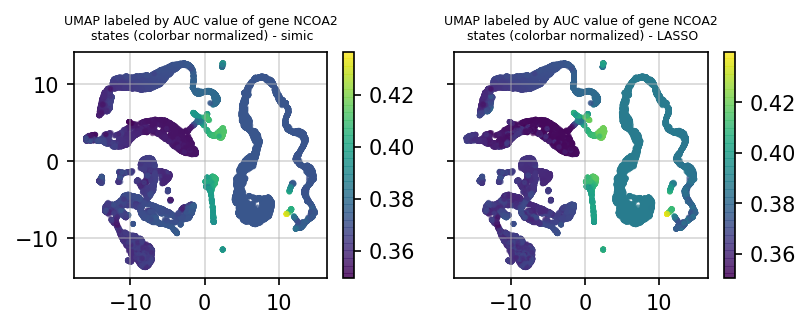

-------
STAT1


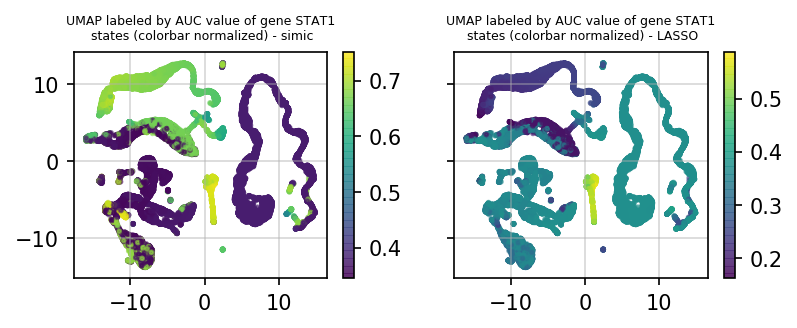

-------
LRRFIP1


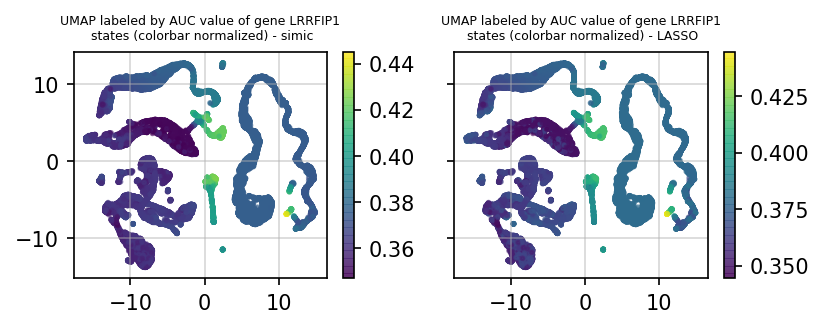

-------
HES6


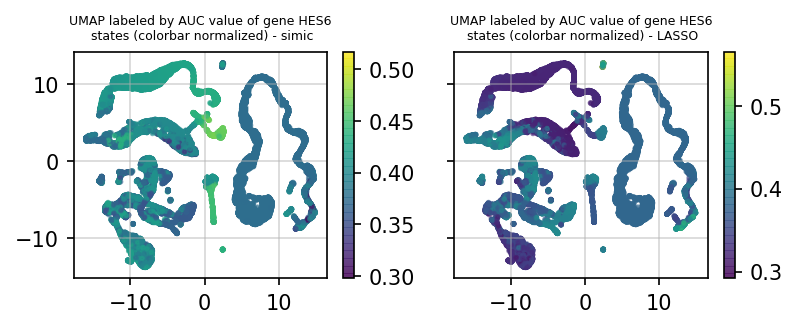

-------
ELK4


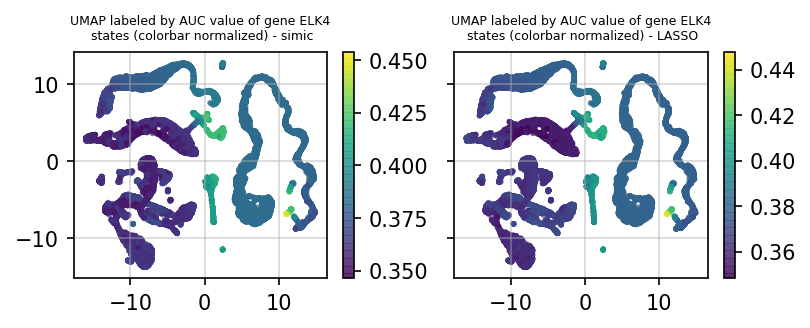

-------
NR5A2


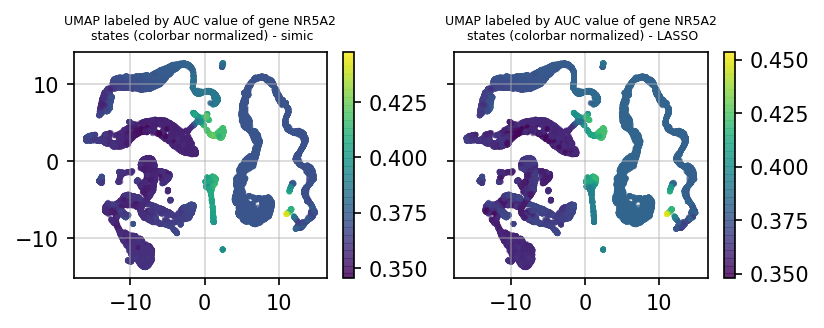

-------
ATF6


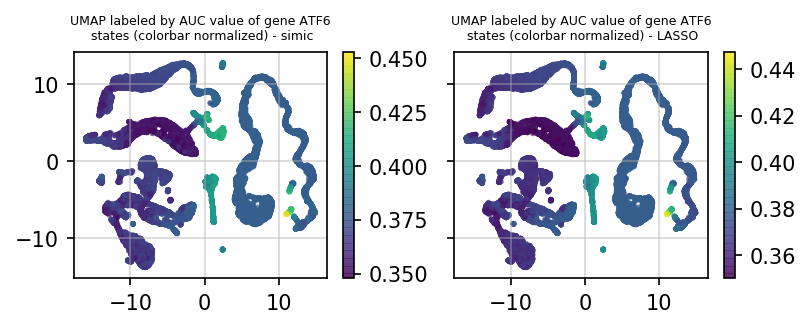

-------
NR1I3


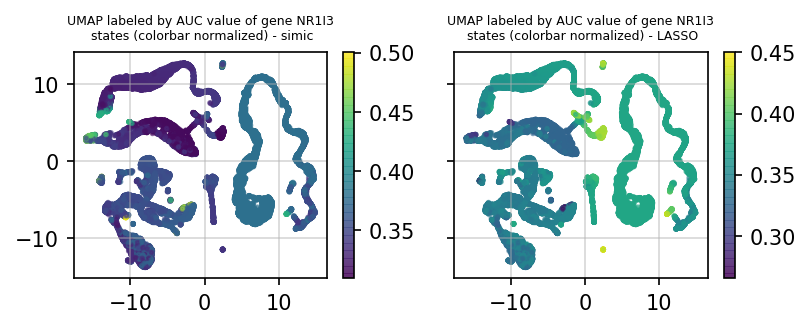

-------
PROX1


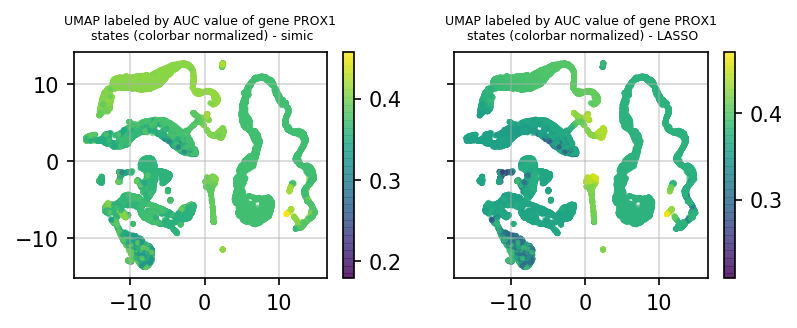

-------
IRF6


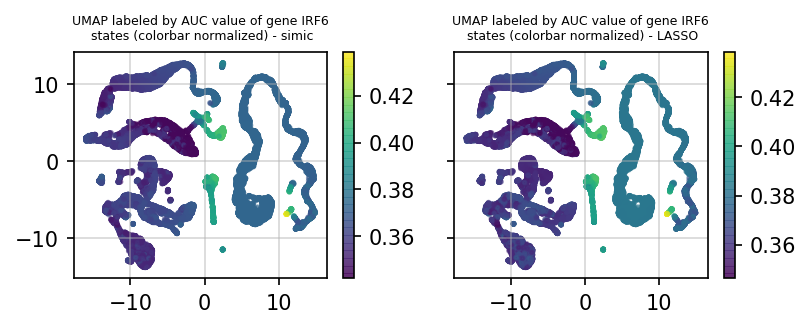

-------
DNAJC1


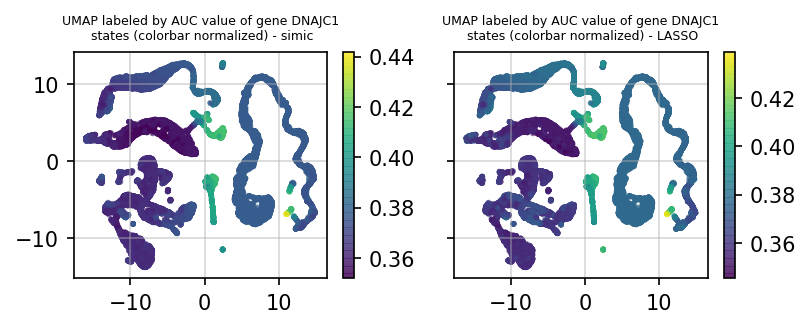

-------
RXRA


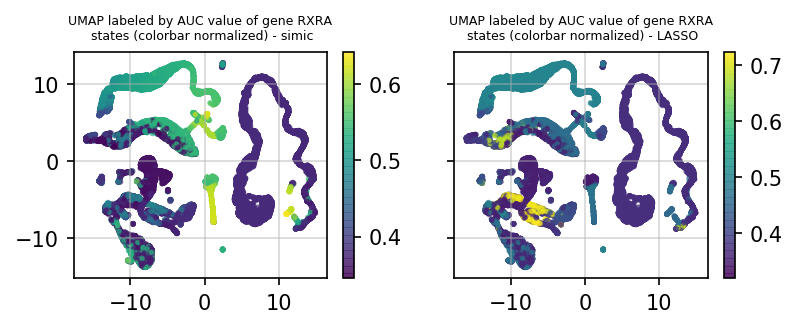

-------
RC3H2


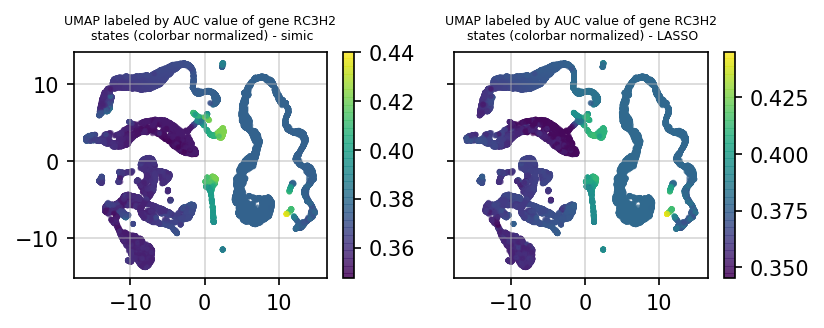

-------
SP3


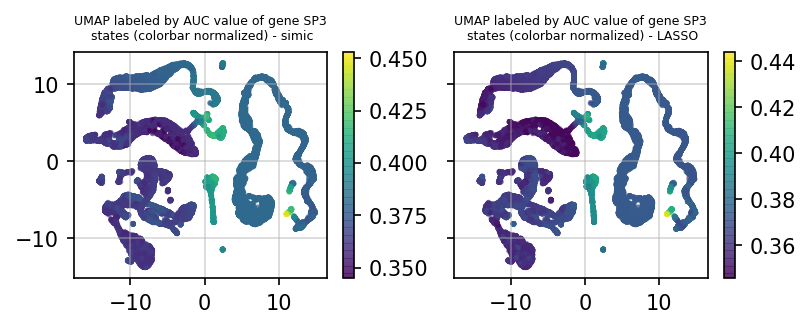

-------
ATF2


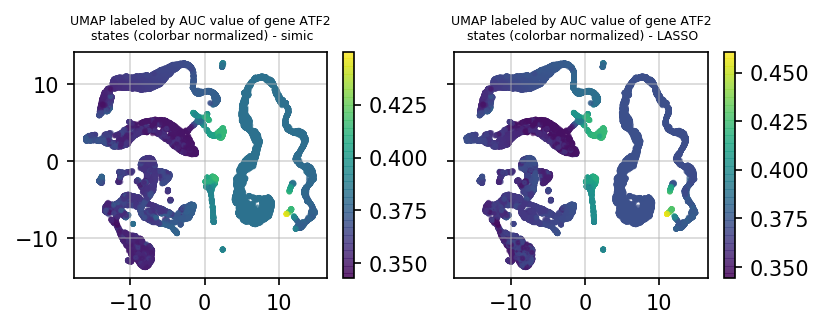

-------
NFE2L2


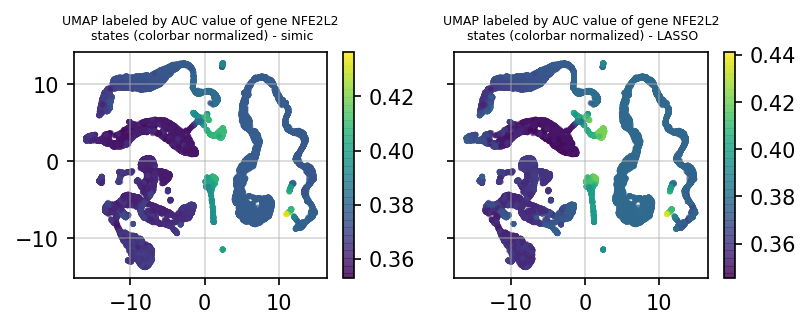

-------
SSRP1


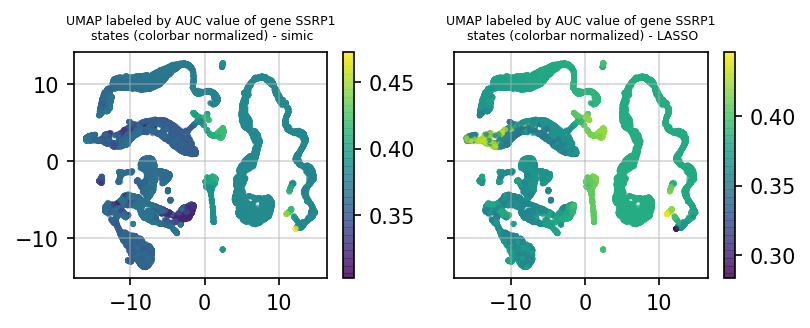

-------
NR1H3


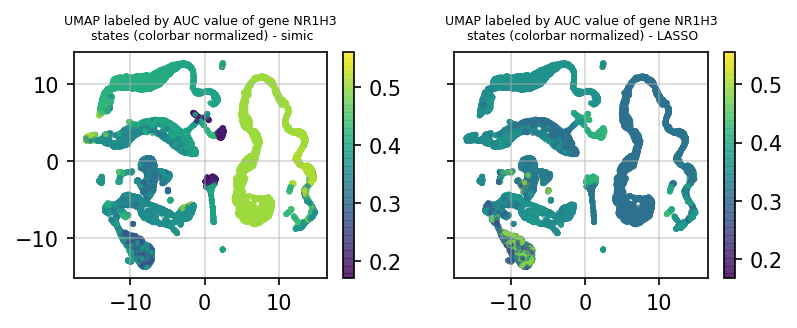

-------
MGA


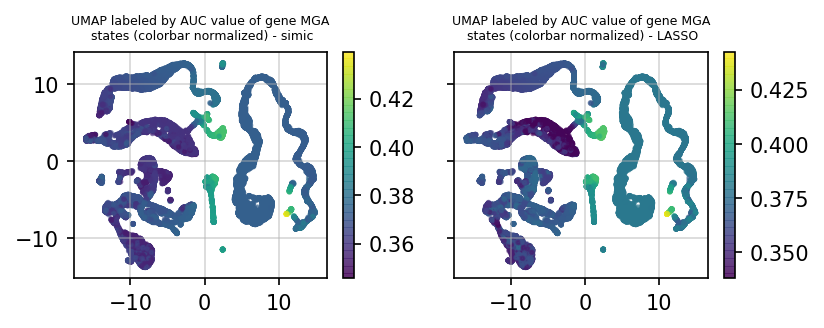

-------
FOXA2


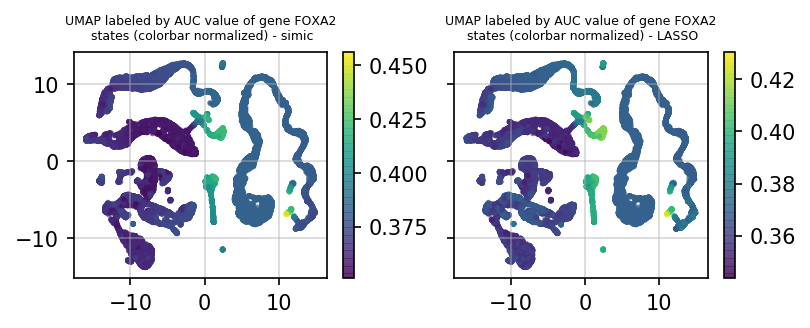

-------
GZF1


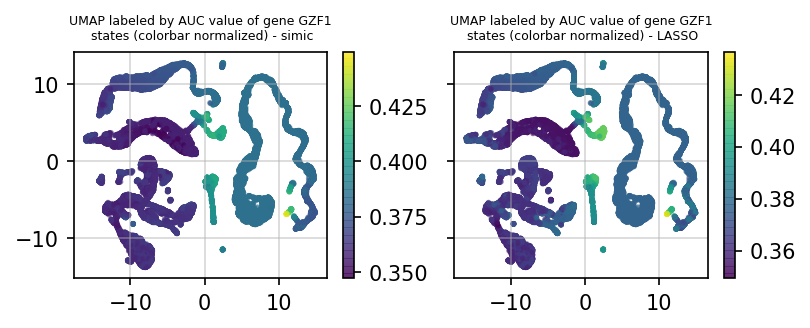

-------
ID1


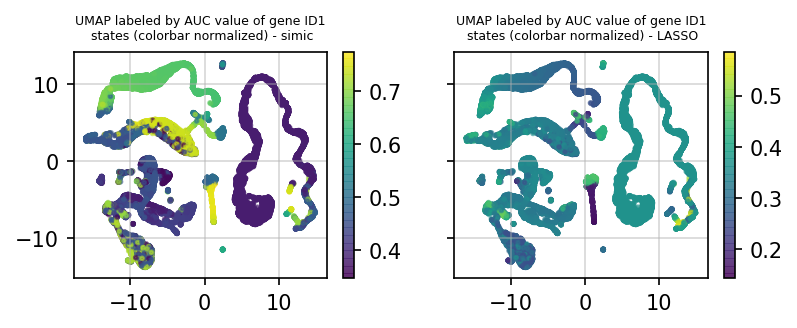

-------
E2F1


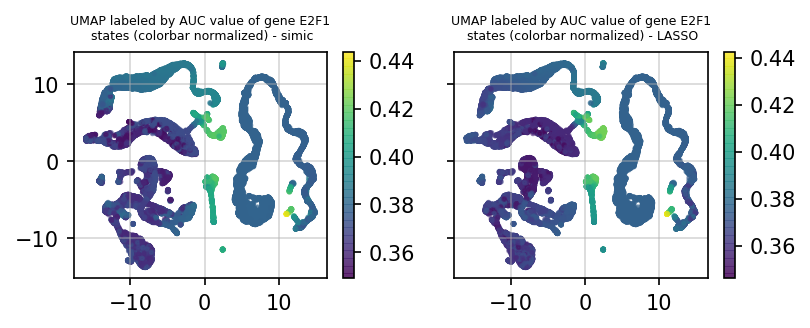

-------
MAFB


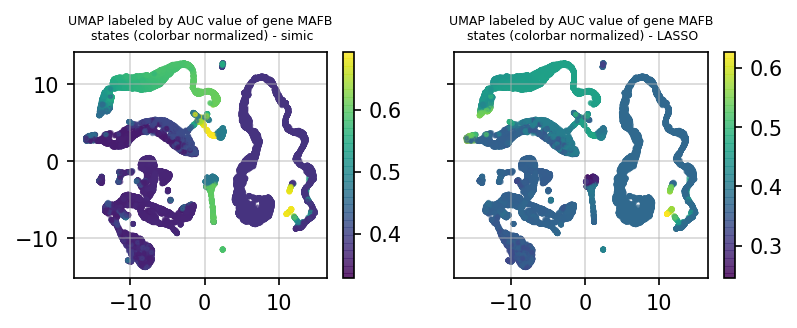

-------
ZHX3


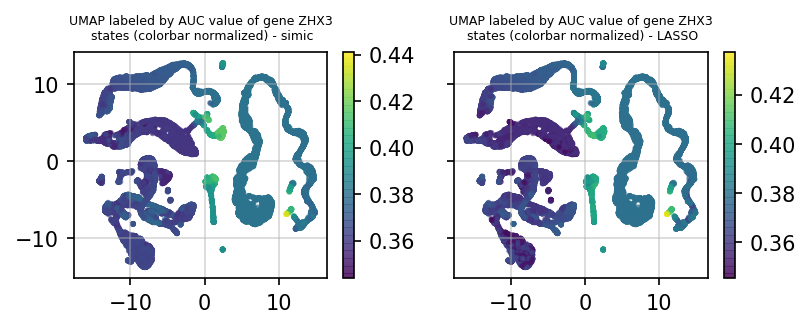

-------
HNF4A


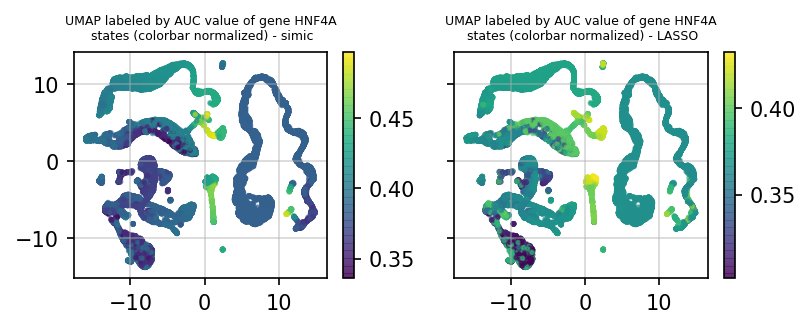

-------
CEBPB


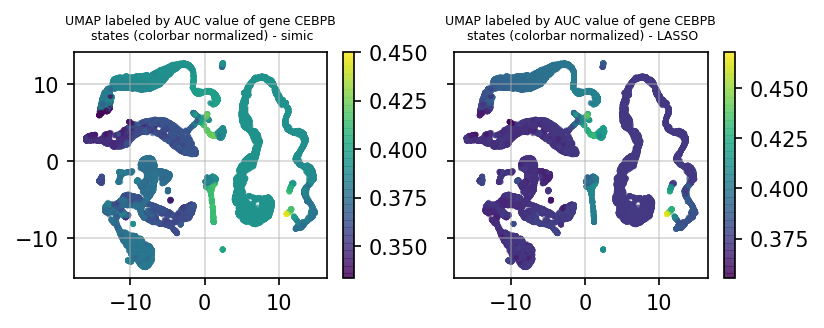

-------
TFE3


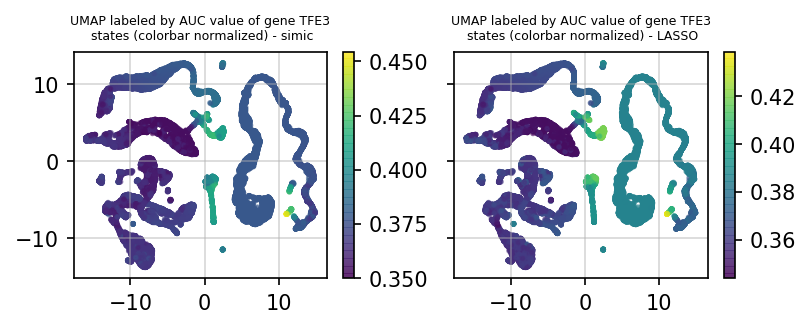

-------
ZBTB33


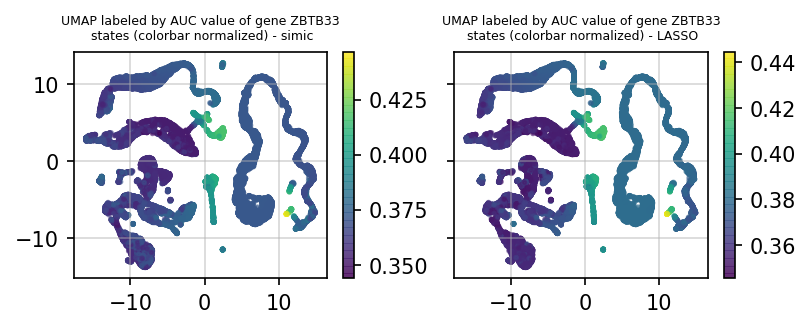

-------
NONO


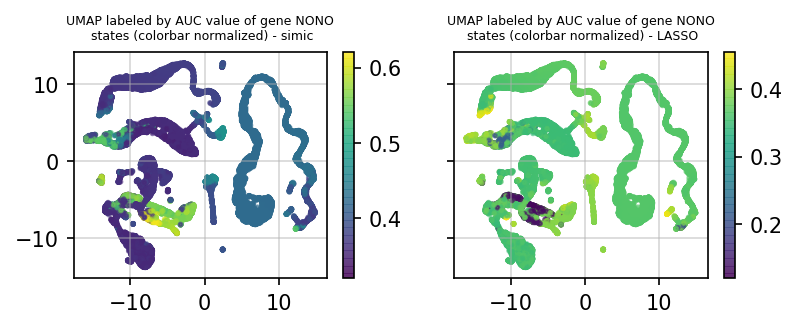

-------
ATRX


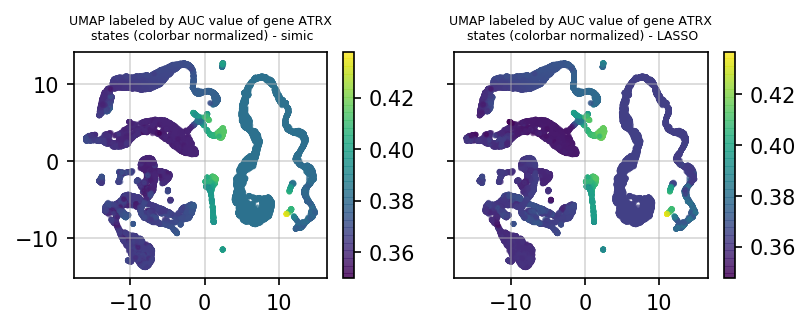

-------
TSC22D3


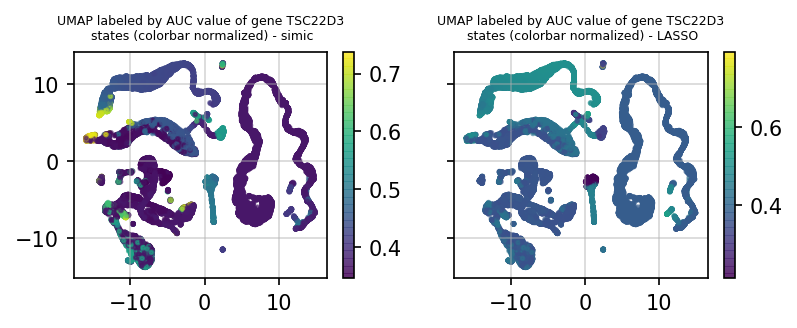

-------
FOXO1


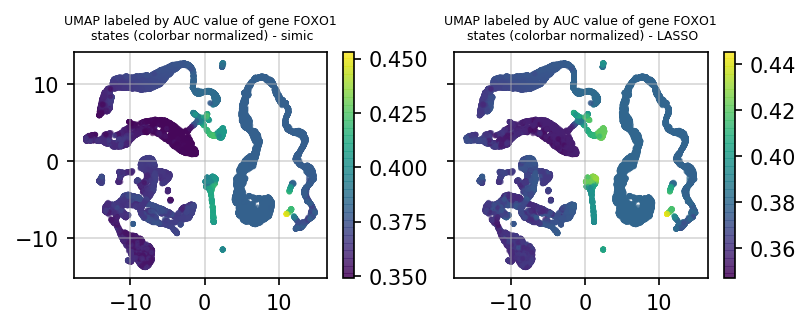

-------
RFXAP


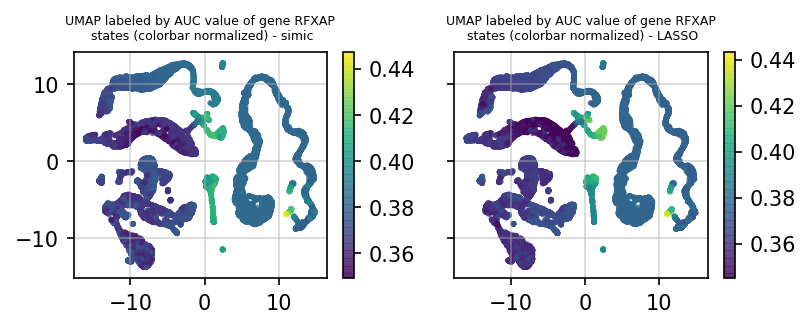

-------
TSC22D2


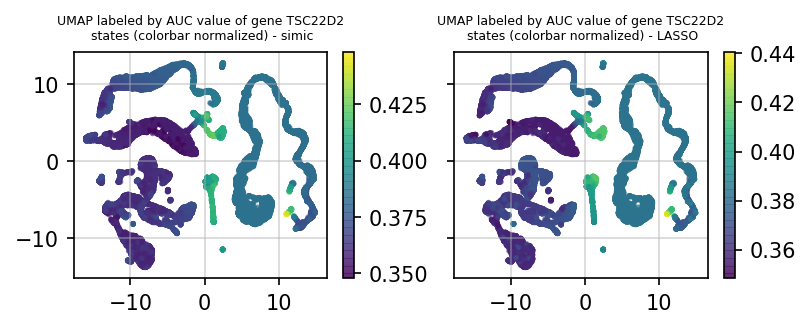

-------
ZBTB7B


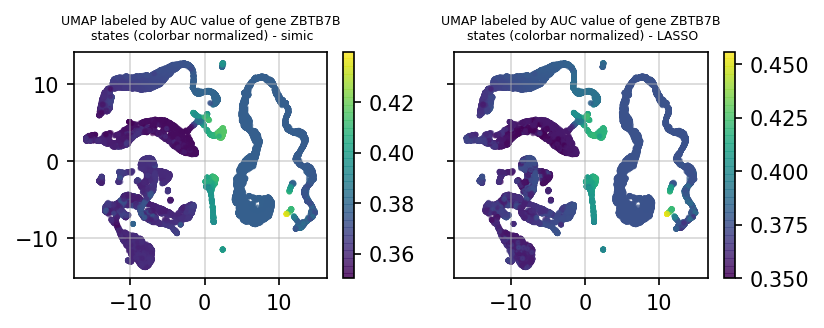

-------
GATAD2B


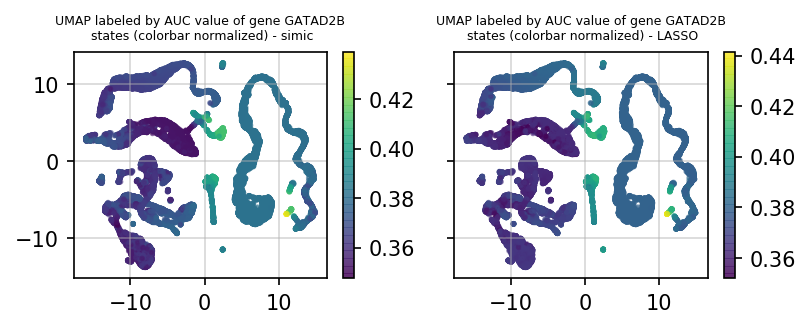

-------
NFX1


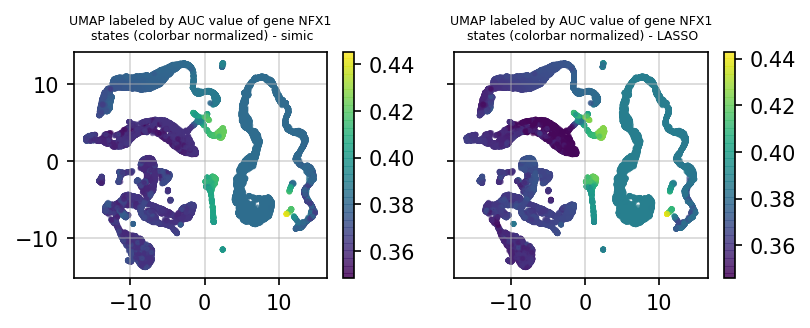

-------
NFIB


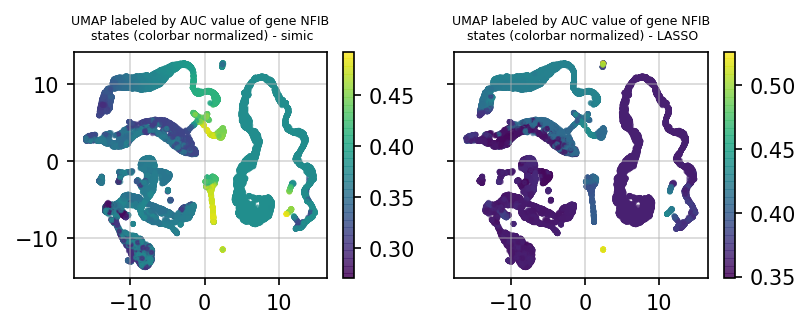

-------
JUN


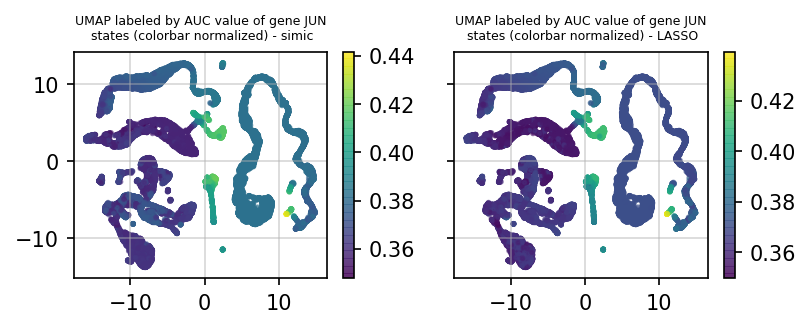

-------
NFIA


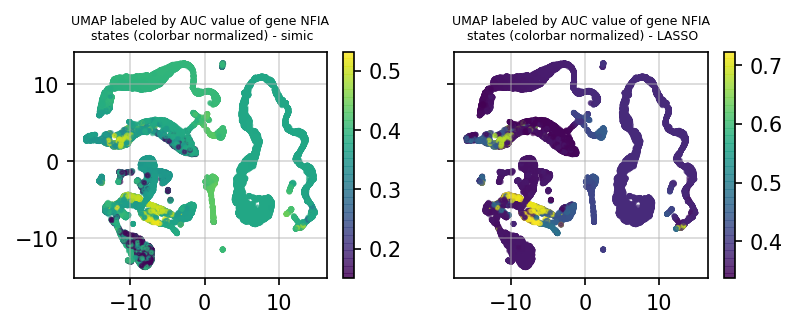

-------
MIER1


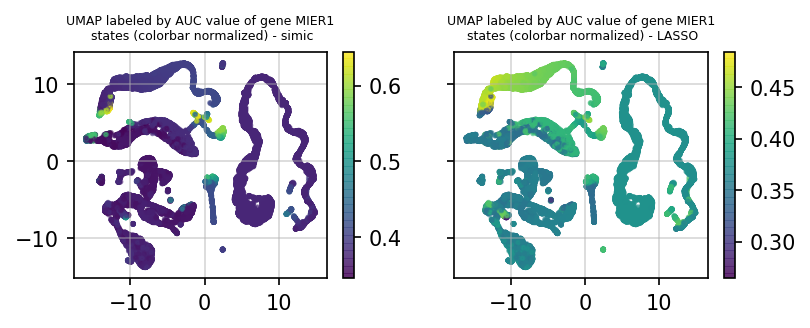

-------
YBX1


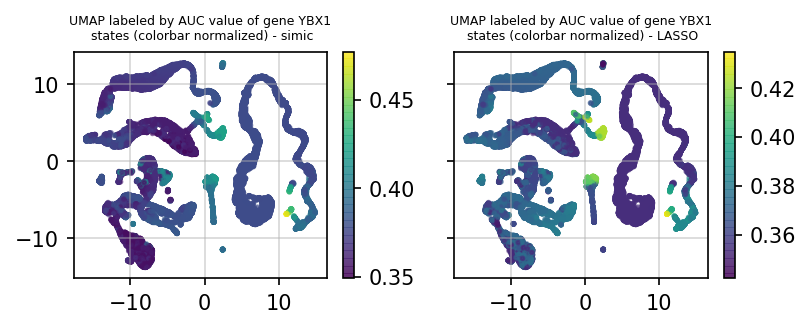

-------
RLF


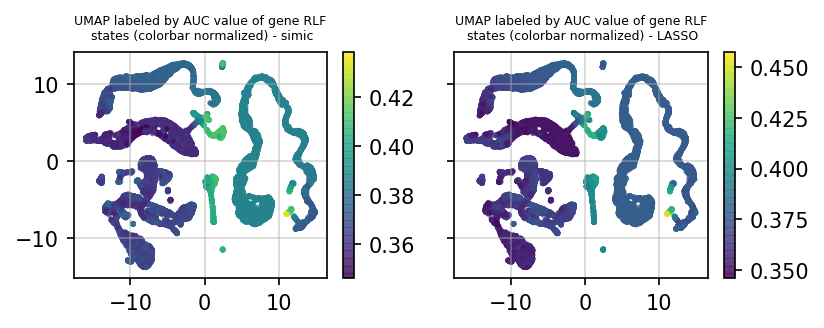

-------
SFPQ


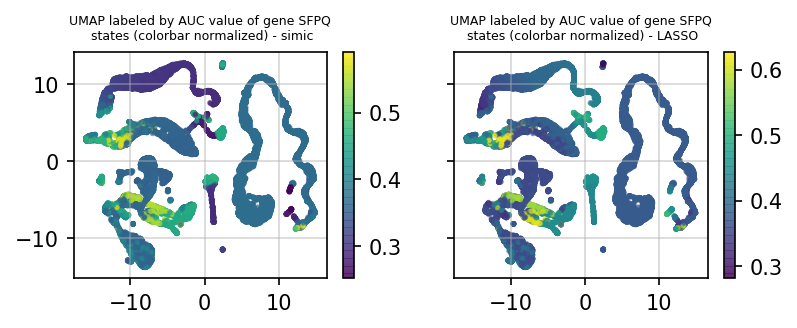

-------
NR0B2


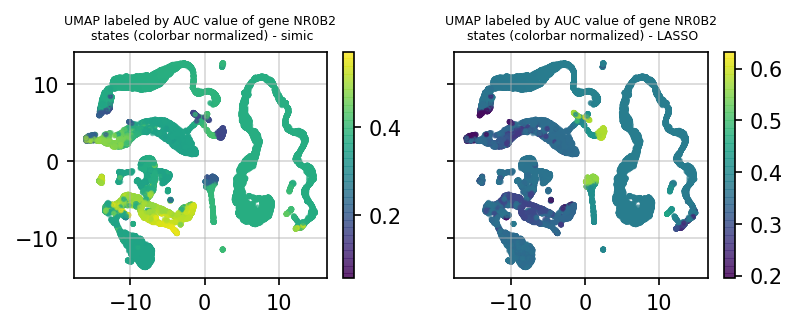

-------
ARID1A


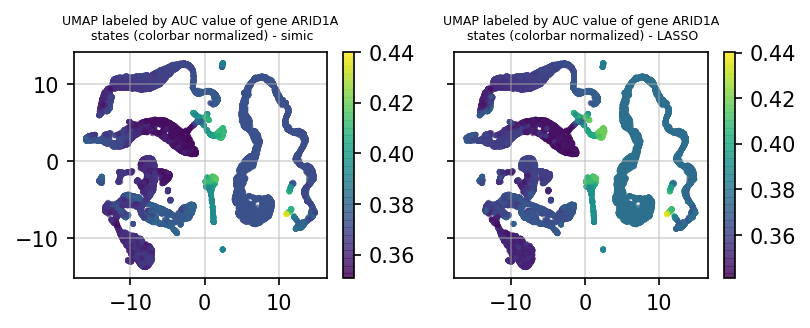

-------
ID3


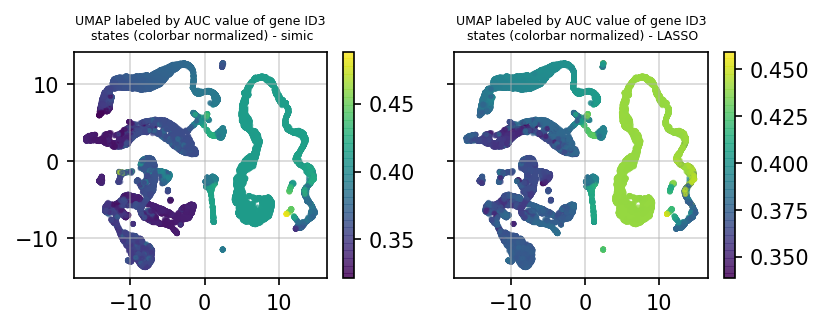

-------
RERE


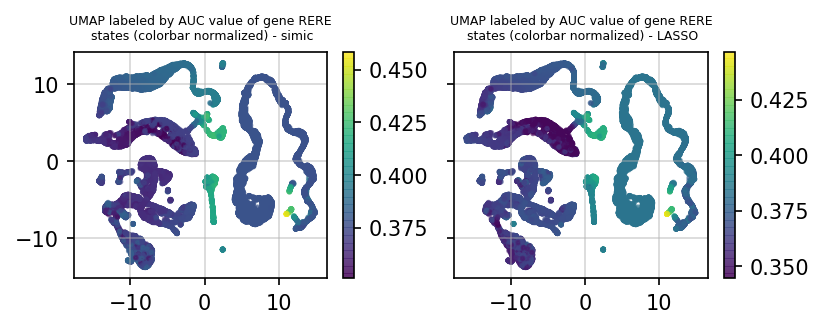

-------
GATAD1


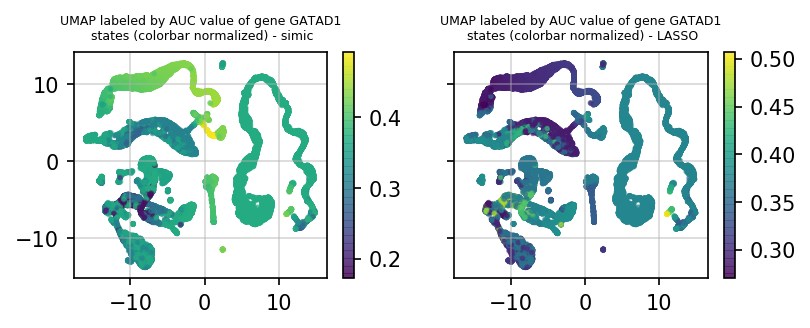

-------
DNAJC2


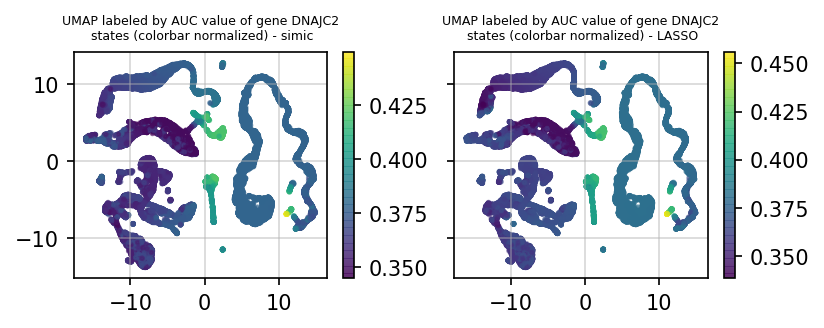

-------
MXD4


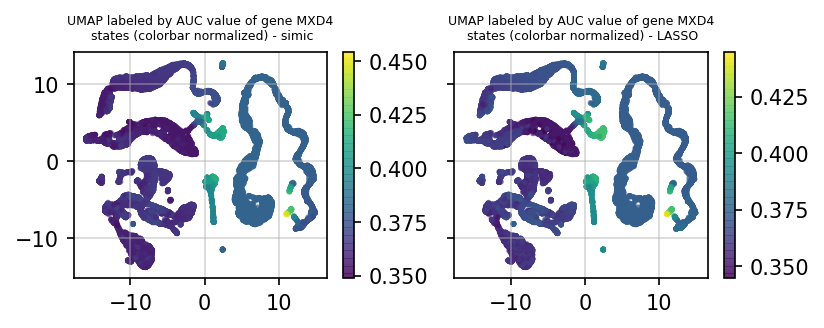

-------
LYAR


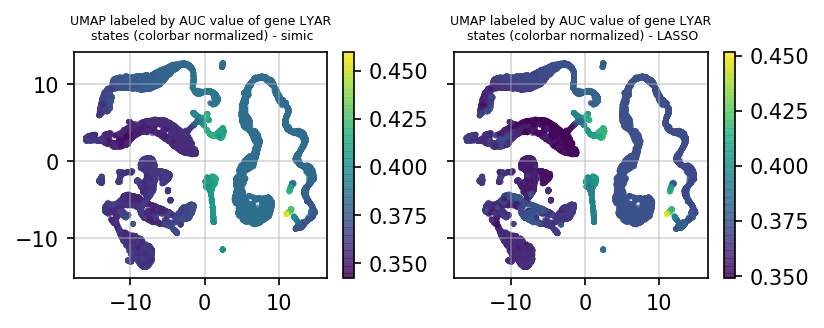

-------
KLF3


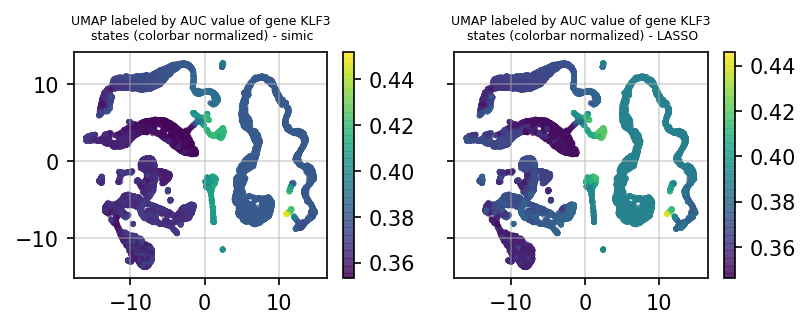

-------
CLOCK


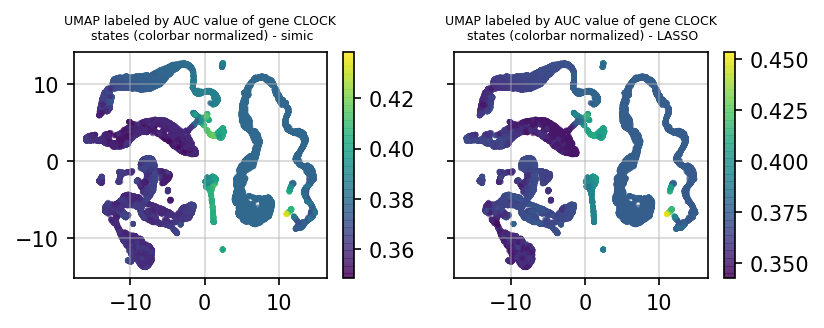

-------
HOPX


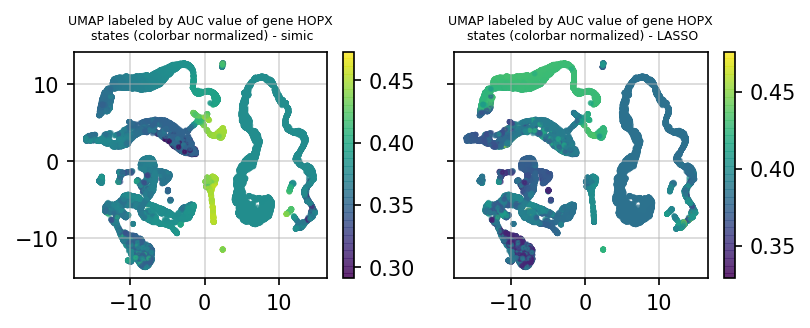

-------
REST


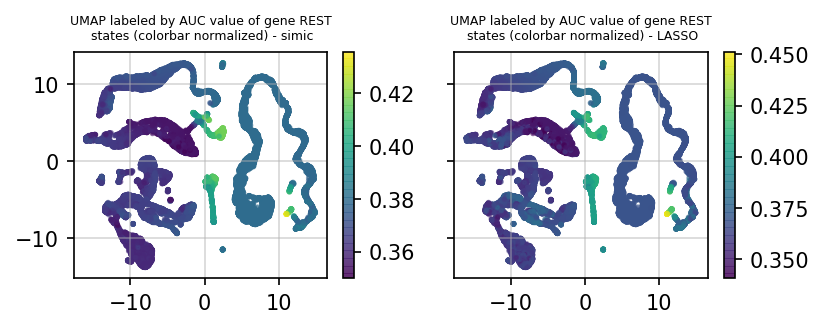

-------
TBX3


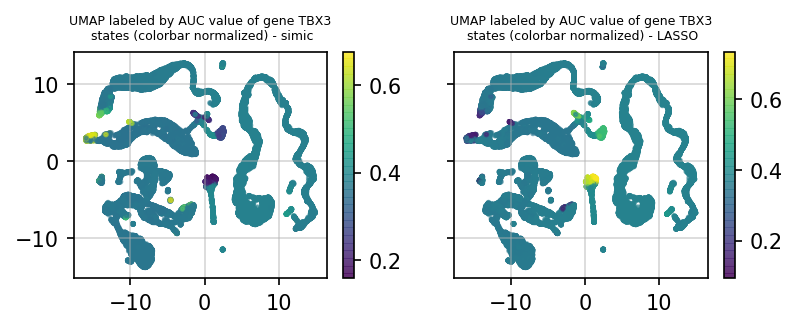

-------
CUX2


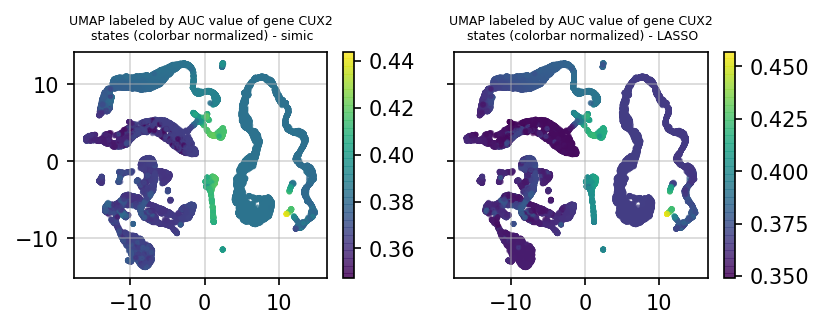

-------
MLXIPL


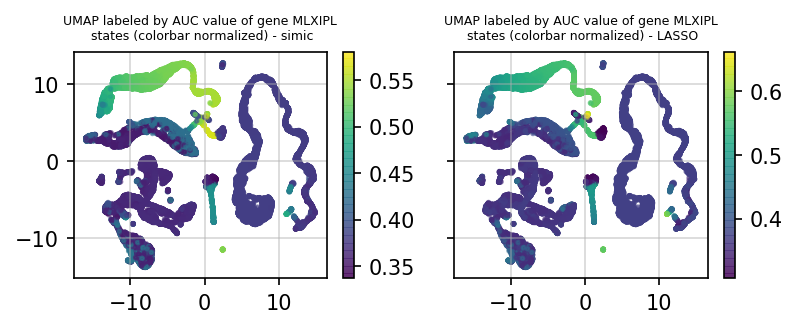

-------
CUX1


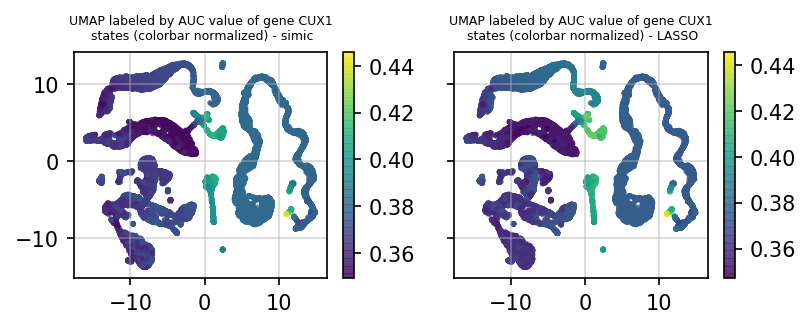

-------
ZKSCAN1


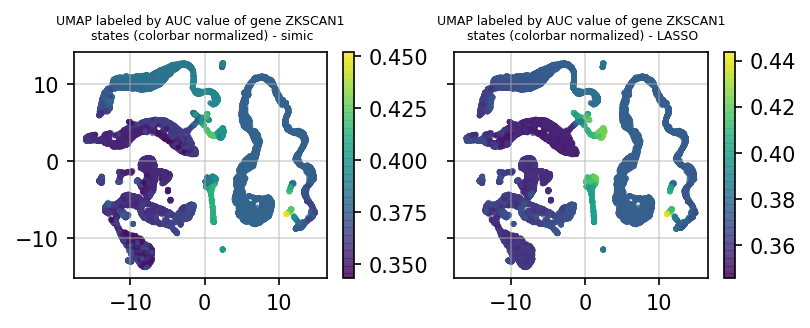

-------
GTF3A


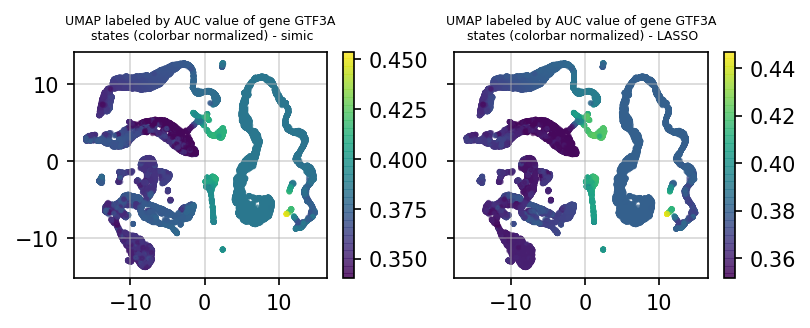

-------
CREB3L2


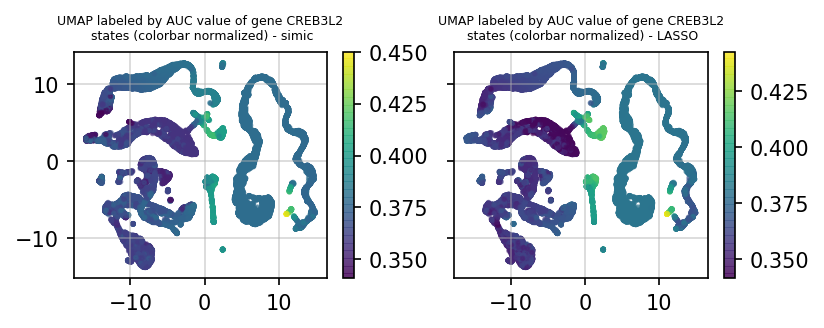

-------
KLF15


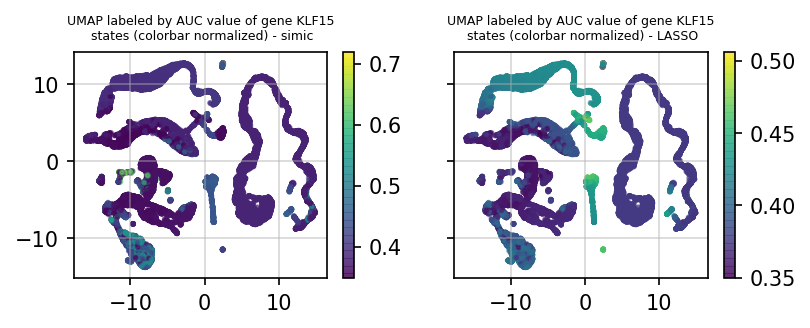

-------
FOXP1


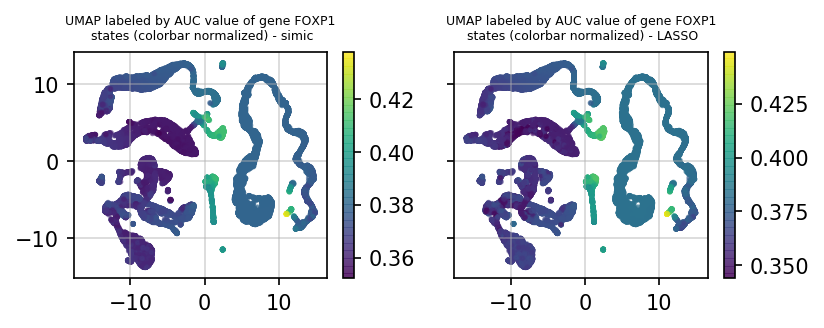

-------
BHLHE40


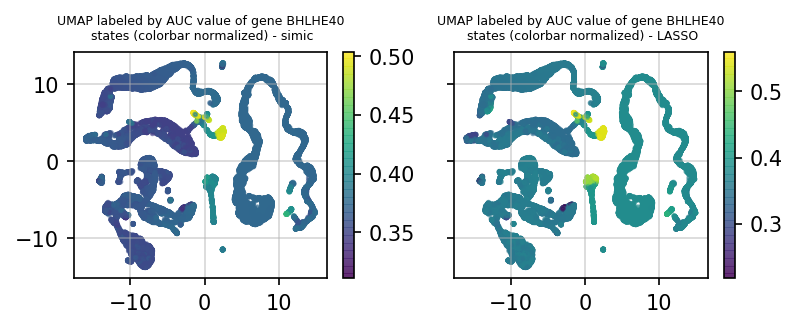

-------
ZFP637


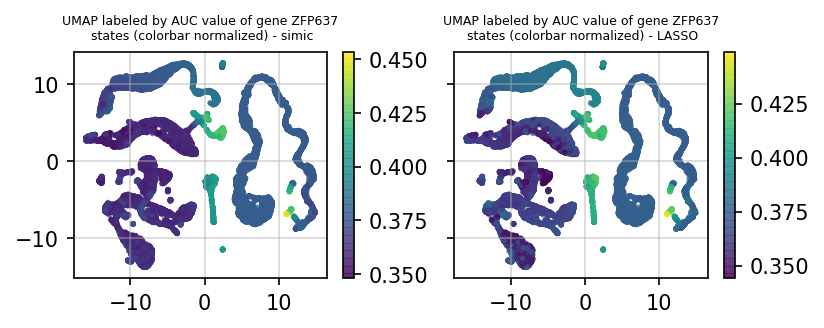

-------
KDM5A


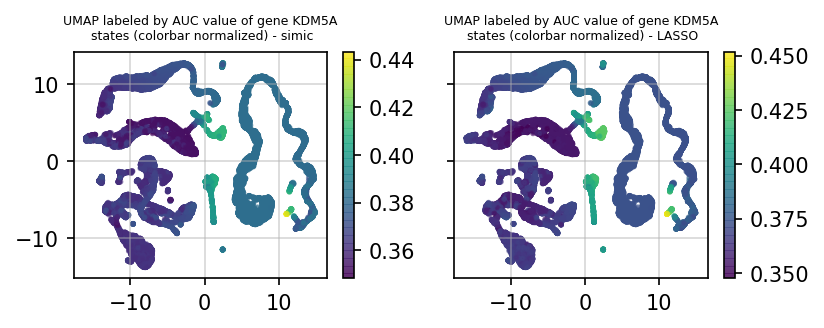

-------
YBX3


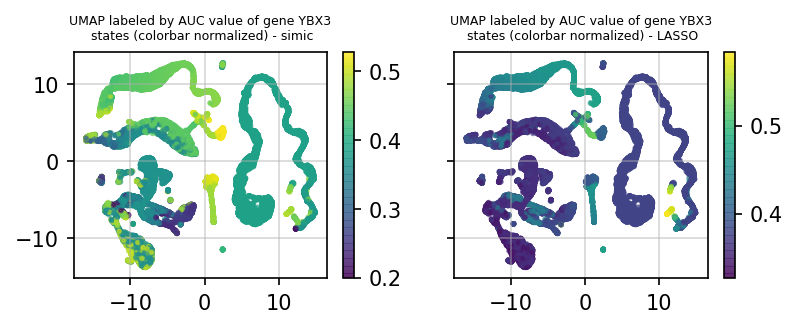

-------
CREBL2


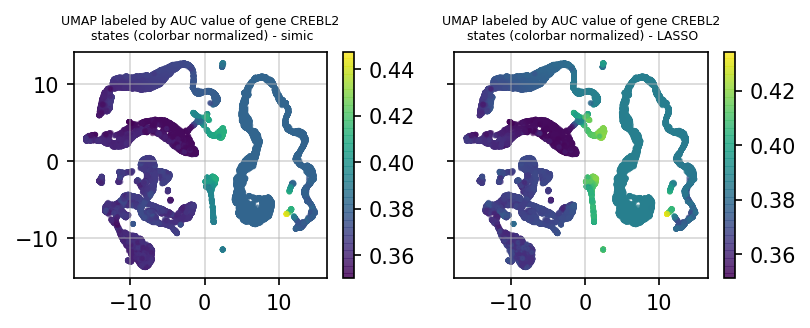

-------
AEBP2


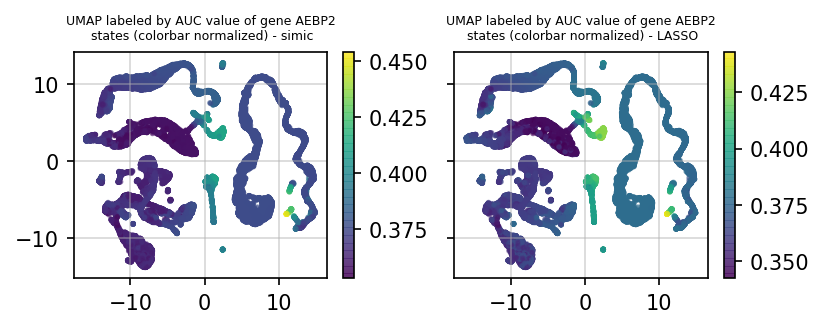

-------
SOX5


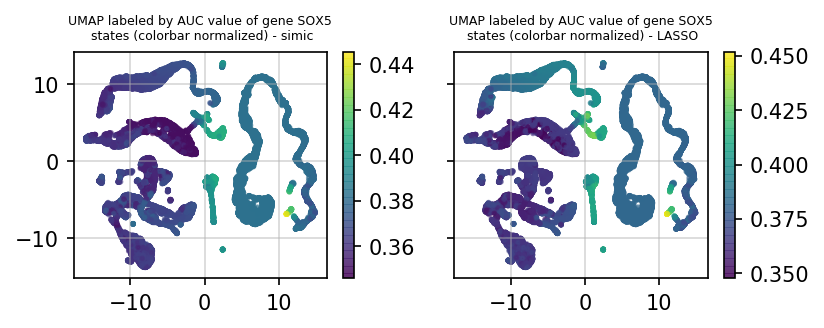

-------
PEG3


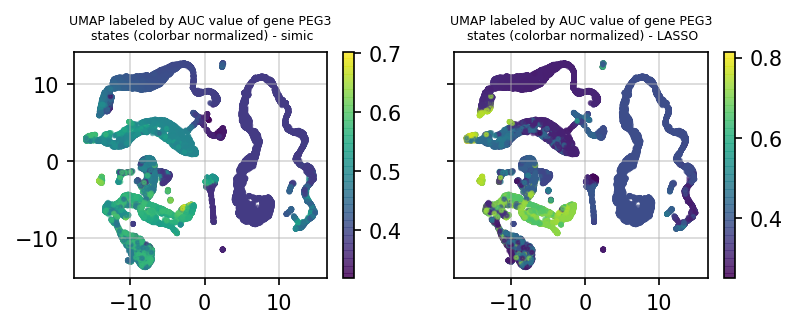

-------
FOXA3


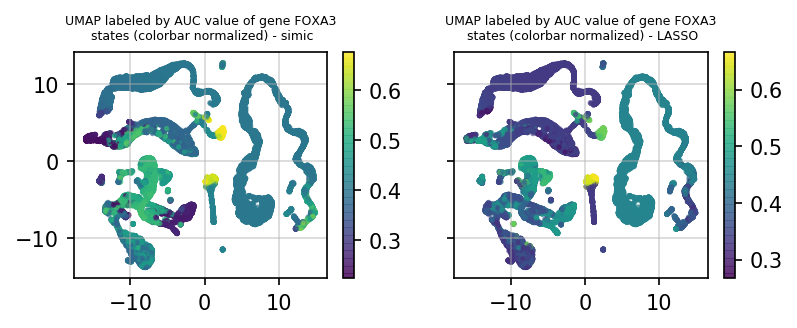

-------
BCL3


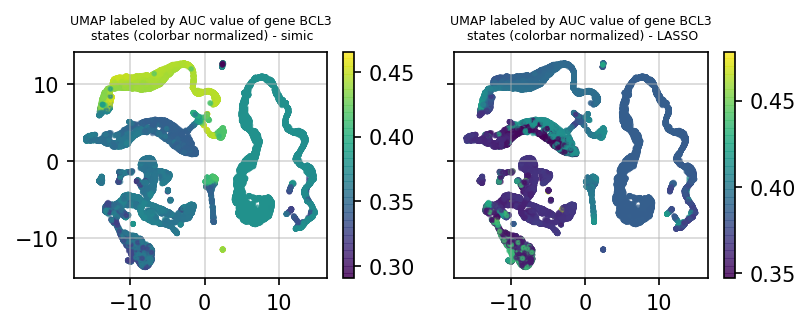

-------
NFKBIB


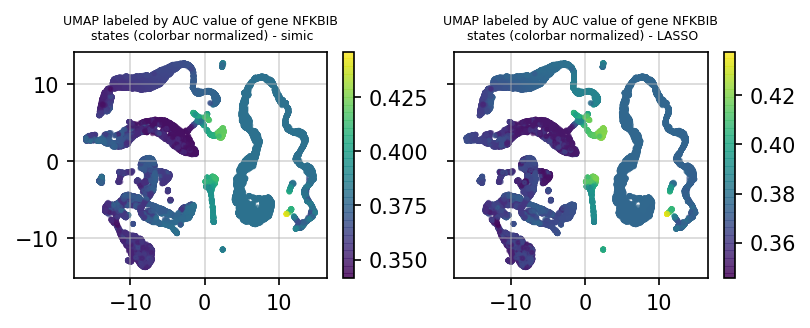

-------
USF2


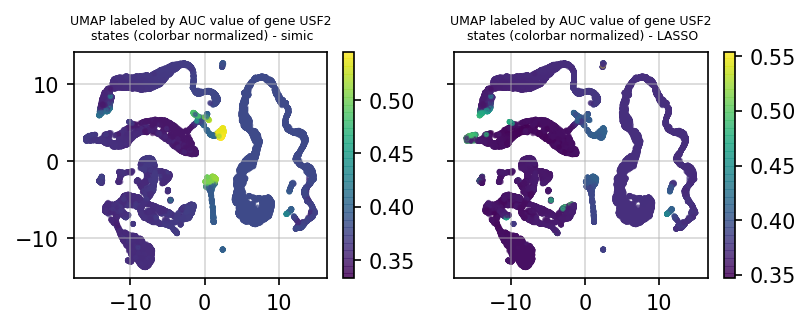

-------
CEBPG


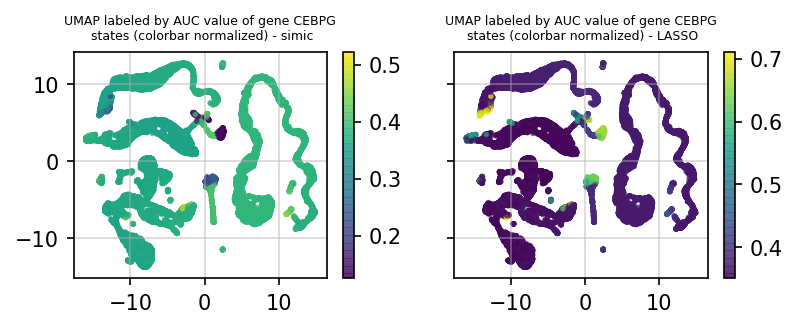

-------
CEBPA


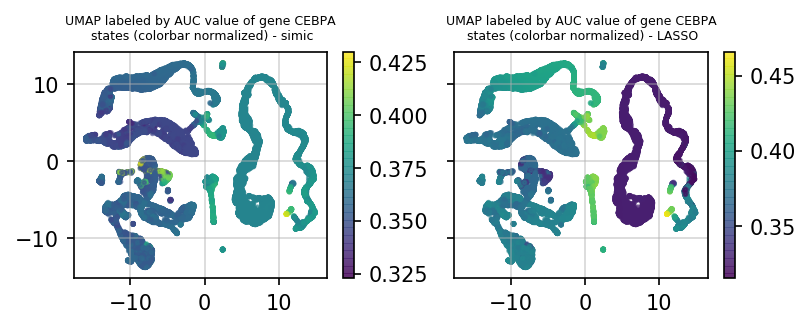

-------
ATF5


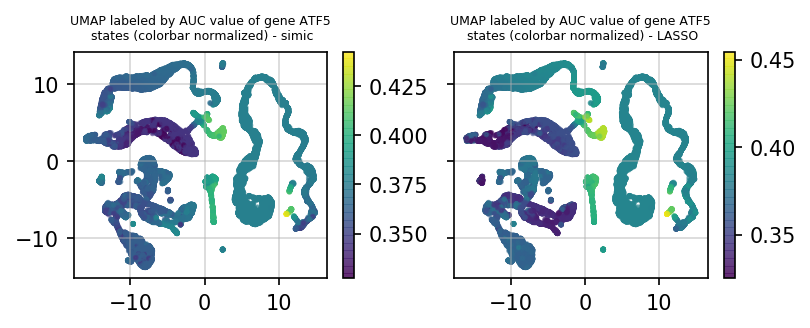

-------
IRF3


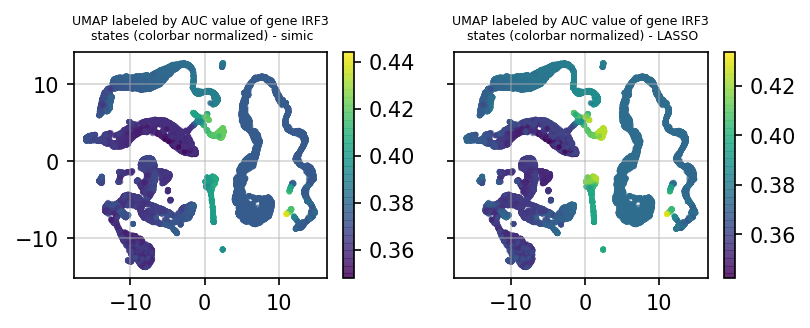

-------
DBP


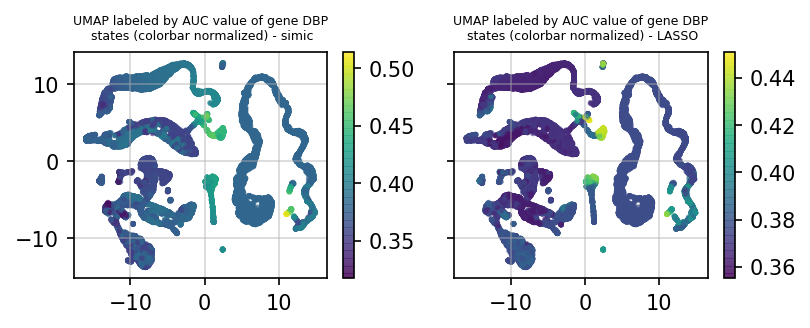

-------
KLF13


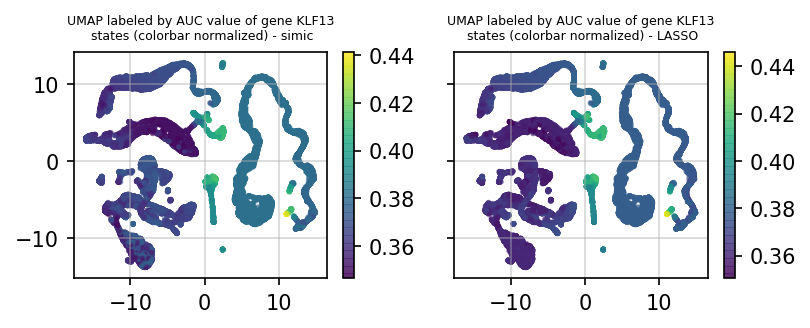

-------
MEF2A


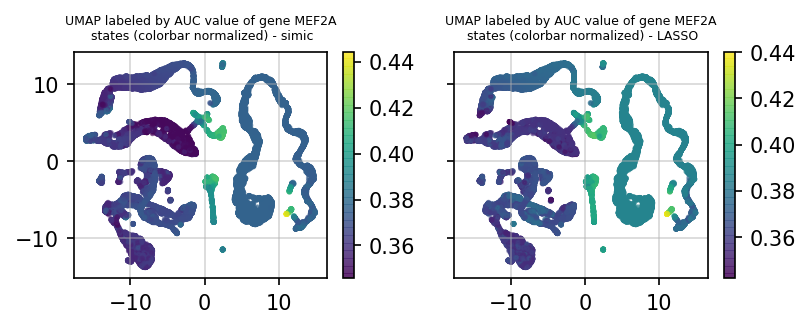

-------
NR2F2


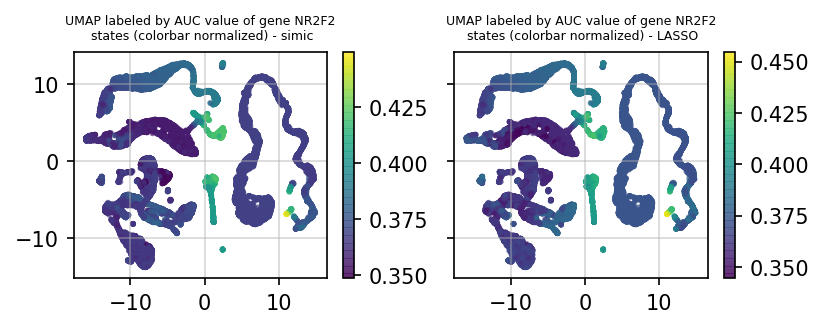

-------
MAZ


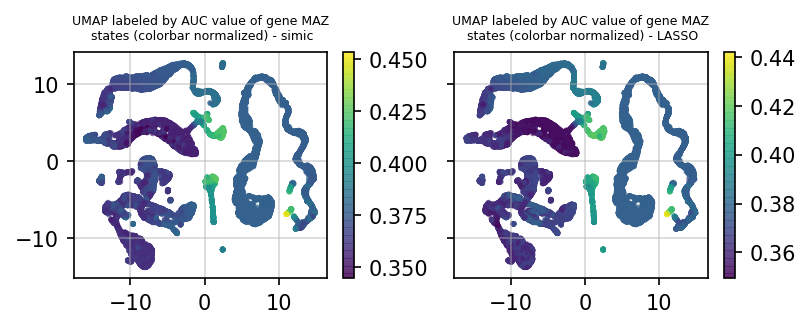

-------
IRF7


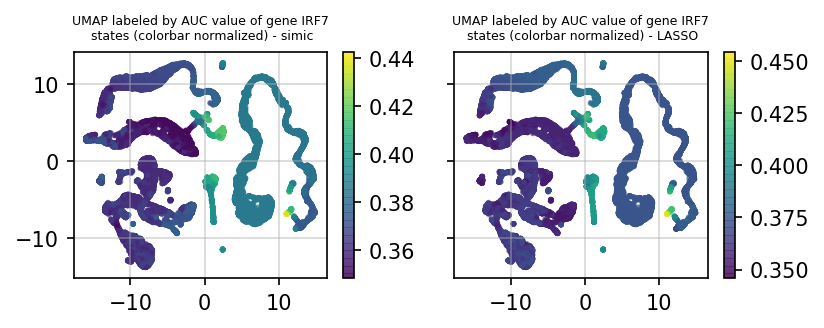

-------
FOXO3


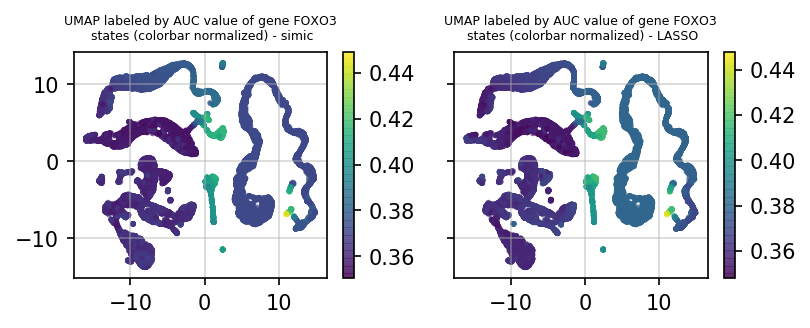

-------
HSF2


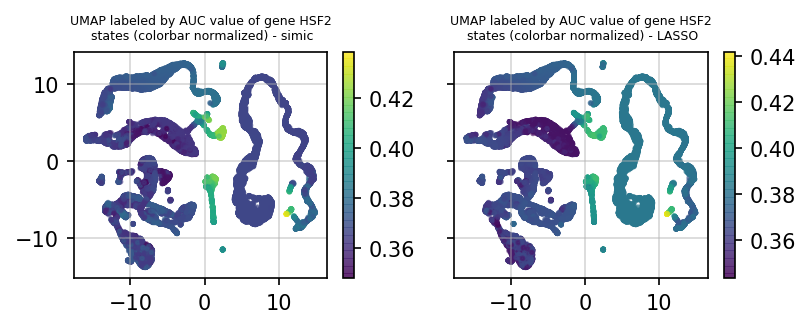

-------
ARID5B


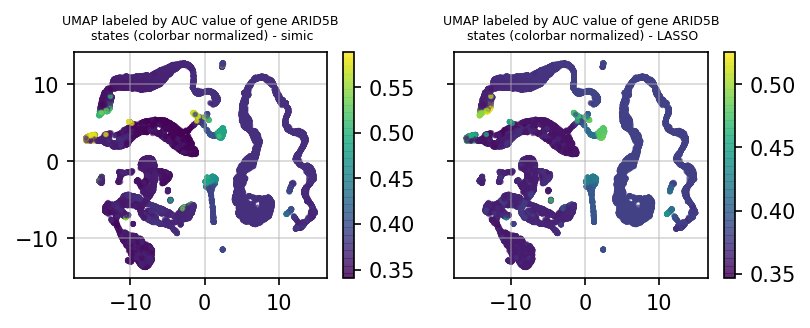

-------
TFAM


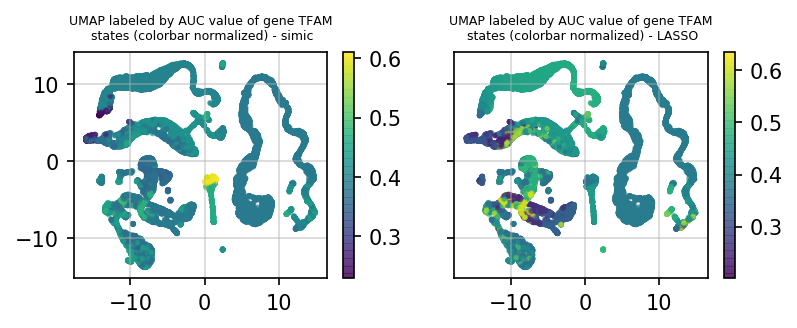

-------
CREB3L3


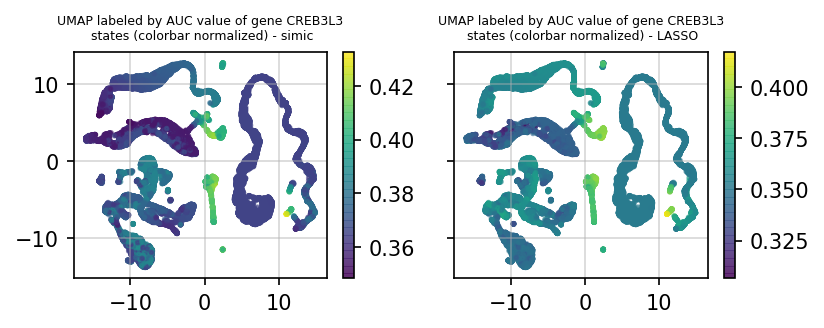

-------
ZBTB7A


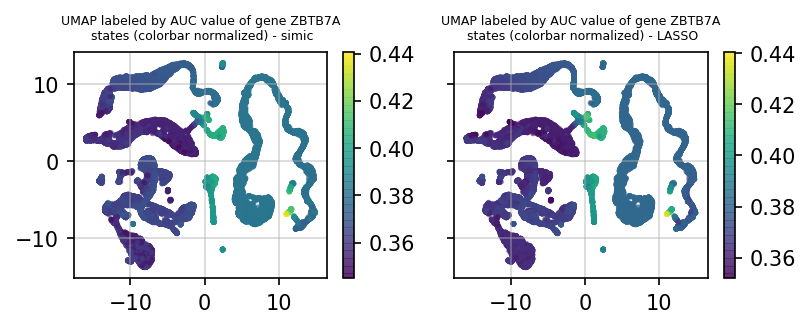

-------
HMG20B


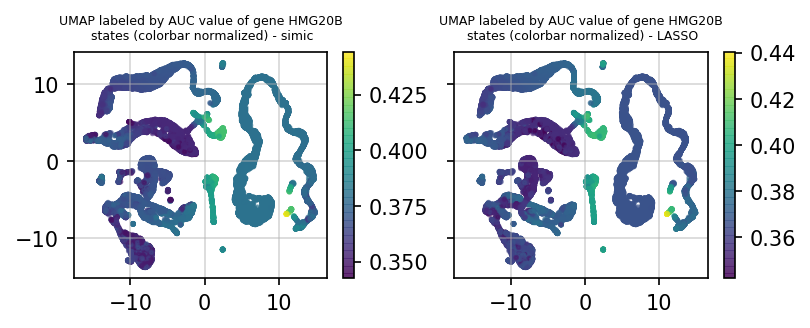

-------
NFIC


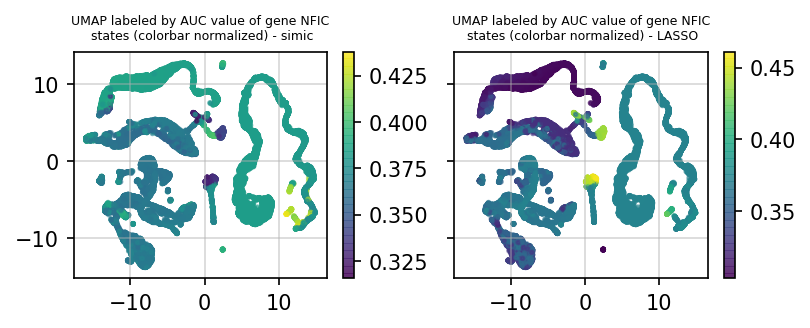

-------
NFYB


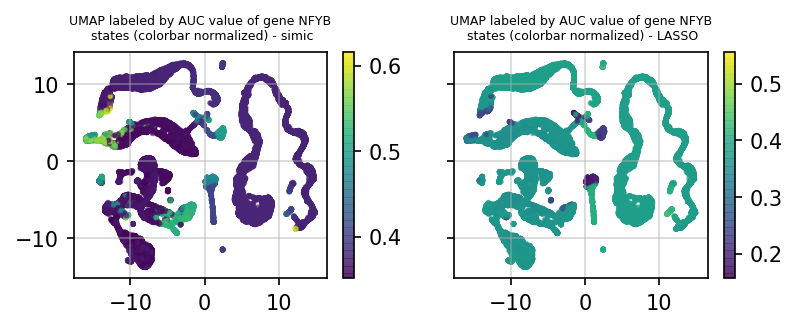

-------
NR1H4


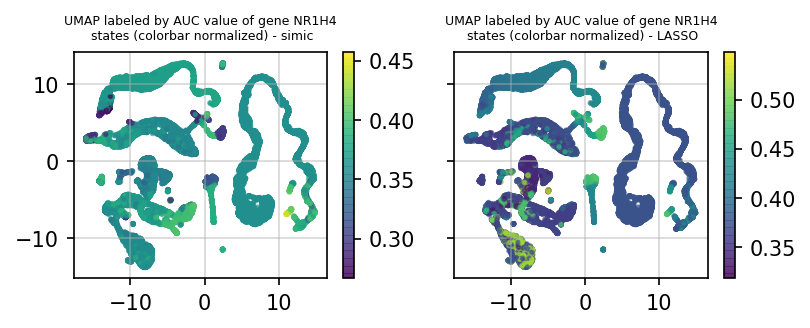

-------
THAP2


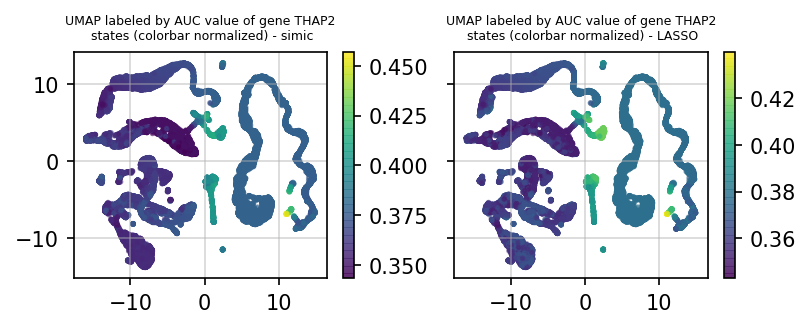

-------
STAT6


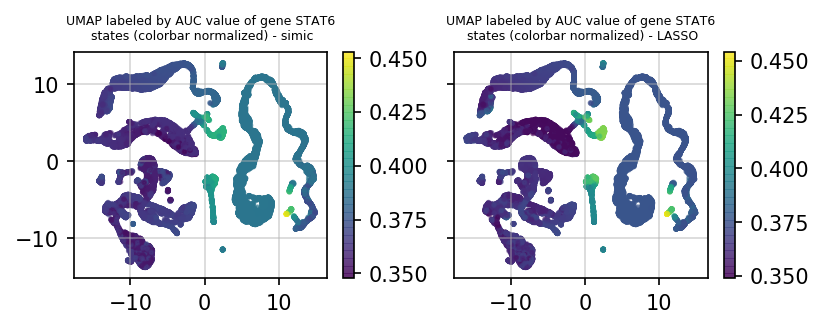

-------
STAT2


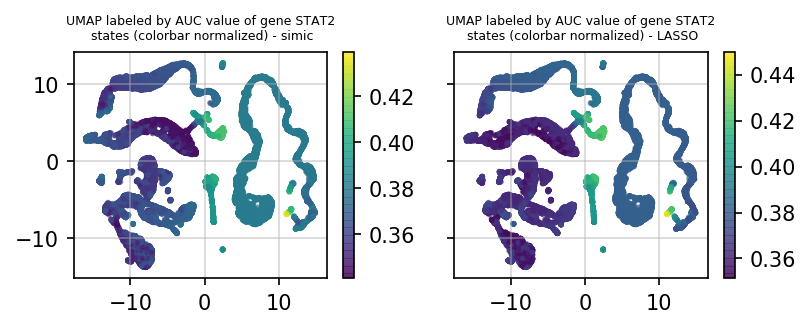

-------
SMARCC2


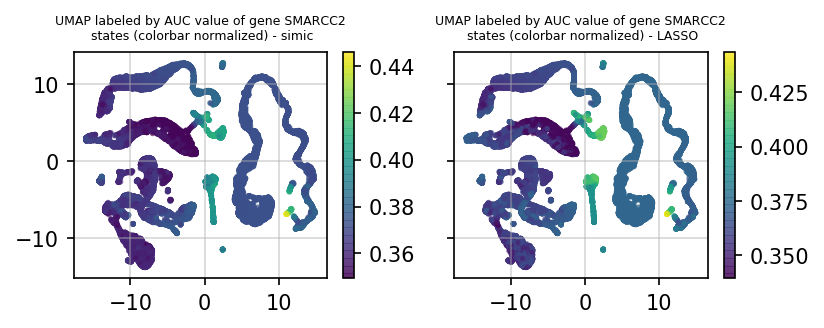

-------
TFDP1


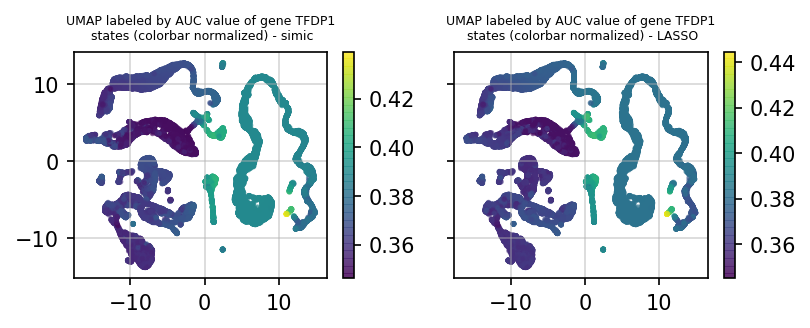

-------
IRF2


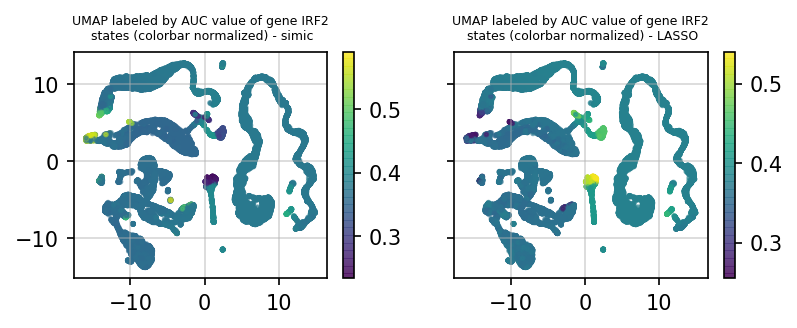

-------
GATAD2A


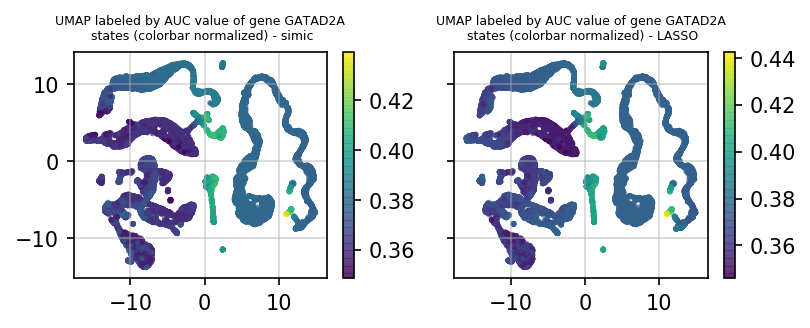

-------
JUND


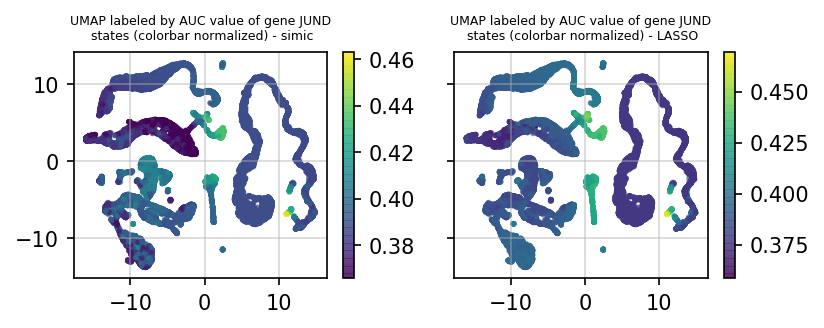

-------
NR2F6


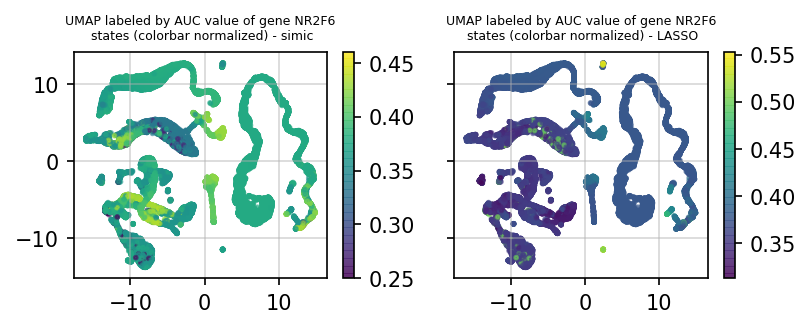

-------
SMAD1


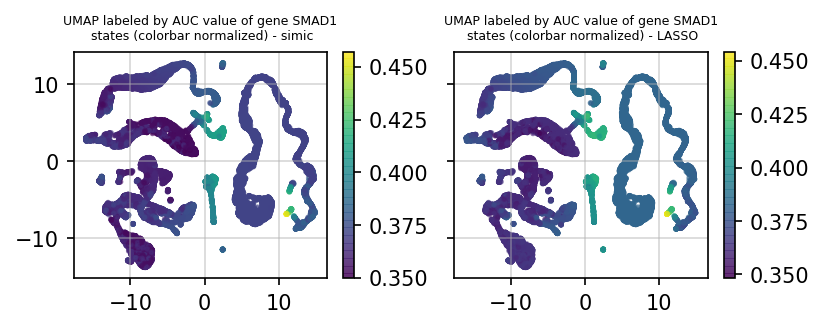

-------
SMARCA5


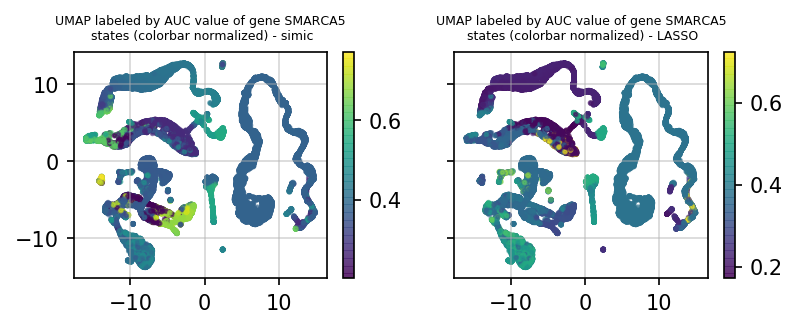

-------
NFIX


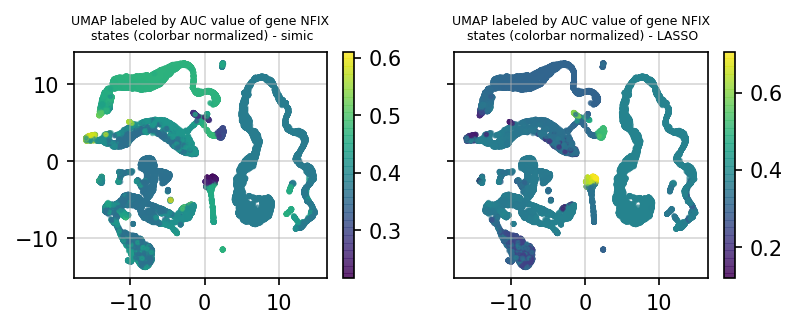

-------
JUNB


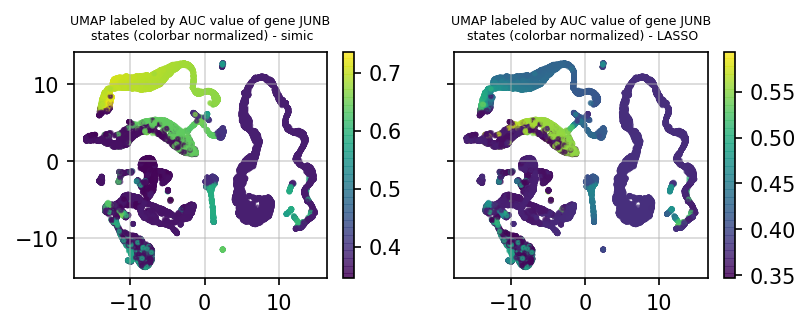

-------
SALL1


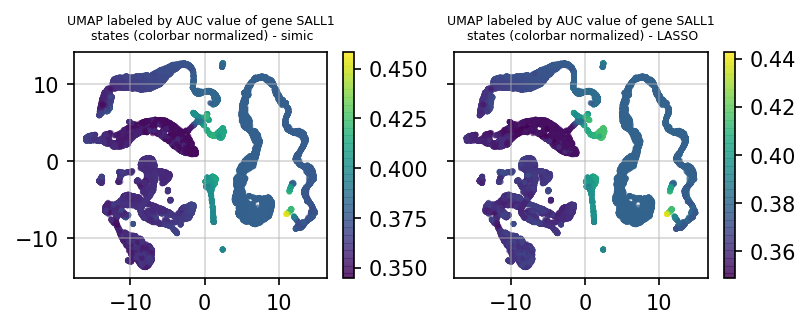

-------
CTCF


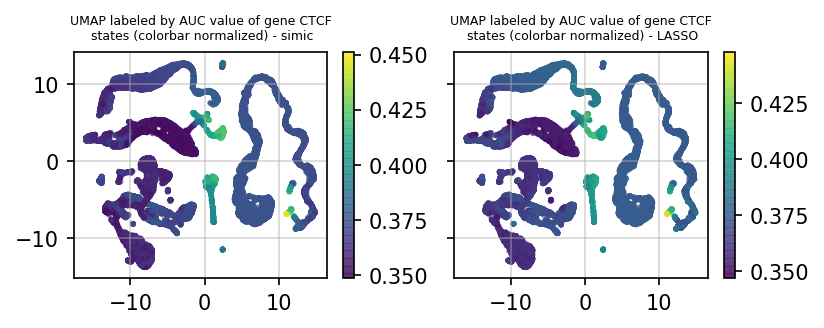

-------
NFATC3


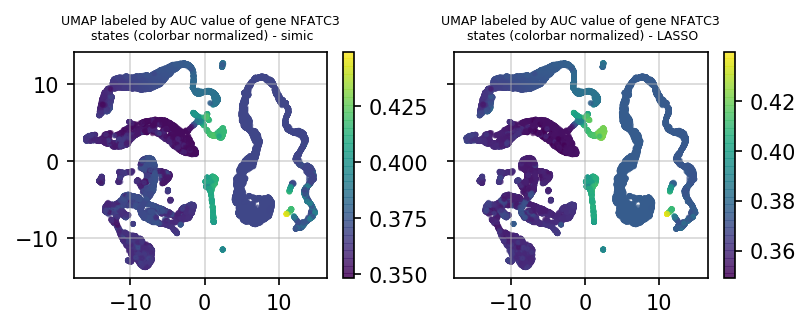

-------
ZFHX3


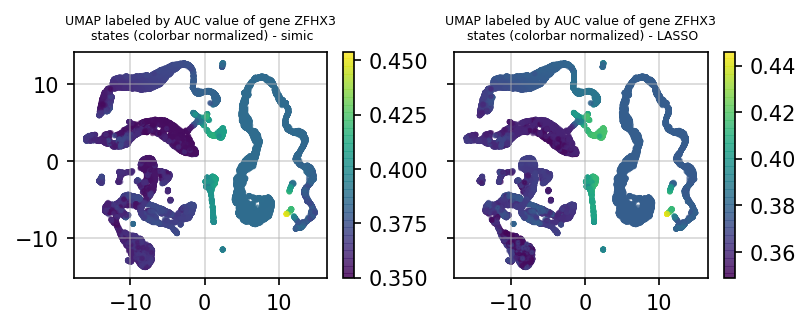

-------
MAF


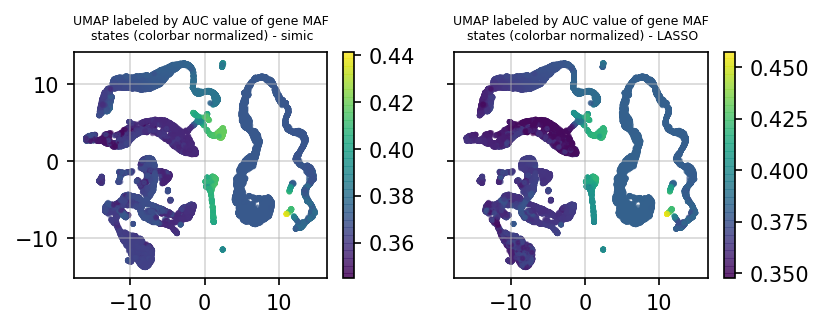

-------
ZFPM1


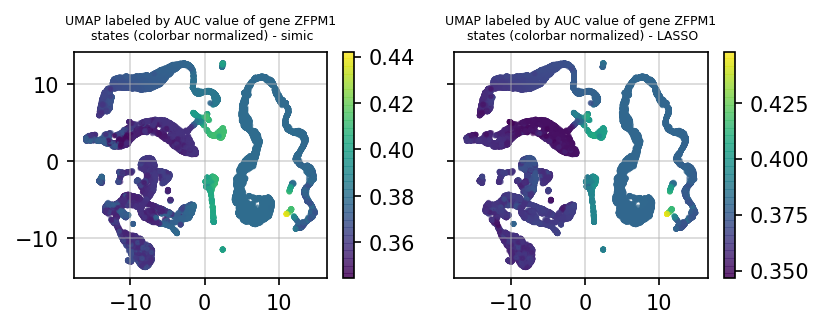

-------
TCF25


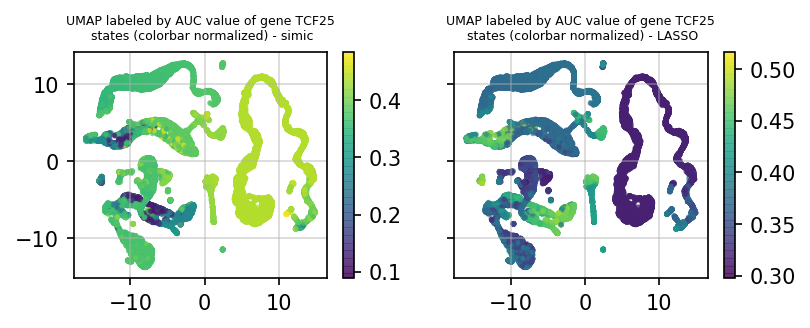

-------
THRB


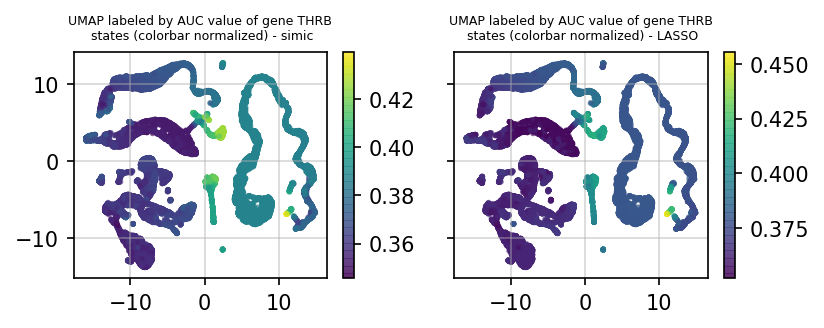

-------
NR1D2


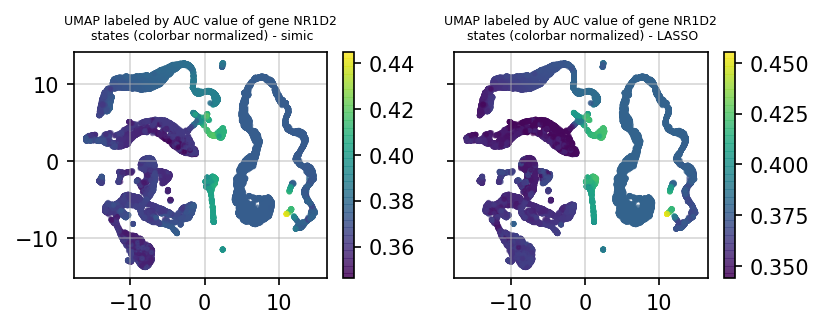

-------
PBRM1


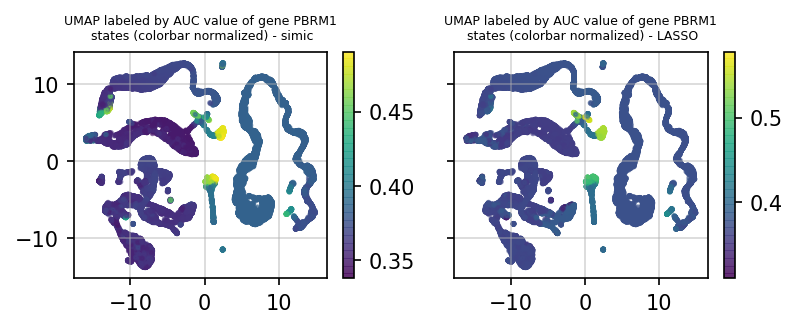

-------
TOX4


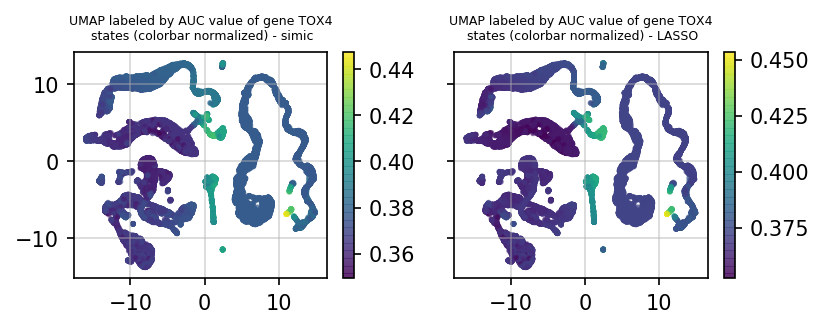

-------
IRF9


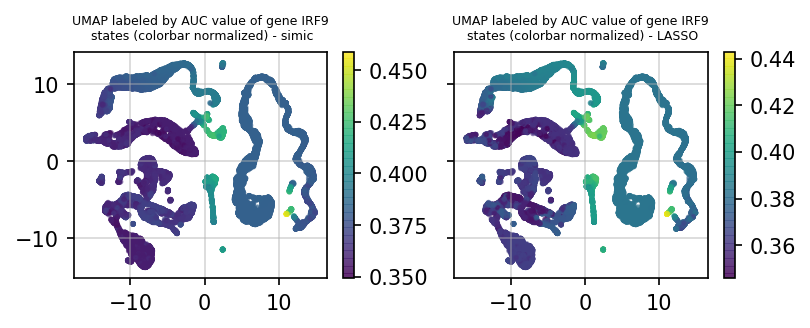

-------
TSC22D1


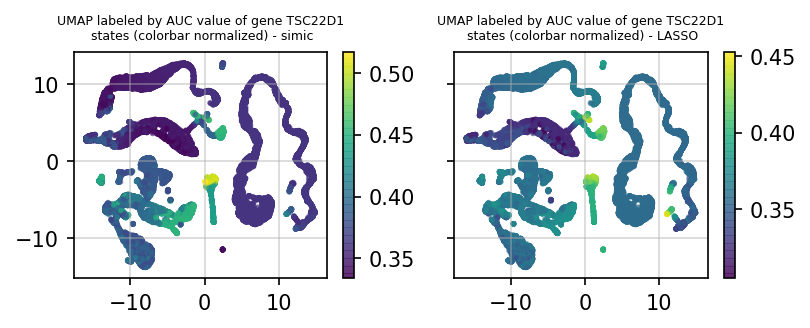

-------
ELF1


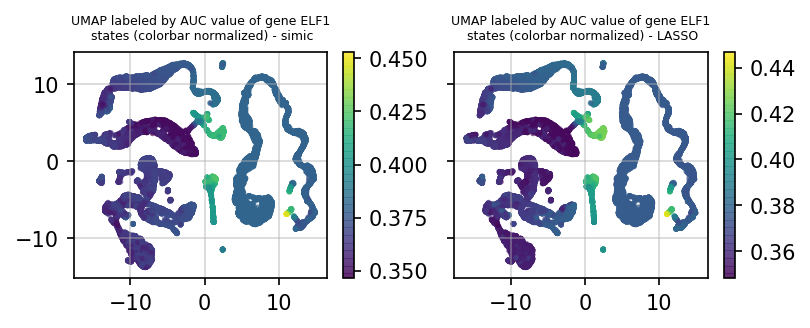

-------
KLF12


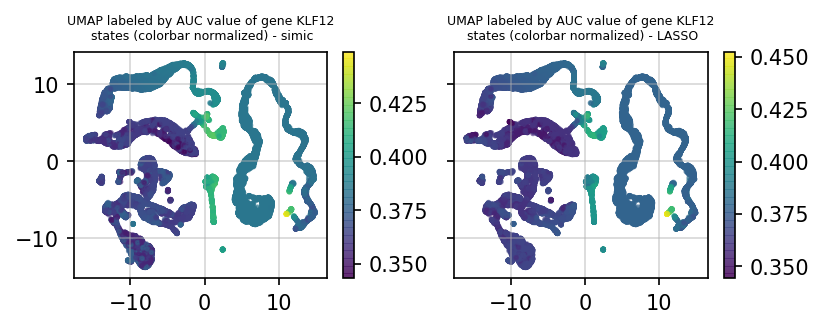

-------
DNMT1


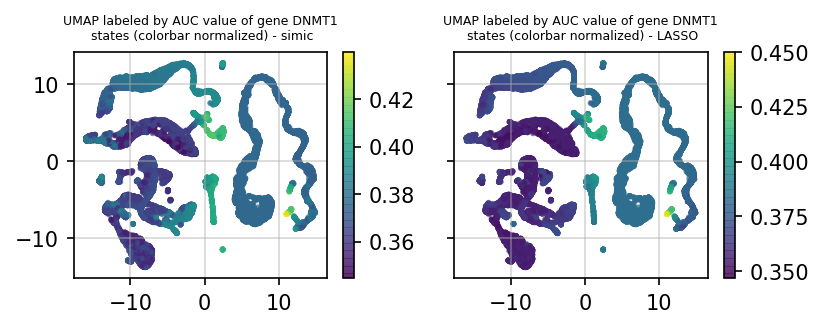

-------
ZBTB44


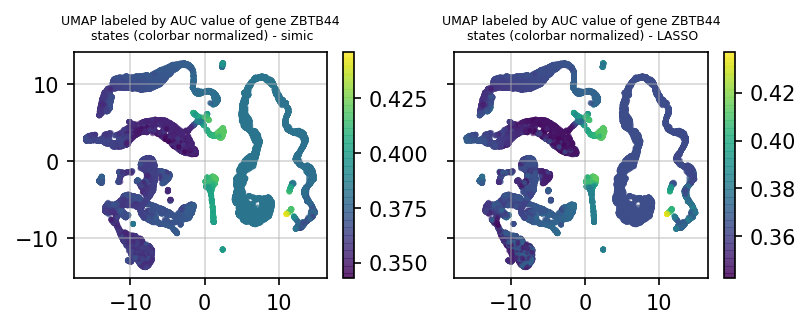

-------
RORA


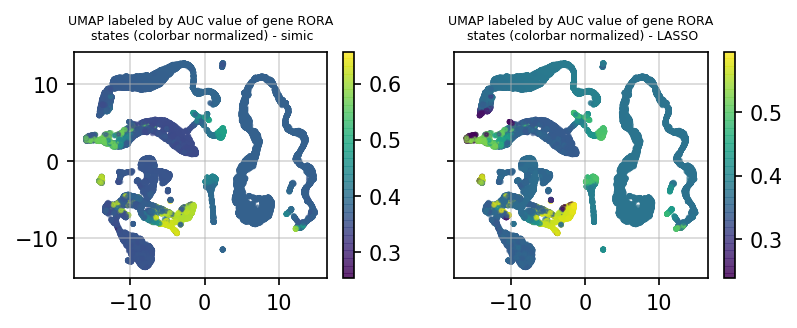

-------
ONECUT1


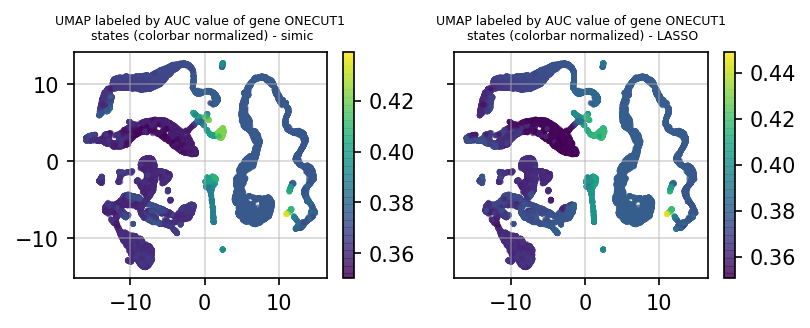

-------
TFDP2


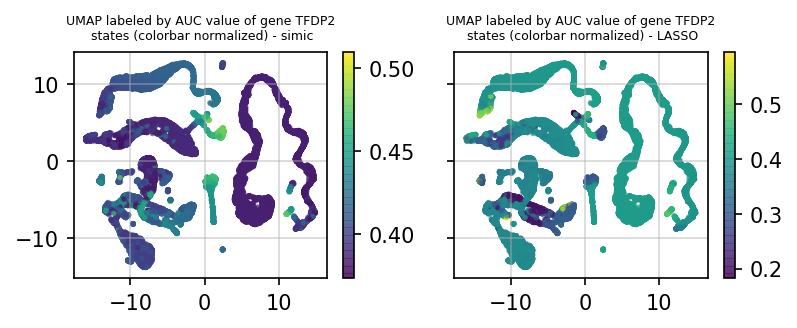

-------
ZBTB38


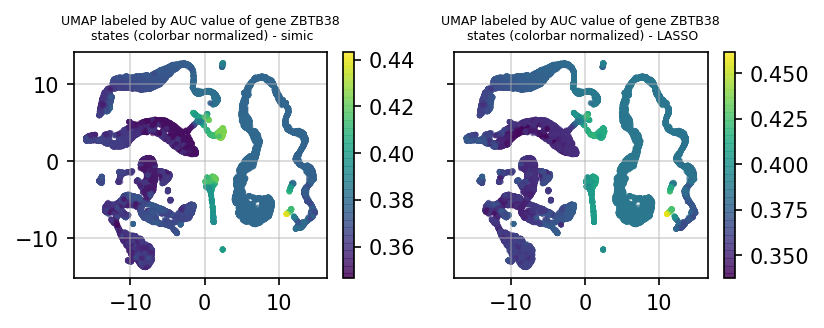

-------
SMARCC1


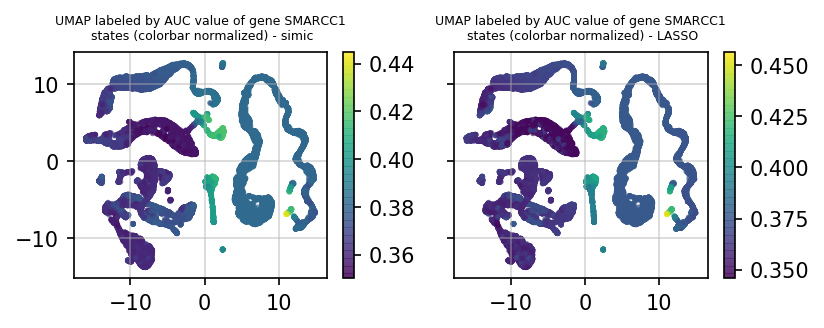

-------
LRRFIP2


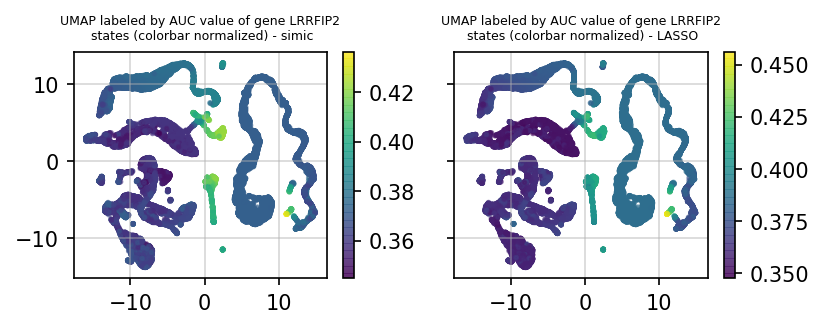

-------
UBP1


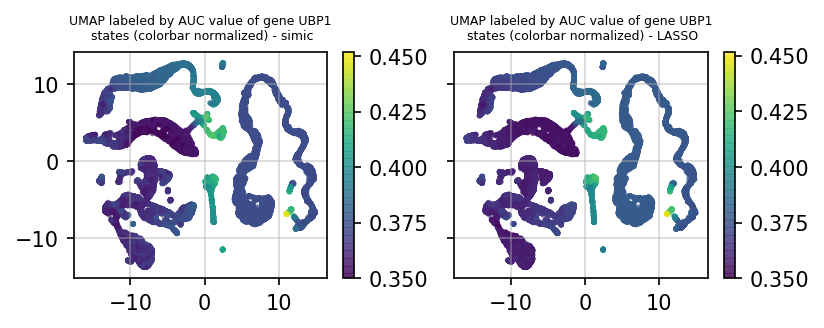

-------
CSRNP1


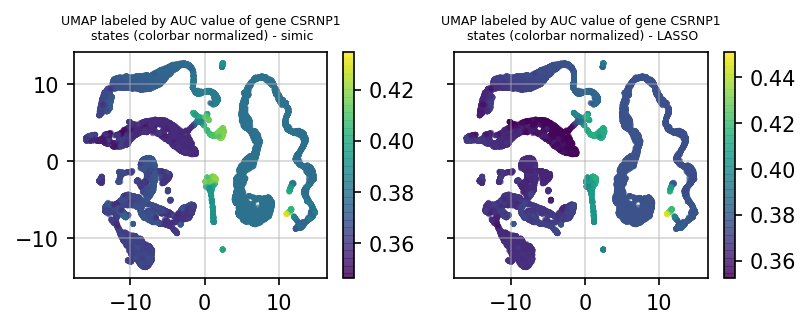

-------
XBP1


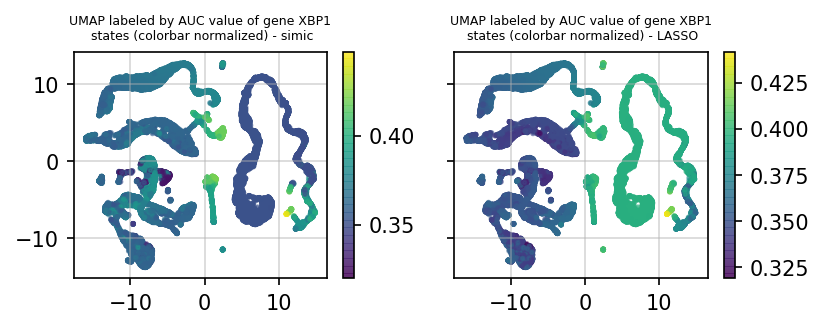

-------
PURB


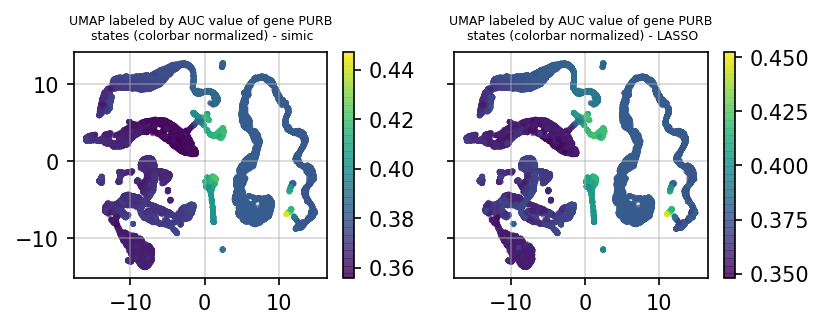

-------
SREBF1


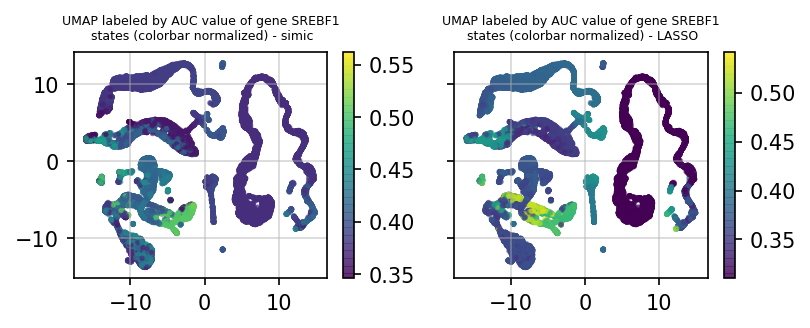

-------
NCOR1


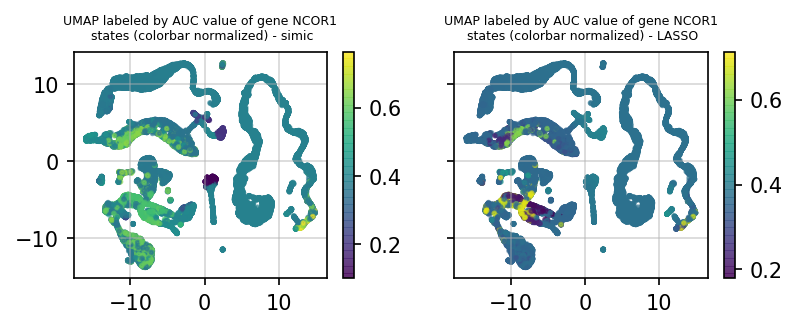

-------
HLF


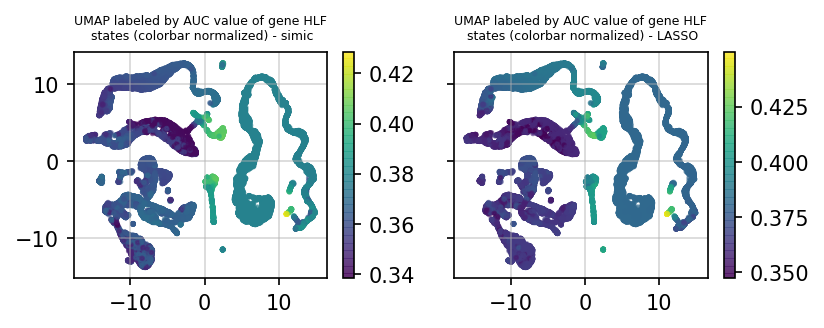

-------
NFE2L1


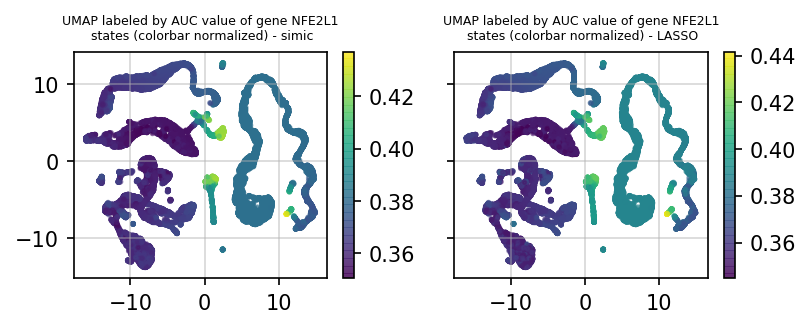

-------
NR1D1


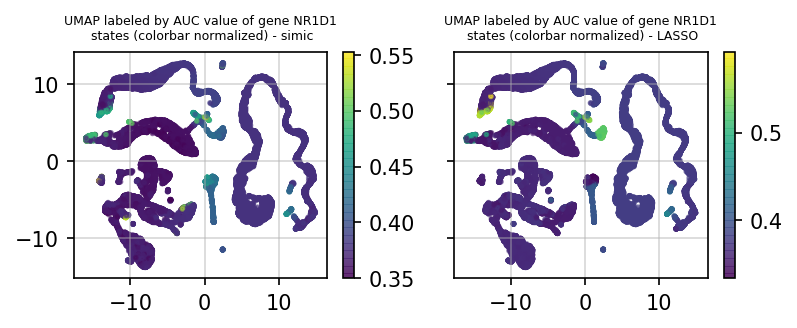

-------
RARA


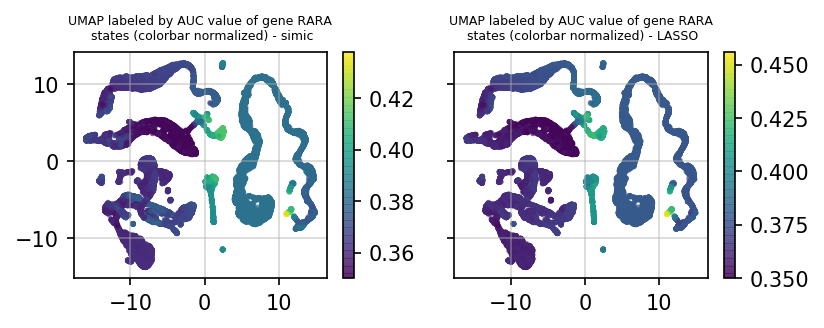

-------
SMARCE1


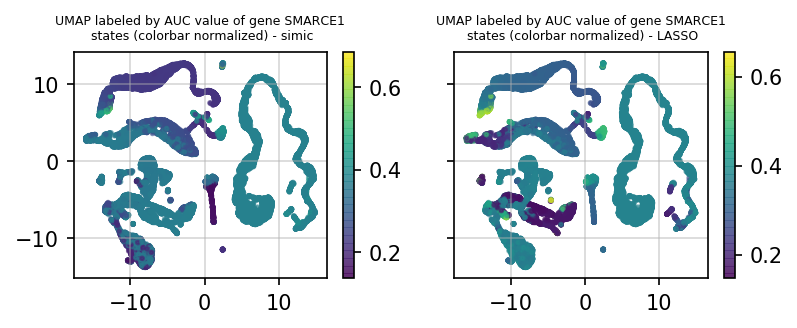

-------
STAT5B


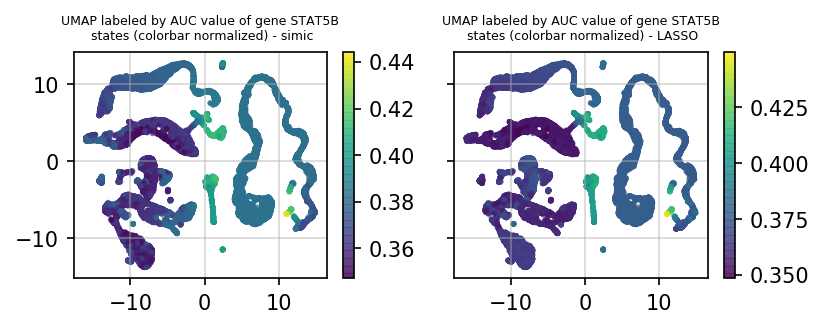

-------
STAT3


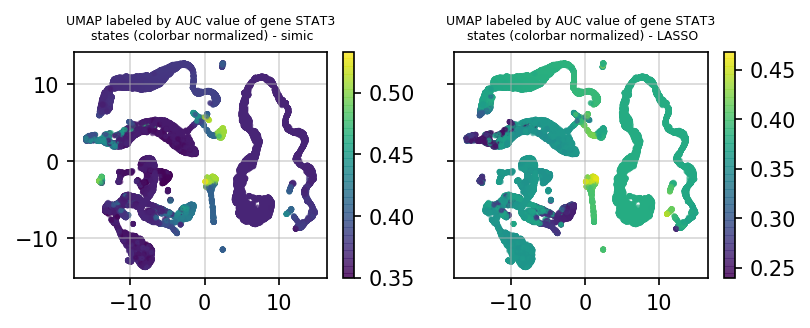

-------
MLX


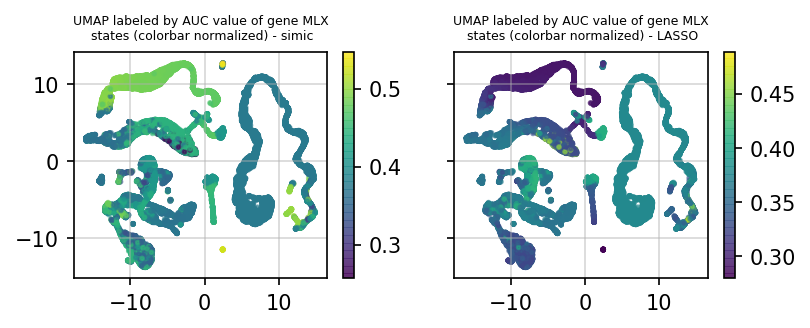

-------
UBTF


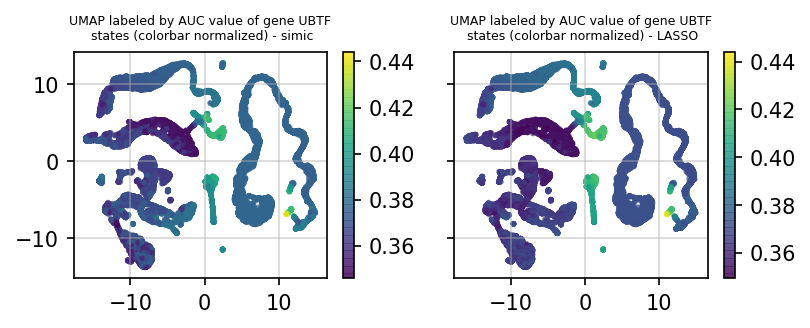

-------
SOX9


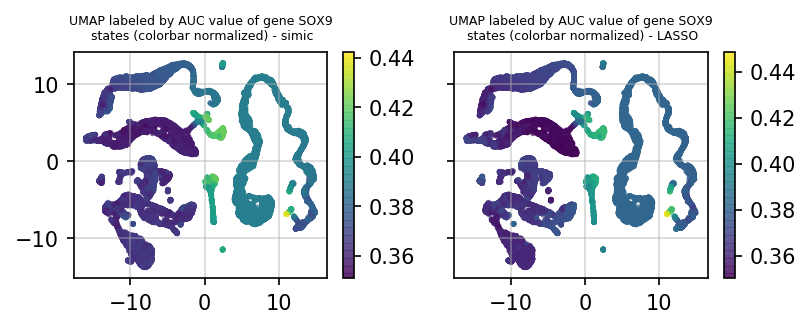

-------
MAFG


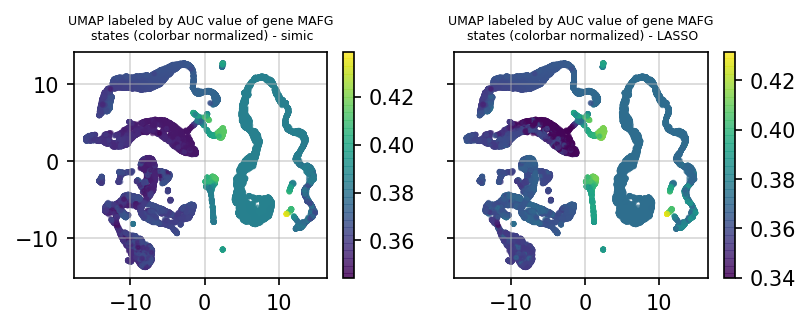

-------
ARID4B


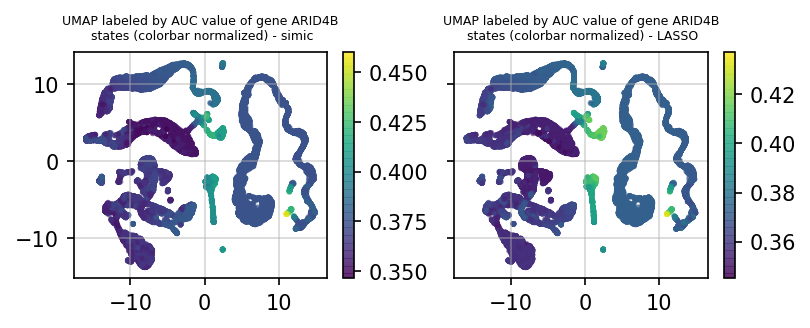

-------
ZKSCAN3


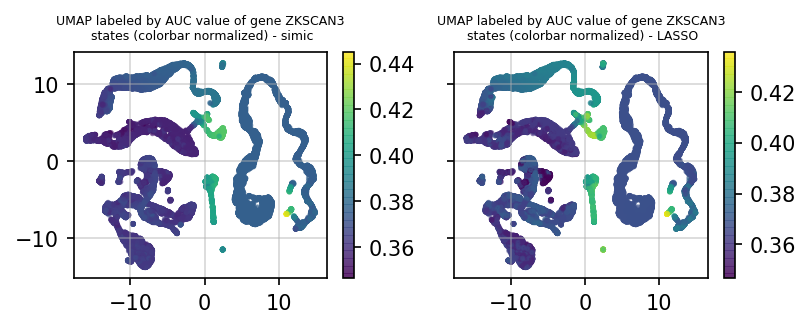

-------
FOXQ1


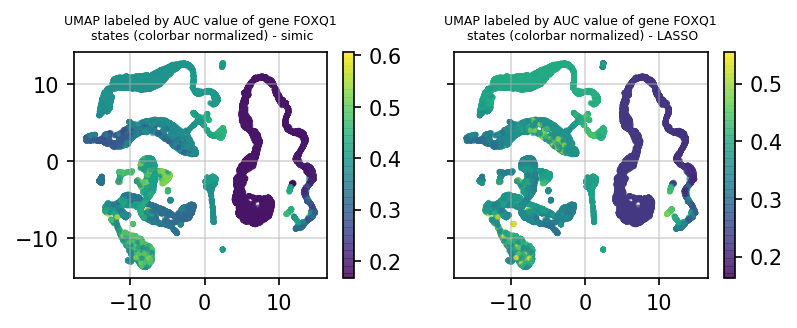

-------
RREB1


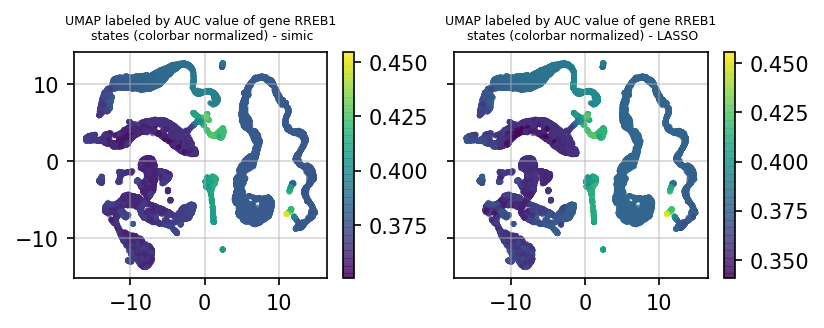

-------
MIER3


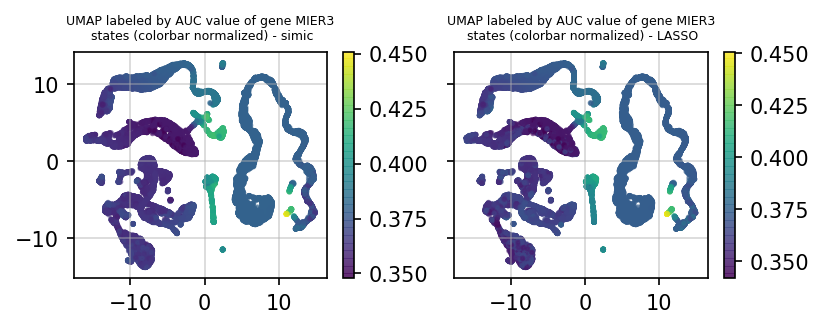

-------
ID2


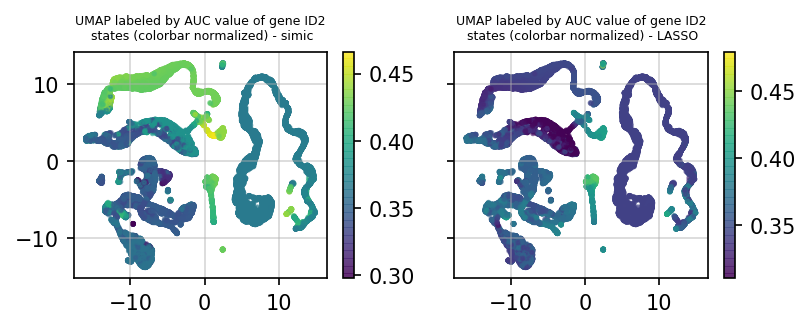

-------
HBP1


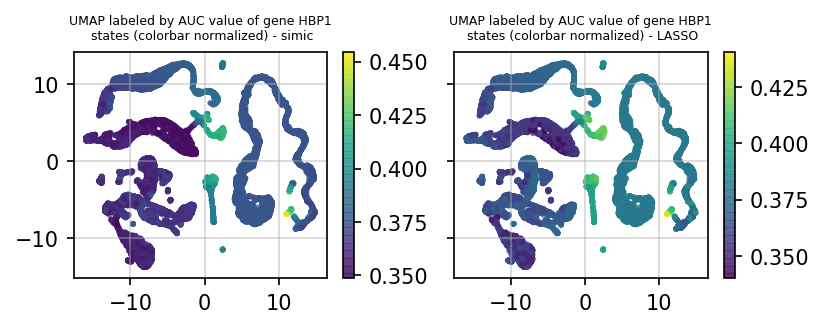

-------
AHR


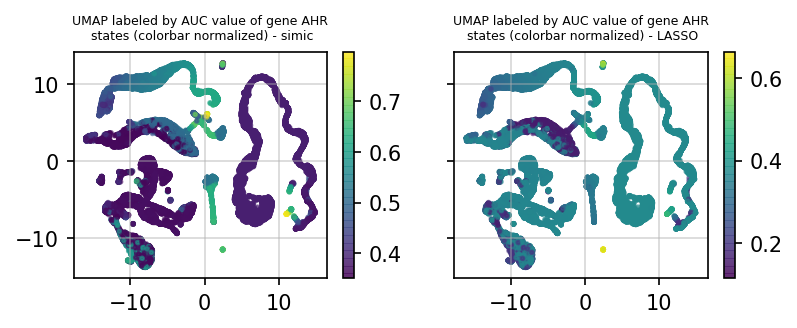

-------
NFKBIA


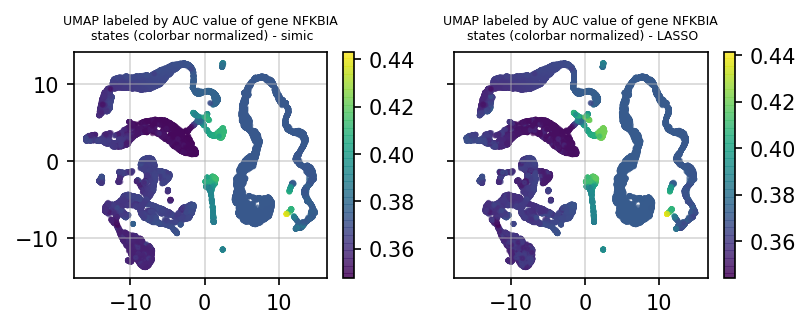

-------
FOXA1


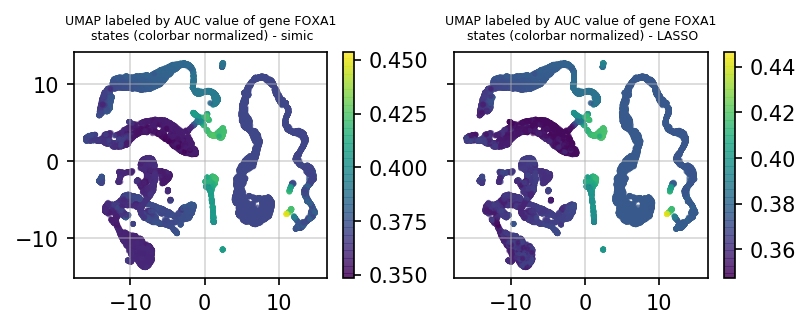

-------
HIF1A


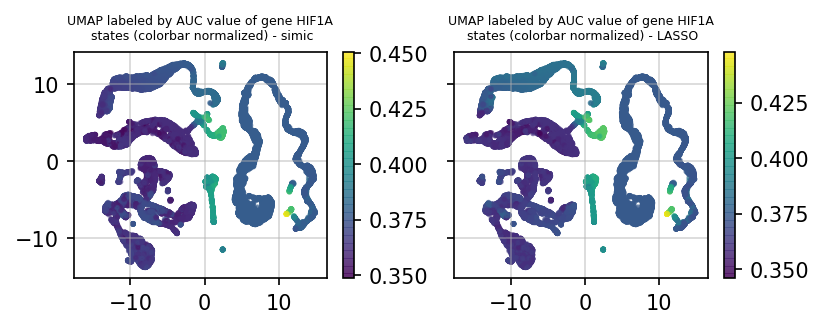

-------
FOXN3


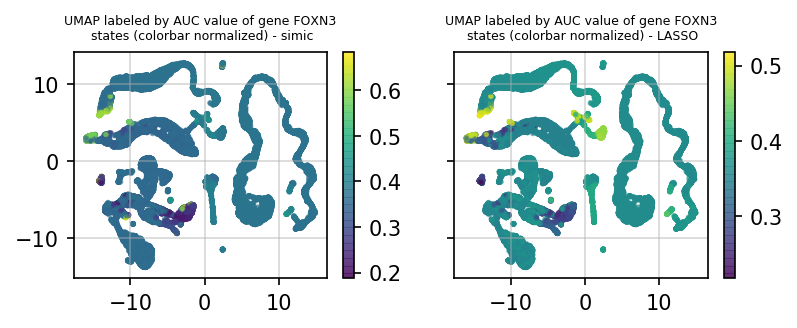

-------
YY1


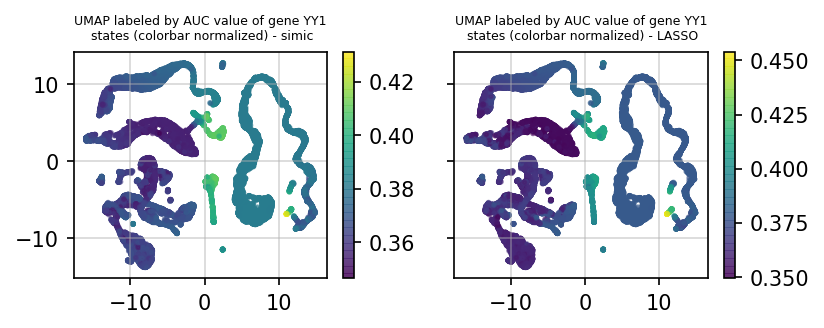

-------
RCOR1


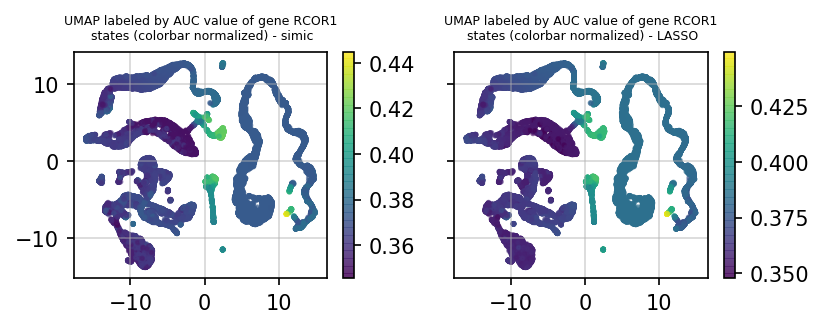

-------
KLF10


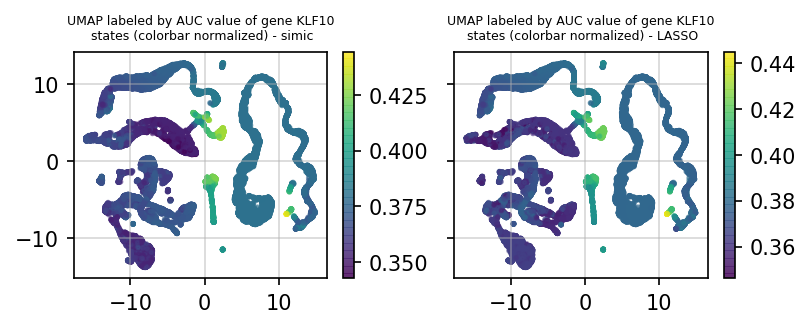

-------
ZHX1


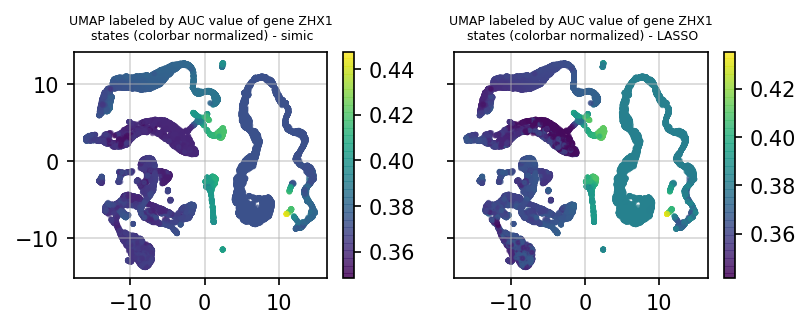

-------
ATF4


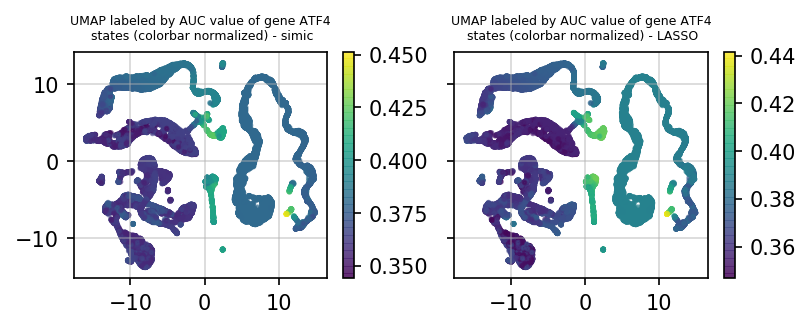

-------
TEF


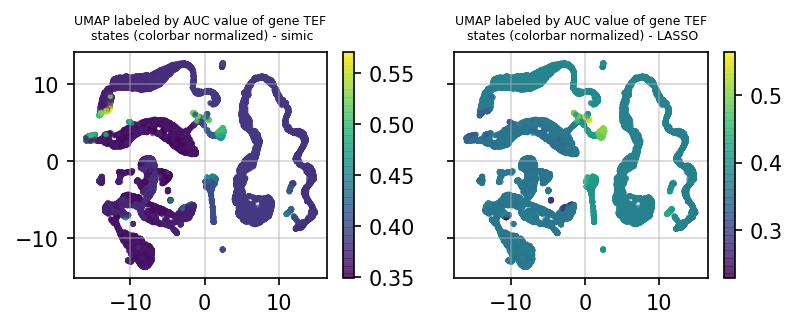

-------
PHF5A


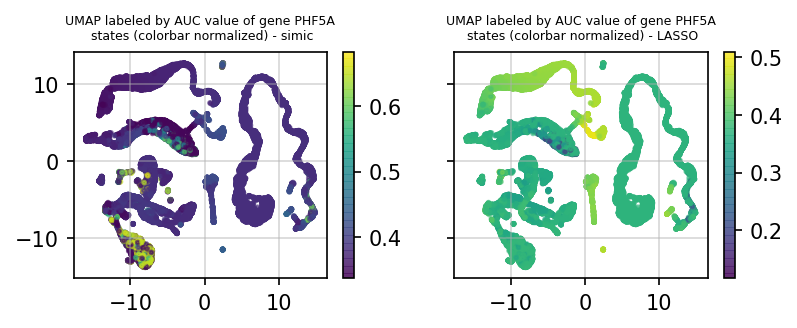

-------
SREBF2


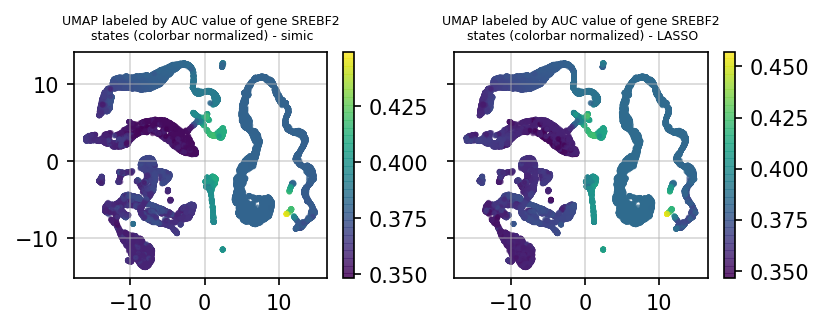

-------
PPARA


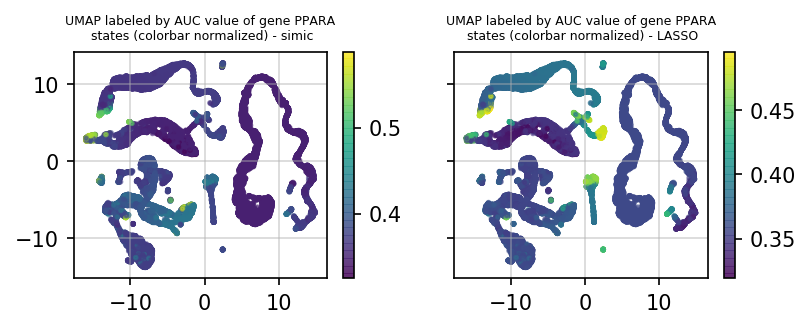

-------
ATF1


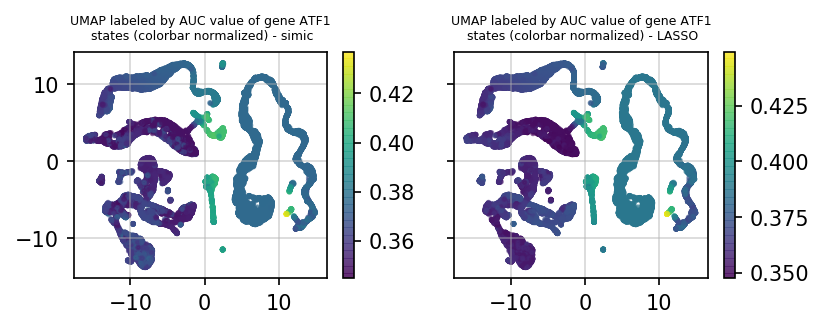

-------
SP1


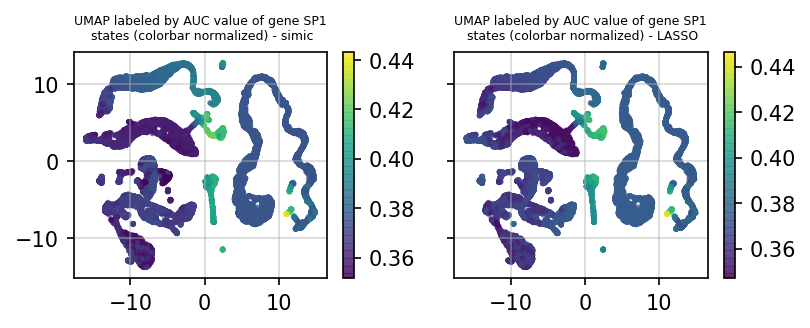

-------
CEBPD


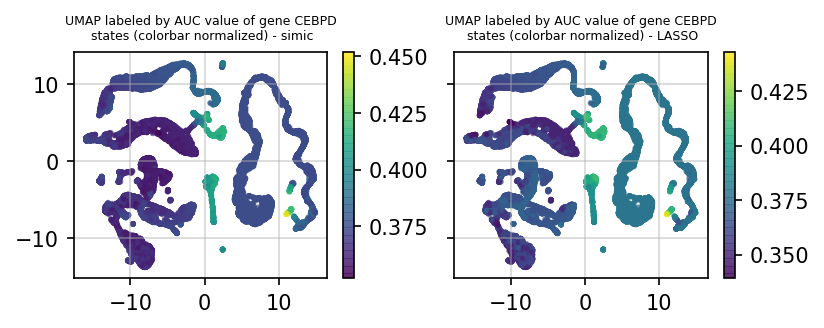

-------
BCL6


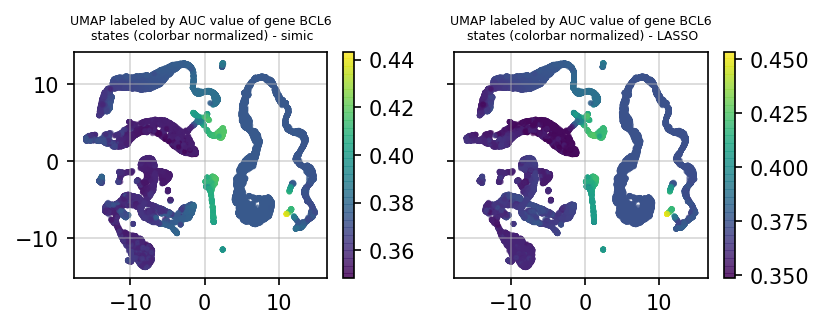

-------
HES1


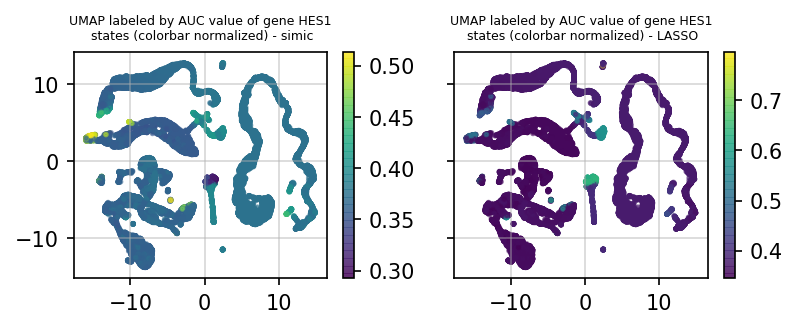

-------
NR1I2


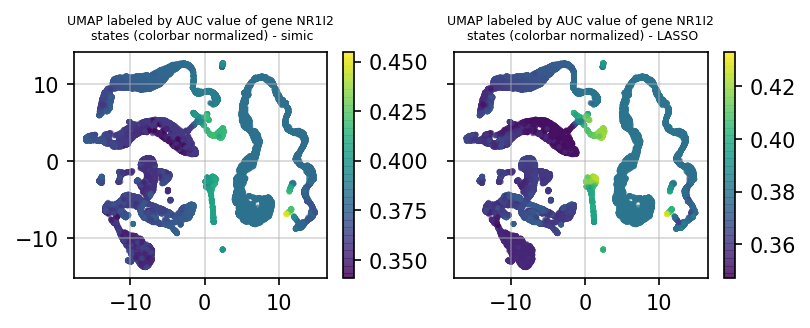

-------
ZBTB20


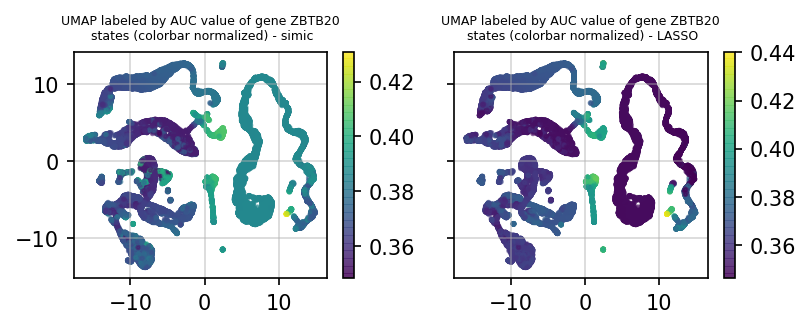

-------
GABPA


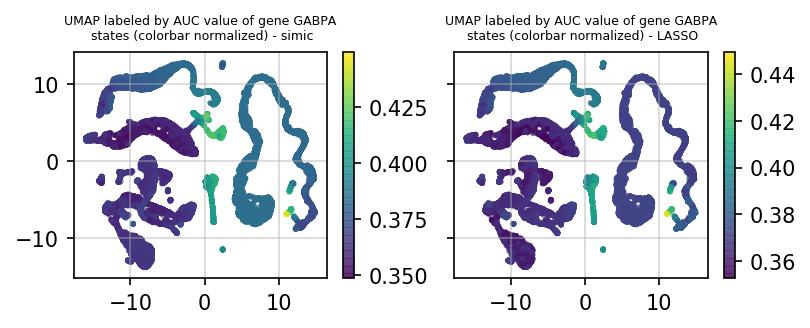

-------
BACH1


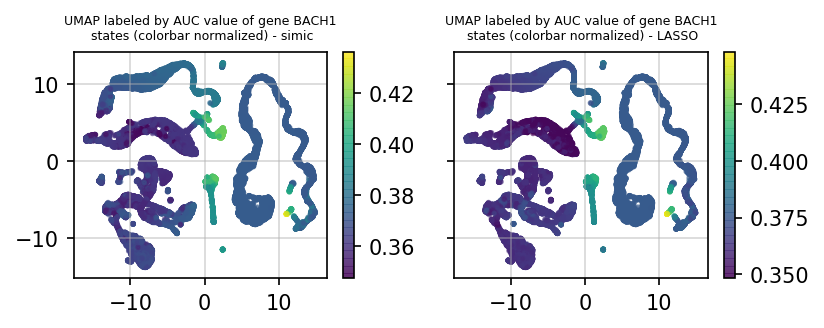

-------
ETS2


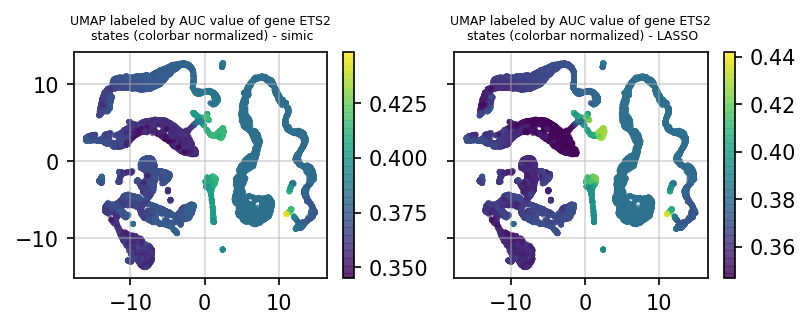

-------
CDC5L


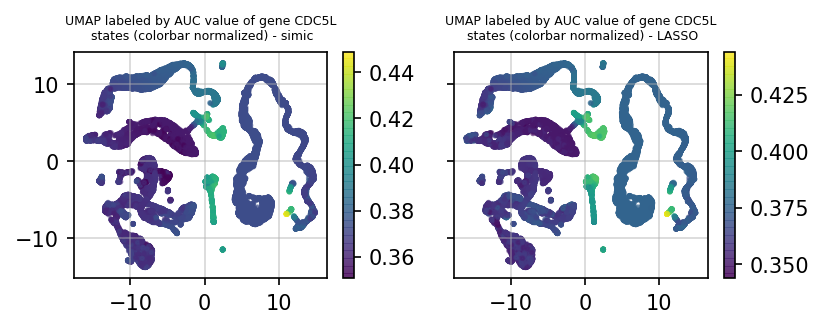

-------
EPAS1


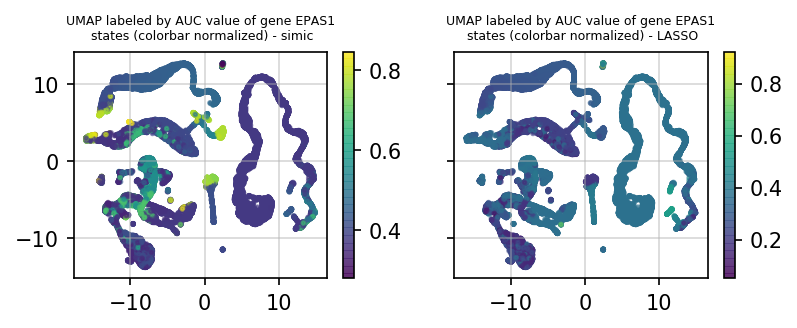

-------
CREM


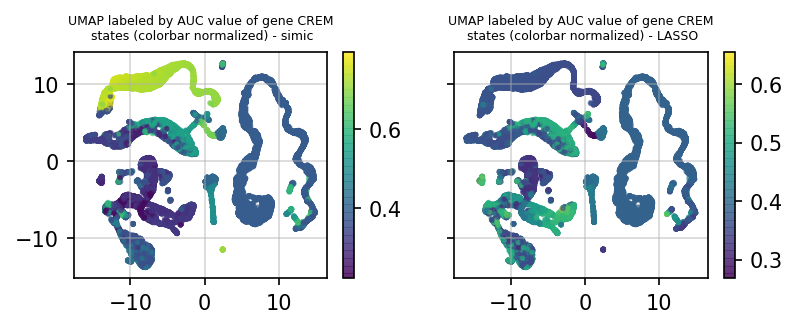

-------
EGR1


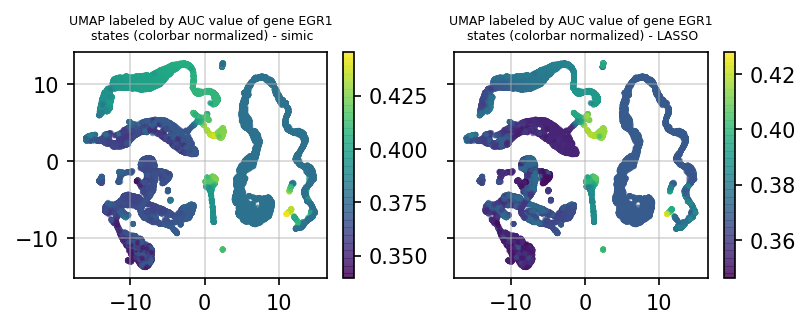

-------
PURA


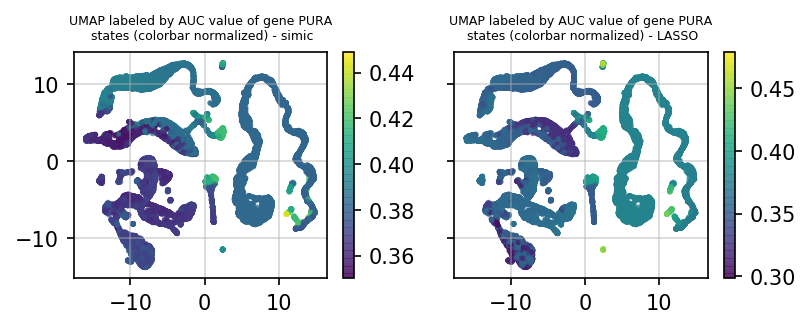

-------
NR3C1


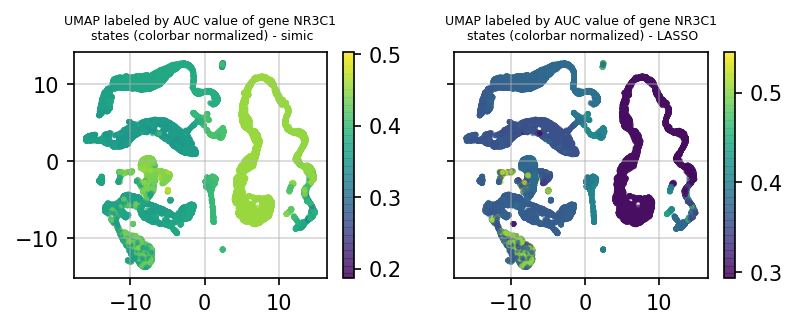

-------
ONECUT2


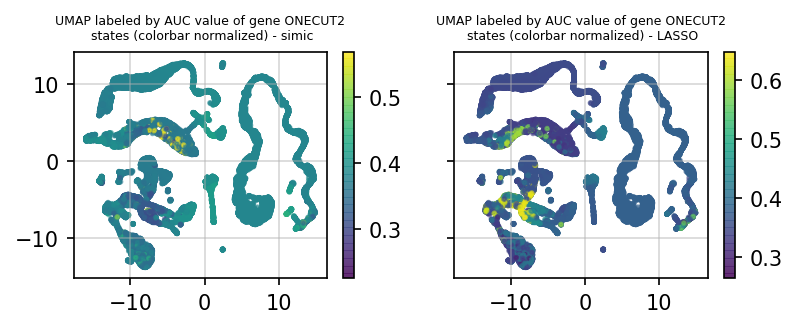

-------
SMAD4


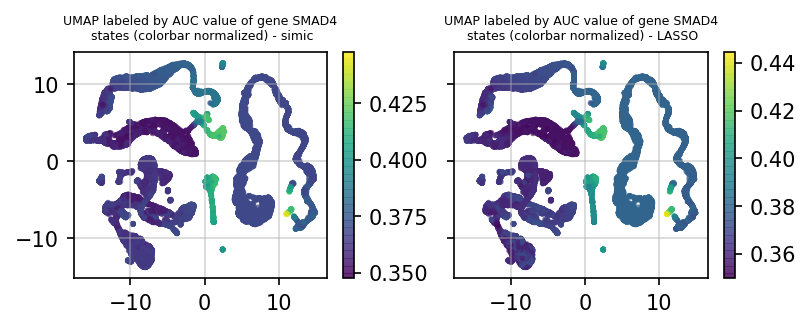

-------
CXXC1


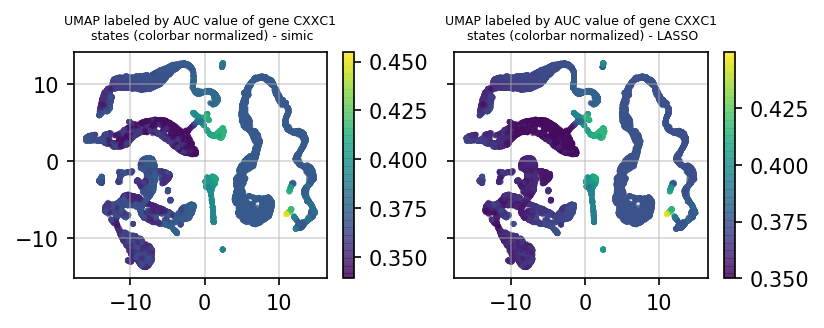

-------
MBD1


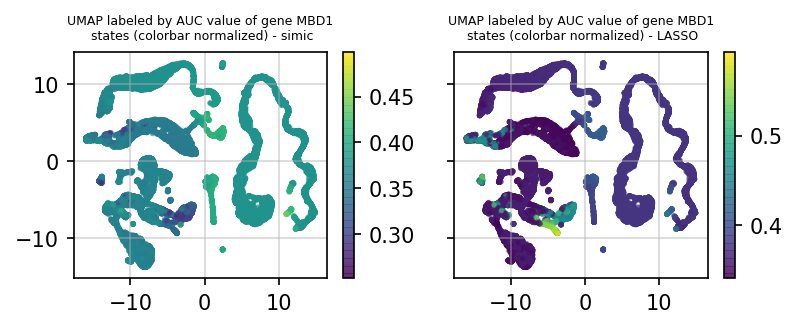

-------
TSHZ1


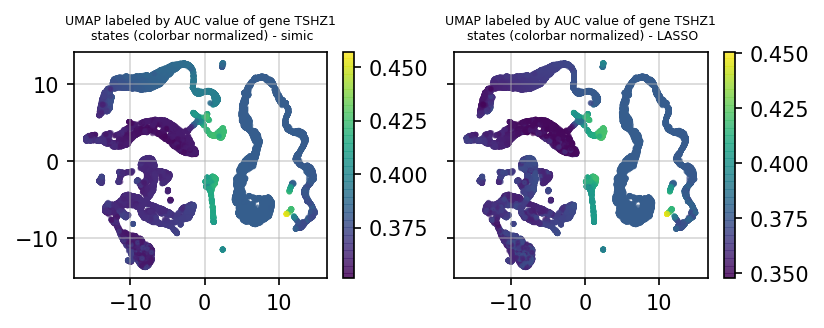

-------
KDM2A


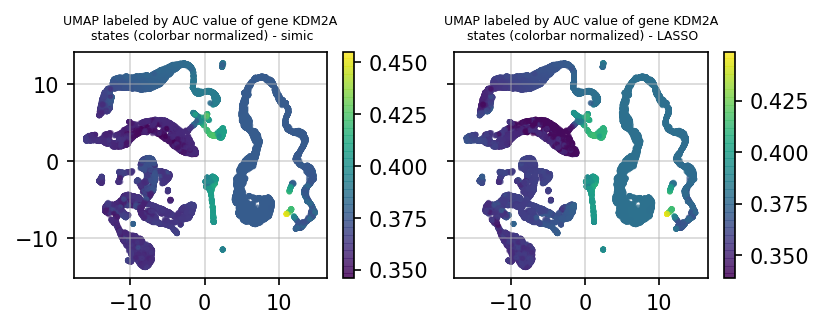

-------
RELA


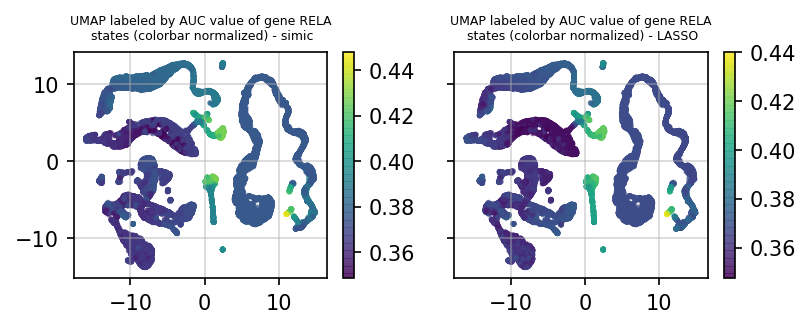

-------
ZFP91


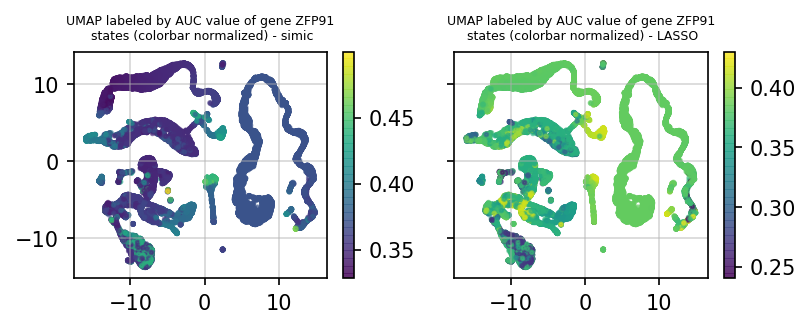

-------
KLF9


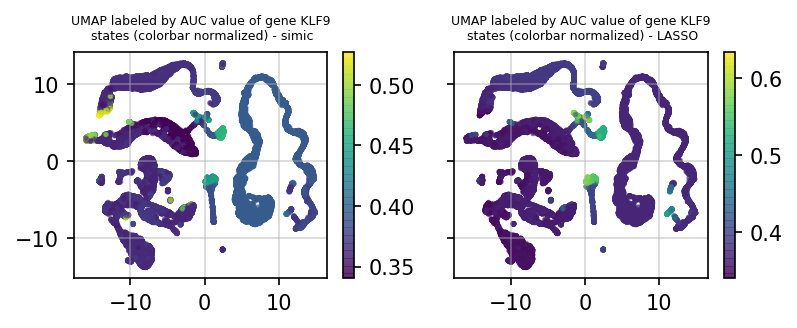

-------
HHEX


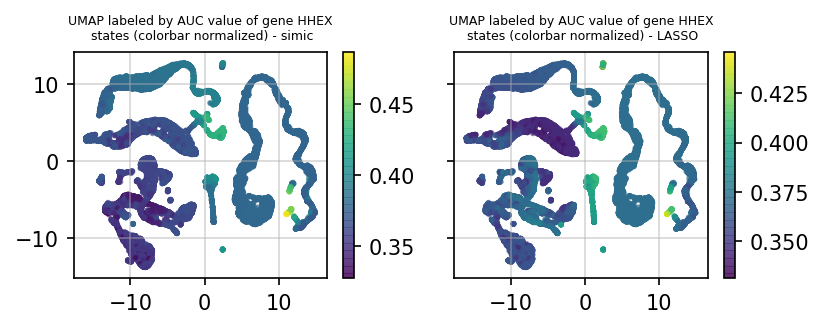

-------
MXI1


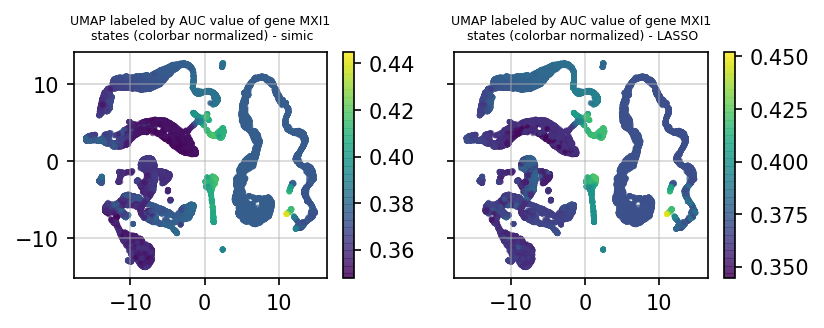

-------
TCF7L2


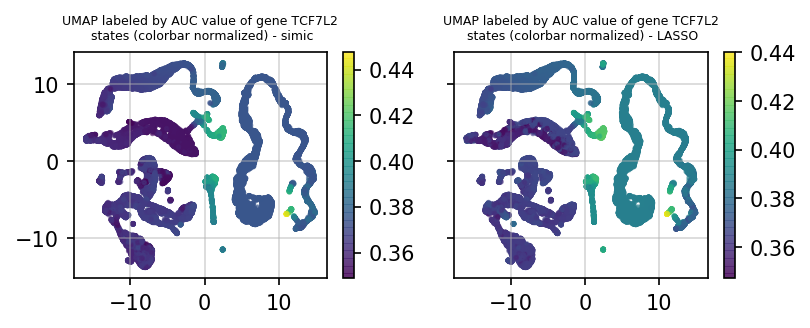

In [70]:
for gene in TF_hist_dict_simic:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'viridis')
    